# Análisis Dataset OhioT1DM

In [1]:
# Instalación de Dependencias
%pip install pandas polars numpy matplotlib lxml
%pip install js.d3 ipywidgets plotly nbformat

Note: you may need to restart the kernel to use updated packages.
Note: you may need to restart the kernel to use updated packages.


In [2]:
import pandas as pd
import polars as pl
import numpy as np
import matplotlib.pyplot as plt
import xml.etree.ElementTree as ET
import glob
import os
import json
from IPython.display import HTML, display, IFrame
import plotly.graph_objects as go
import plotly.express as px
from plotly.subplots import make_subplots
from plotly.io import to_html
from datetime import datetime
from matplotlib.dates import DateFormatter


## Carga y Procesamiento de Datos

In [3]:
def parse_patient_xml(file_path):
    """Parse an XML file and extract patient data."""
    tree = ET.parse(file_path)
    root = tree.getroot()
    
    # Extract patient metadata
    patient_id = root.get('id')
    weight = root.get('weight')
    insulin_type = root.get('insulin_type')
    
    # Define features to extract
    features = ['glucose_level', 'finger_stick', 'basal', 'temp_basal', 'bolus', 'meal', 
                'sleep', 'work', 'stressors', 'hypo_event', 'illness', 'exercise', 
                'basis_heart_rate', 'basis_gsr', 'basis_skin_temperature', 'basis_sleep', 
                'acceleration']
    
    # Dictionary to store dataframes for each feature
    feature_dfs = {}
    
    # Extract data for each feature
    for feature in features:
        feature_data = []
        feature_element = root.find(feature)
        if feature_element is not None:
            for event in feature_element.findall('event'):
                # Extract all attributes from this event
                event_data = {k: v for k, v in event.attrib.items()}
                # Add patient_id
                event_data['patient_id'] = patient_id
                feature_data.append(event_data)
        
        # Create a dataframe if we have data
        if feature_data:
            df = pl.DataFrame(feature_data)
            
            # Convert timestamp columns to datetime if they exist
            timestamp_cols = [col for col in df.columns if 'ts' in col]
            for col in timestamp_cols:
                df = df.with_columns(
                    pl.col(col).str.strptime(
                        pl.Datetime, 
                        format="%d-%m-%Y %H:%M:%S",
                        strict=False
                    )
                )
            
            # Convert numeric columns
            numeric_cols = ['value', 'dose', 'carbs', 'duration']
            for col in [c for c in numeric_cols if c in df.columns]:
                df = df.with_columns(
                    pl.col(col).cast(pl.Float64, strict=False)
                )
                
            feature_dfs[feature] = df
        else:
            # Create empty dataframe with patient_id column
            feature_dfs[feature] = pl.DataFrame(schema={
                'patient_id': pl.Utf8
            })
    
    # For glucose_level specifically, rename columns for backward compatibility
    if 'glucose_level' in feature_dfs and 'ts' in feature_dfs['glucose_level'].columns:
        glucose_df = feature_dfs['glucose_level']
        # Create aliased dataframe for backwards compatibility
        feature_dfs['glucose'] = glucose_df.rename({"ts": "timestamp"})
    
    return {
        'patient_info': {'id': patient_id, 'weight': weight, 'insulin_type': insulin_type},
        **feature_dfs
    }

# Load all XML files from the dataset
PROJECT_DIR = os.path.abspath(os.path.join(os.getcwd(), ".."))
base_path1 = os.path.join(PROJECT_DIR, "data", "OhioT1DM", "2020", "train")
base_path2 = os.path.join(PROJECT_DIR, "data", "OhioT1DM", "2018", "train")
patient_data = {}

for xml_file in glob.glob(os.path.join(base_path1, "*.xml")):
    data = parse_patient_xml(xml_file)
    patient_data[data['patient_info']['id']] = data
for xml_file in glob.glob(os.path.join(base_path2, "*.xml")):
    data = parse_patient_xml(xml_file)
    patient_data[data['patient_info']['id']] = data

print(f"Loaded data for {len(patient_data)} patients")

Loaded data for 12 patients


## Glucosa

### Exploración de Datos

Patient IDs: ['584', '567', '544', '552', '540', '596', '575', '563', '591', '559', '570', '588']

Basic glucose statistics for patient 584:
Date range: 2025-05-14 00:03:00 to 2025-06-28 23:56:00
Number of readings: 12150
Glucose statistics (mg/dL):
shape: (9, 2)
┌────────────┬────────────┐
│ statistic  ┆ value      │
│ ---        ┆ ---        │
│ str        ┆ f64        │
╞════════════╪════════════╡
│ count      ┆ 12150.0    │
│ null_count ┆ 0.0        │
│ mean       ┆ 192.484444 │
│ std        ┆ 65.442789  │
│ min        ┆ 40.0       │
│ 25%        ┆ 145.0      │
│ 50%        ┆ 183.0      │
│ 75%        ┆ 230.0      │
│ max        ┆ 400.0      │
└────────────┴────────────┘
Time in range: 47.4%


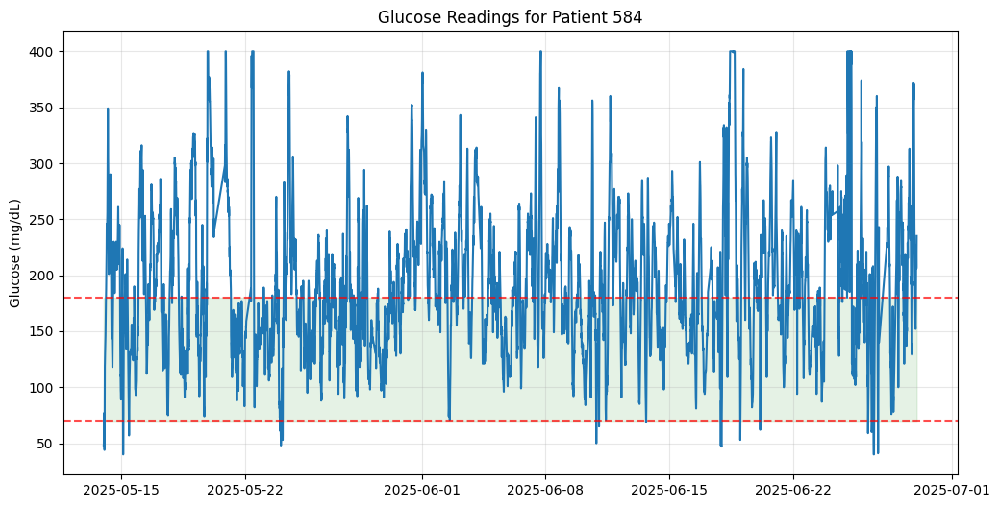


Basic glucose statistics for patient 567:
Date range: 2026-12-28 00:04:30 to 2027-02-12 23:59:21
Number of readings: 10858
Glucose statistics (mg/dL):
shape: (9, 2)
┌────────────┬────────────┐
│ statistic  ┆ value      │
│ ---        ┆ ---        │
│ str        ┆ f64        │
╞════════════╪════════════╡
│ count      ┆ 10858.0    │
│ null_count ┆ 0.0        │
│ mean       ┆ 153.820685 │
│ std        ┆ 60.929583  │
│ min        ┆ 40.0       │
│ 25%        ┆ 108.0      │
│ 50%        ┆ 148.0      │
│ 75%        ┆ 189.0      │
│ max        ┆ 400.0      │
└────────────┴────────────┘
Time in range: 64.0%


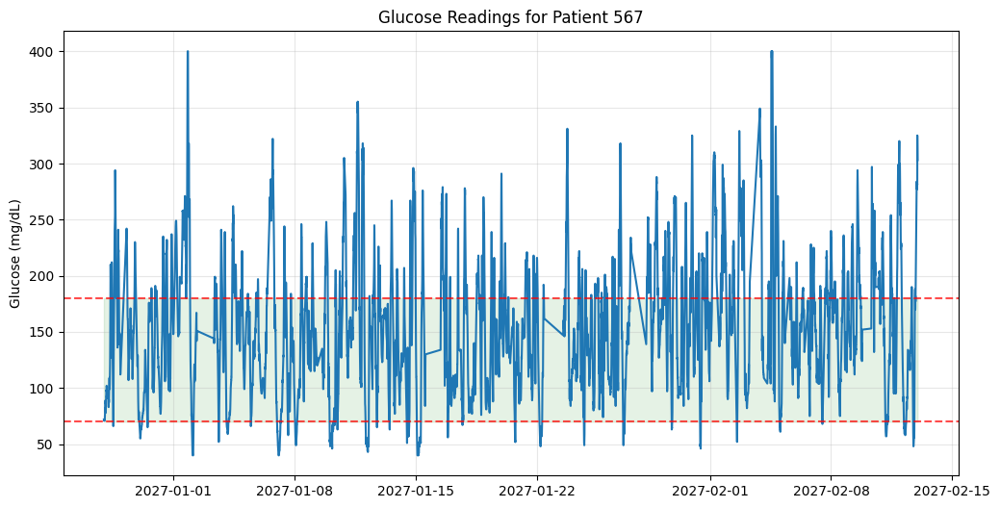


Basic glucose statistics for patient 544:
Date range: 2027-05-11 00:02:00 to 2027-06-23 23:55:00
Number of readings: 10623
Glucose statistics (mg/dL):
shape: (9, 2)
┌────────────┬────────────┐
│ statistic  ┆ value      │
│ ---        ┆ ---        │
│ str        ┆ f64        │
╞════════════╪════════════╡
│ count      ┆ 10623.0    │
│ null_count ┆ 0.0        │
│ mean       ┆ 165.215288 │
│ std        ┆ 59.882266  │
│ min        ┆ 48.0       │
│ 25%        ┆ 120.0      │
│ 50%        ┆ 157.0      │
│ 75%        ┆ 201.0      │
│ max        ┆ 400.0      │
└────────────┴────────────┘
Time in range: 63.8%


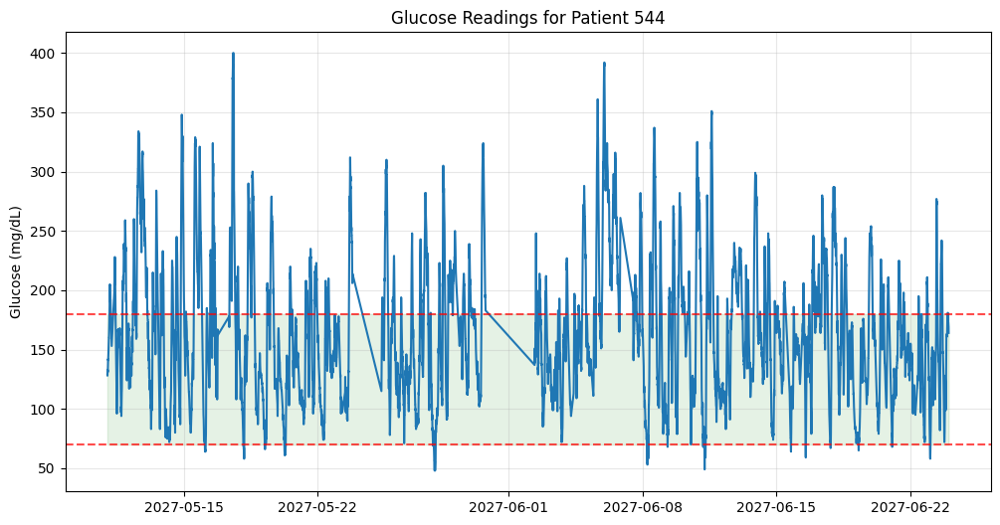


Basic glucose statistics for patient 552:
Date range: 2025-04-16 11:17:05 to 2025-05-24 23:59:14
Number of readings: 9080
Glucose statistics (mg/dL):
shape: (9, 2)
┌────────────┬────────────┐
│ statistic  ┆ value      │
│ ---        ┆ ---        │
│ str        ┆ f64        │
╞════════════╪════════════╡
│ count      ┆ 9080.0     │
│ null_count ┆ 0.0        │
│ mean       ┆ 146.694383 │
│ std        ┆ 54.57926   │
│ min        ┆ 45.0       │
│ 25%        ┆ 106.0      │
│ 50%        ┆ 139.0      │
│ 75%        ┆ 179.0      │
│ max        ┆ 345.0      │
└────────────┴────────────┘
Time in range: 72.3%


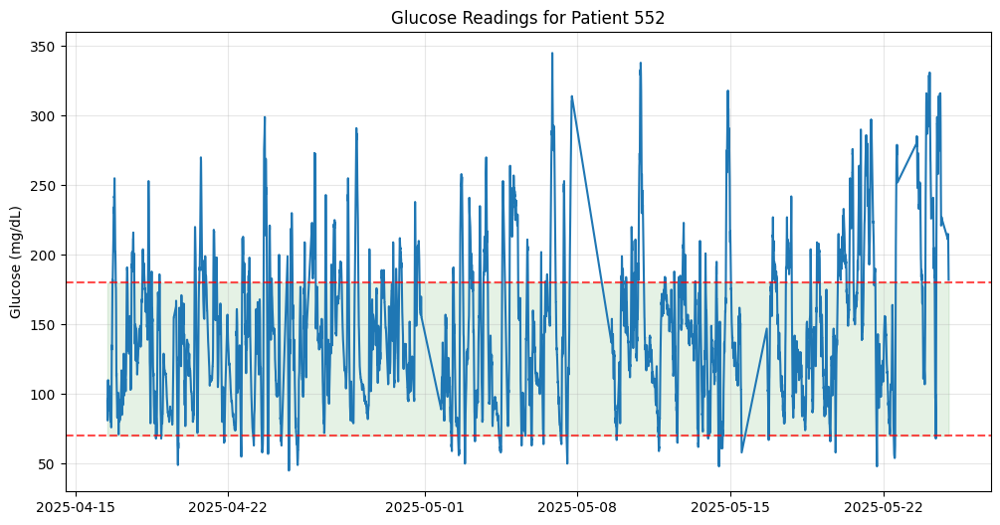


Basic glucose statistics for patient 540:
Date range: 2027-05-19 11:36:29 to 2027-07-03 23:56:44
Number of readings: 11947
Glucose statistics (mg/dL):
shape: (9, 2)
┌────────────┬────────────┐
│ statistic  ┆ value      │
│ ---        ┆ ---        │
│ str        ┆ f64        │
╞════════════╪════════════╡
│ count      ┆ 11947.0    │
│ null_count ┆ 0.0        │
│ mean       ┆ 137.098602 │
│ std        ┆ 55.026251  │
│ min        ┆ 40.0       │
│ 25%        ┆ 94.0       │
│ 50%        ┆ 127.0      │
│ 75%        ┆ 171.0      │
│ max        ┆ 369.0      │
└────────────┴────────────┘
Time in range: 73.2%


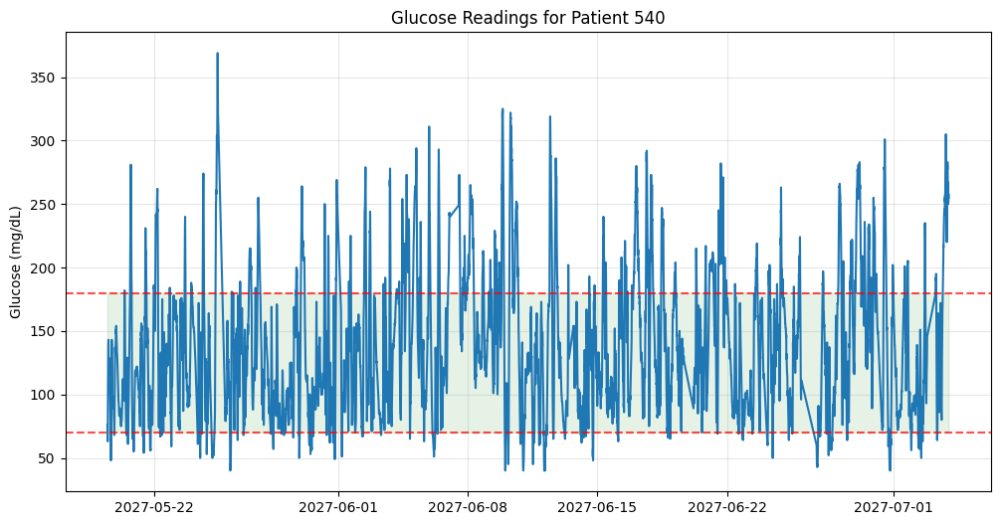


Basic glucose statistics for patient 596:
Date range: 2027-04-09 16:15:00 to 2027-05-26 23:59:00
Number of readings: 10877
Glucose statistics (mg/dL):
shape: (9, 2)
┌────────────┬────────────┐
│ statistic  ┆ value      │
│ ---        ┆ ---        │
│ str        ┆ f64        │
╞════════════╪════════════╡
│ count      ┆ 10877.0    │
│ null_count ┆ 0.0        │
│ mean       ┆ 147.194355 │
│ std        ┆ 49.297883  │
│ min        ┆ 40.0       │
│ 25%        ┆ 109.0      │
│ 50%        ┆ 140.0      │
│ 75%        ┆ 178.0      │
│ max        ┆ 367.0      │
└────────────┴────────────┘
Time in range: 74.2%


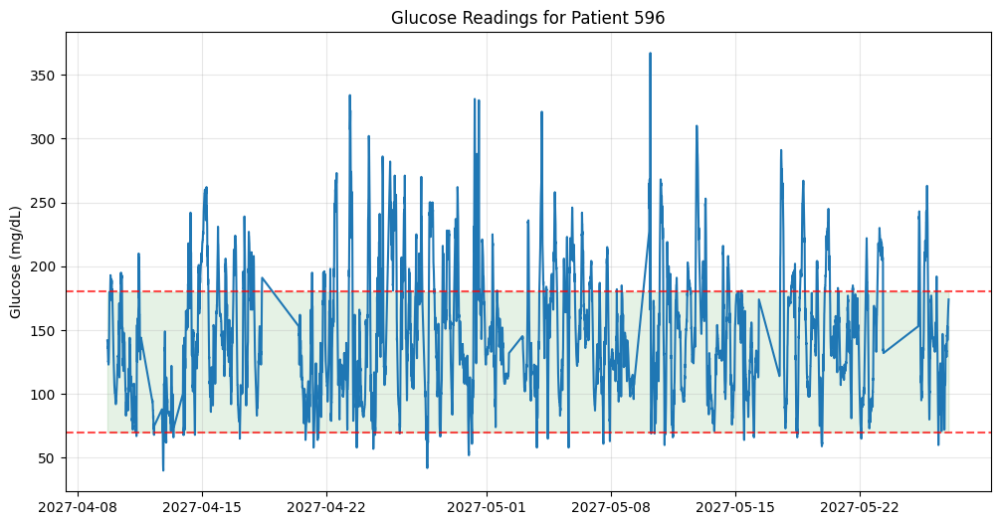


Basic glucose statistics for patient 575:
Date range: 2021-11-17 12:04:00 to 2022-01-01 23:55:00
Number of readings: 11866
Glucose statistics (mg/dL):
shape: (9, 2)
┌────────────┬───────────┐
│ statistic  ┆ value     │
│ ---        ┆ ---       │
│ str        ┆ f64       │
╞════════════╪═══════════╡
│ count      ┆ 11866.0   │
│ null_count ┆ 0.0       │
│ mean       ┆ 141.77347 │
│ std        ┆ 60.267819 │
│ min        ┆ 40.0      │
│ 25%        ┆ 98.0      │
│ 50%        ┆ 132.0     │
│ 75%        ┆ 174.0     │
│ max        ┆ 400.0     │
└────────────┴───────────┘
Time in range: 69.2%


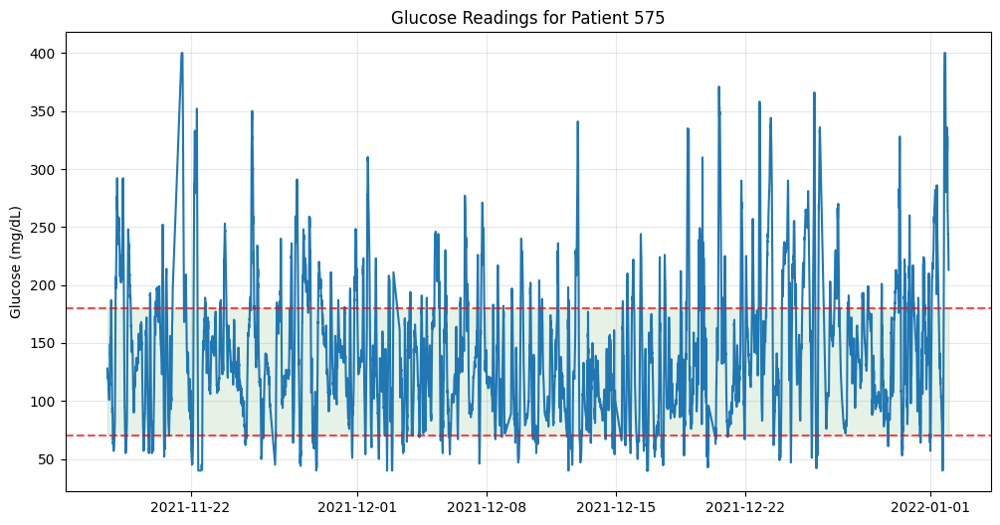


Basic glucose statistics for patient 563:
Date range: 2021-09-13 12:33:00 to 2021-10-28 23:56:00
Number of readings: 12124
Glucose statistics (mg/dL):
shape: (9, 2)
┌────────────┬───────────┐
│ statistic  ┆ value     │
│ ---        ┆ ---       │
│ str        ┆ f64       │
╞════════════╪═══════════╡
│ count      ┆ 12124.0   │
│ null_count ┆ 0.0       │
│ mean       ┆ 146.07712 │
│ std        ┆ 49.68904  │
│ min        ┆ 40.0      │
│ 25%        ┆ 108.0     │
│ 50%        ┆ 140.0     │
│ 75%        ┆ 177.0     │
│ max        ┆ 400.0     │
└────────────┴───────────┘
Time in range: 74.2%


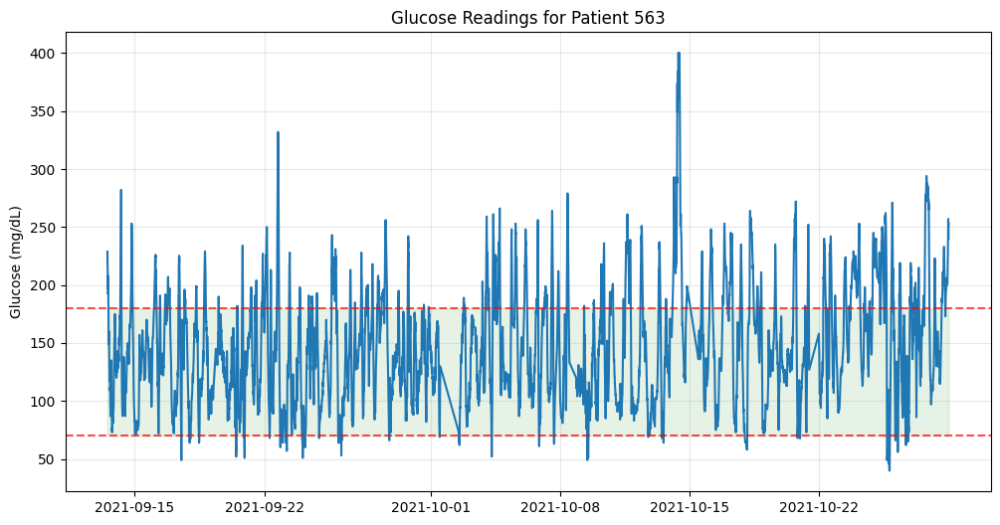


Basic glucose statistics for patient 591:
Date range: 2021-11-30 17:06:00 to 2022-01-13 23:58:00
Number of readings: 10847
Glucose statistics (mg/dL):
shape: (9, 2)
┌────────────┬────────────┐
│ statistic  ┆ value      │
│ ---        ┆ ---        │
│ str        ┆ f64        │
╞════════════╪════════════╡
│ count      ┆ 10847.0    │
│ null_count ┆ 0.0        │
│ mean       ┆ 156.022034 │
│ std        ┆ 58.042463  │
│ min        ┆ 40.0       │
│ 25%        ┆ 111.0      │
│ 50%        ┆ 149.0      │
│ 75%        ┆ 195.0      │
│ max        ┆ 397.0      │
└────────────┴────────────┘
Time in range: 64.2%


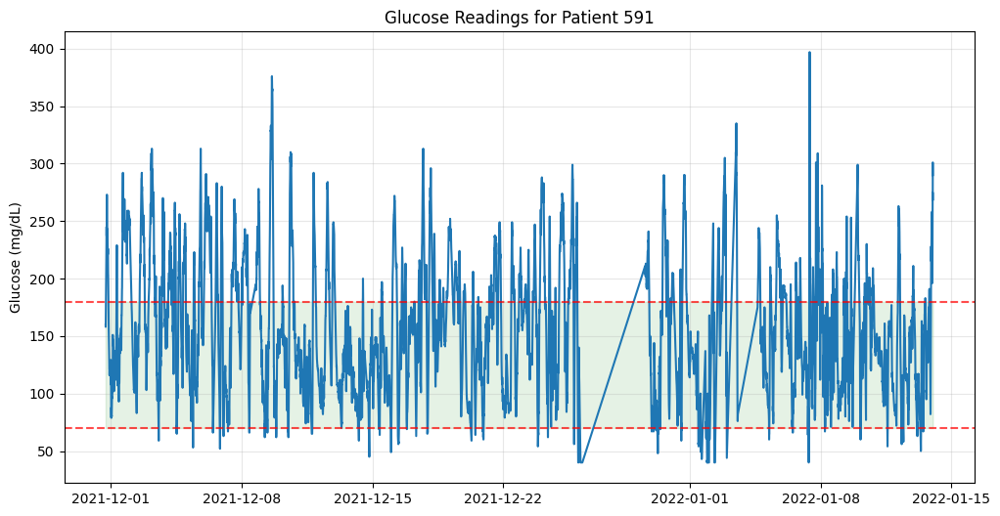


Basic glucose statistics for patient 559:
Date range: 2021-12-07 01:17:00 to 2022-01-17 23:56:00
Number of readings: 10796
Glucose statistics (mg/dL):
shape: (9, 2)
┌────────────┬────────────┐
│ statistic  ┆ value      │
│ ---        ┆ ---        │
│ str        ┆ f64        │
╞════════════╪════════════╡
│ count      ┆ 10796.0    │
│ null_count ┆ 0.0        │
│ mean       ┆ 166.692293 │
│ std        ┆ 70.577174  │
│ min        ┆ 40.0       │
│ 25%        ┆ 108.0      │
│ 50%        ┆ 157.0      │
│ 75%        ┆ 212.0      │
│ max        ┆ 400.0      │
└────────────┴────────────┘
Time in range: 56.2%


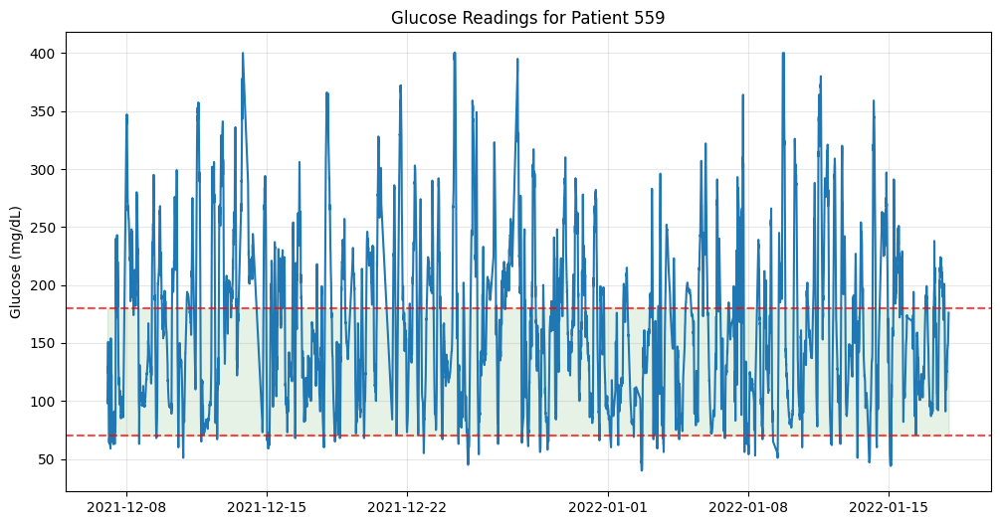


Basic glucose statistics for patient 570:
Date range: 2021-12-07 16:29:00 to 2022-01-16 23:59:00
Number of readings: 10982
Glucose statistics (mg/dL):
shape: (9, 2)
┌────────────┬────────────┐
│ statistic  ┆ value      │
│ ---        ┆ ---        │
│ str        ┆ f64        │
╞════════════╪════════════╡
│ count      ┆ 10982.0    │
│ null_count ┆ 0.0        │
│ mean       ┆ 187.492989 │
│ std        ┆ 62.328928  │
│ min        ┆ 46.0       │
│ 25%        ┆ 142.0      │
│ 50%        ┆ 189.0      │
│ 75%        ┆ 232.0      │
│ max        ┆ 377.0      │
└────────────┴────────────┘
Time in range: 43.2%


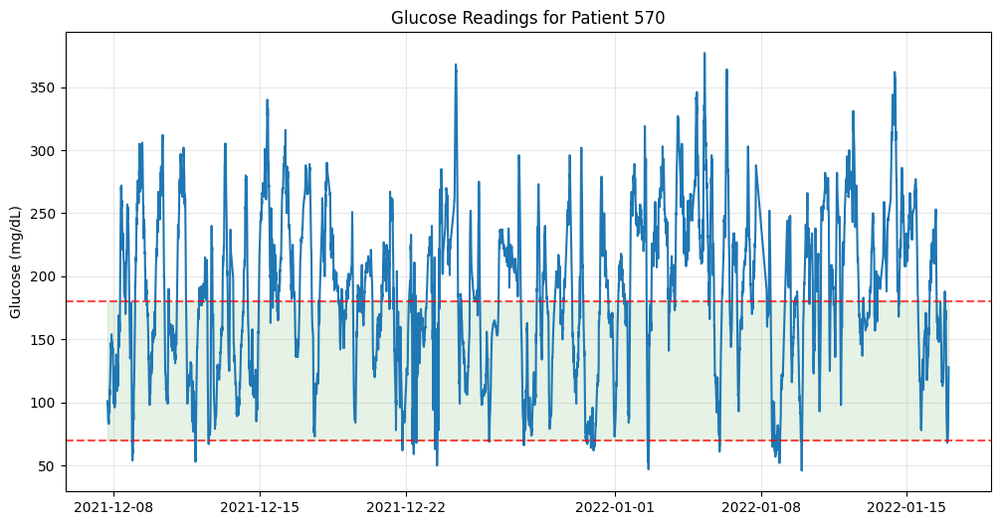


Basic glucose statistics for patient 588:
Date range: 2021-08-30 11:53:00 to 2021-10-14 23:55:00
Number of readings: 12640
Glucose statistics (mg/dL):
shape: (9, 2)
┌────────────┬────────────┐
│ statistic  ┆ value      │
│ ---        ┆ ---        │
│ str        ┆ f64        │
╞════════════╪════════════╡
│ count      ┆ 12640.0    │
│ null_count ┆ 0.0        │
│ mean       ┆ 164.988291 │
│ std        ┆ 50.510063  │
│ min        ┆ 40.0       │
│ 25%        ┆ 128.0      │
│ 50%        ┆ 161.0      │
│ 75%        ┆ 200.0      │
│ max        ┆ 400.0      │
└────────────┴────────────┘
Time in range: 63.7%


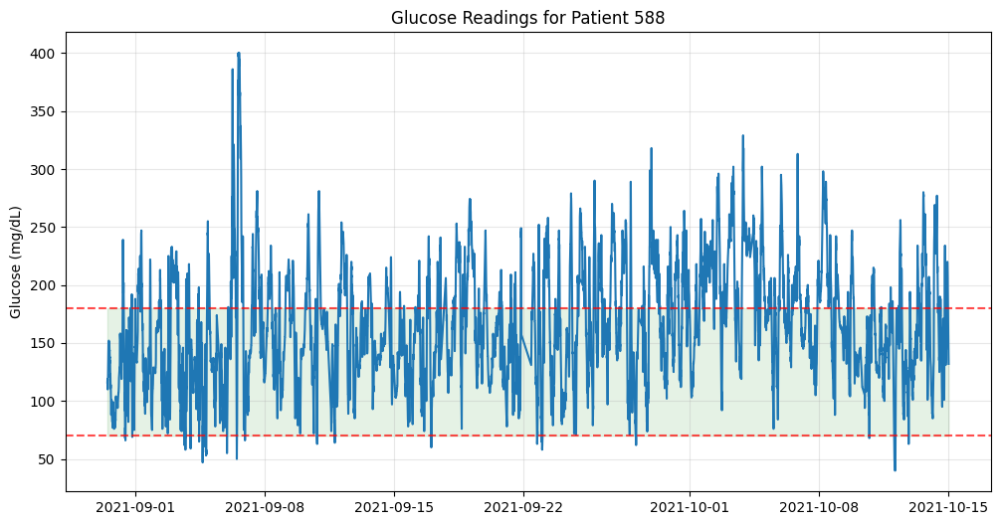

In [4]:
patient_ids = list(patient_data.keys())
print(f"Patient IDs: {patient_ids}")

for patient_id in patient_ids:
    glucose_df = patient_data[patient_id]['glucose']

    print(f"\nBasic glucose statistics for patient {patient_id}:")
    print(f"Date range: {glucose_df['timestamp'].min()} to {glucose_df['timestamp'].max()}")
    print(f"Number of readings: {len(glucose_df)}")
    print(f"Glucose statistics (mg/dL):")
    print(glucose_df['value'].describe())

    # Calculate time in range (70-180 mg/dL is standard range for diabetes management)
    in_range = ((glucose_df['value'] >= 70) & (glucose_df['value'] <= 180)).mean() * 100
    print(f"Time in range: {in_range:.1f}%")

    # Plot basic glucose trend
    plt.figure(figsize=(12, 6))
    plt.plot(glucose_df['timestamp'], glucose_df['value'])
    plt.axhline(y=180, color='r', linestyle='--', alpha=0.7)
    plt.axhline(y=70, color='r', linestyle='--', alpha=0.7)
    plt.fill_between(glucose_df['timestamp'], 70, 180, alpha=0.1, color='green')
    plt.title(f'Glucose Readings for Patient {patient_id}')
    plt.ylabel('Glucose (mg/dL)')
    plt.grid(True, alpha=0.3)
    plt.show()

### Visualización de Datos de Glucosa por paciente

In [5]:
def create_d3_glucose_chart(patient_id, glucose_df):
    """Create an interactive D3.js visualization of glucose data."""
    
    # Convert datetime to string format that D3 can parse
    df_for_json = glucose_df.clone()
    df_for_json = df_for_json.with_columns(
        pl.col('timestamp').cast(pl.Utf8)
    )
    
    # Convert to JSON for D3
    glucose_json = json.dumps(df_for_json.to_dicts())
    
    # D3.js code for interactive visualization
    d3_code = f"""
    <html>
        <head>
            <script src="https://d3js.org/d3.v7.min.js"></script>
        </head>
        <body>
            <div id="chart-container-{patient_id}" style="width:100%; height:500px;"></div>
            
            <script>
            (function() {{
                // Parse the data
                const data = {glucose_json};
                data.forEach(d => {{
                    d.timestamp = new Date(d.timestamp);
                    d.value = +d.value;
                }});
                
                // Set dimensions and margins
                const margin = {{top: 50, right: 50, bottom: 50, left: 60}};
                const width = 900 - margin.left - margin.right;
                const height = 450 - margin.top - margin.bottom;
                
                // Append SVG to the container
                const svg = d3.select("#chart-container-{patient_id}")
                    .append("svg")
                    .attr("width", width + margin.left + margin.right)
                    .attr("height", height + margin.top + margin.bottom)
                    .append("g")
                    .attr("transform", `translate(${{margin.left}},${{margin.top}})`);
                
                // Set up scales
                const x = d3.scaleTime()
                    .domain(d3.extent(data, d => d.timestamp))
                    .range([0, width]);
                    
                const y = d3.scaleLinear()
                    .domain([0, d3.max(data, d => d.value) * 1.1])
                    .range([height, 0]);
                    
                // Create axes
                const xAxis = svg.append("g")
                    .attr("transform", `translate(0,${{height}}`)
                    .call(d3.axisBottom(x));
                    
                const yAxis = svg.append("g")
                    .call(d3.axisLeft(y));
                    
                // Add title
                svg.append("text")
                    .attr("x", width / 2)
                    .attr("y", -20)
                    .attr("text-anchor", "middle")
                    .attr("font-size", "16px")
                    .attr("font-weight", "bold")
                    .text("Glucose Readings for Patient {patient_id}");
                    
                // Add target range (70-180 mg/dL)
                svg.append("rect")
                    .attr("x", 0)
                    .attr("y", y(180))
                    .attr("width", width)
                    .attr("height", y(70) - y(180))
                    .attr("fill", "green")
                    .attr("opacity", 0.2);
                    
                // Add horizontal lines for range boundaries
                svg.append("line")
                    .attr("x1", 0)
                    .attr("x2", width)
                    .attr("y1", y(70))
                    .attr("y2", y(70))
                    .attr("stroke", "red")
                    .attr("stroke-width", 1)
                    .attr("stroke-dasharray", "5,5");
                    
                svg.append("line")
                    .attr("x1", 0)
                    .attr("x2", width)
                    .attr("y1", y(180))
                    .attr("y2", y(180))
                    .attr("stroke", "red")
                    .attr("stroke-width", 1)
                    .attr("stroke-dasharray", "5,5");
                    
                // Add labels for target range
                svg.append("text")
                    .attr("x", width + 5)
                    .attr("y", y(180))
                    .attr("dy", "0.35em")
                    .attr("font-size", "10px")
                    .text("180 mg/dL");
                    
                svg.append("text")
                    .attr("x", width + 5)
                    .attr("y", y(70))
                    .attr("dy", "0.35em")
                    .attr("font-size", "10px")
                    .text("70 mg/dL");
                    
                // Create line generator
                const line = d3.line()
                    .x(d => x(d.timestamp))
                    .y(d => y(d.value));
                    
                // Add path
                svg.append("path")
                    .datum(data)
                    .attr("fill", "none")
                    .attr("stroke", "steelblue")
                    .attr("stroke-width", 1.5)
                    .attr("d", line);
                    
                // Add tooltip functionality
                const tooltip = d3.select("#chart-container-{patient_id}")
                    .append("div")
                    .attr("class", "tooltip")
                    .style("position", "absolute")
                    .style("background-color", "white")
                    .style("border", "1px solid #ddd")
                    .style("border-radius", "3px")
                    .style("padding", "8px")
                    .style("pointer-events", "none")
                    .style("opacity", 0);
                    
                // Add dots with tooltip interactions
                svg.selectAll(".dot")
                    .data(data)
                    .enter()
                    .append("circle")
                    .attr("class", "dot")
                    .attr("cx", d => x(d.timestamp))
                    .attr("cy", d => y(d.value))
                    .attr("r", 3)
                    .attr("fill", d => {{
                        if (d.value > 180) return "orange";
                        else if (d.value < 70) return "red";
                        else return "green";
                    }})
                    .on("mouseover", function(event, d) {{
                        d3.select(this)
                            .transition()
                            .duration(100)
                            .attr("r", 5);
                            
                        tooltip.transition()
                            .duration(100)
                            .style("opacity", 0.9);
                            
                        tooltip.html(`Time: ${{d.timestamp.toLocaleString()}}<br>Glucose: ${{d.value}} mg/dL`)
                            .style("left", (event.pageX + 10) + "px")
                            .style("top", (event.pageY - 20) + "px");
                    }})
                    .on("mouseout", function() {{
                        d3.select(this)
                            .transition()
                            .duration(100)
                            .attr("r", 3);
                            
                        tooltip.transition()
                            .duration(200)
                            .style("opacity", 0);
                    }});
                    
                // Add zoom capability
                const zoom = d3.zoom()
                    .scaleExtent([1, 20])
                    .extent([[0, 0], [width, height]])
                    .on("zoom", zoomed);
                    
                svg.append("rect")
                    .attr("width", width)
                    .attr("height", height)
                    .style("fill", "none")
                    .style("pointer-events", "all")
                    .call(zoom);
                    
                function zoomed(event) {{
                    // Create new scale
                    const newX = event.transform.rescaleX(x);
                    
                    // Update axes
                    xAxis.call(d3.axisBottom(newX));
                    
                    // Update line
                    svg.select("path")
                        .attr("d", d3.line()
                            .x(d => newX(d.timestamp))
                            .y(d => y(d.value))
                        );
                        
                    // Update dots
                    svg.selectAll(".dot")
                        .attr("cx", d => newX(d.timestamp));
                }}
            }})();
            </script>
        </body>
    </html>
    """
    
    return HTML(d3_code)

# Display the D3 chart for the first patient
# display(create_d3_glucose_chart(patient_id, glucose_df))

In [6]:
def create_plotly_glucose_chart(patient_id, glucose_df):
    """Create an interactive Plotly visualization of glucose data."""
    
    # Convert to lists for plotting
    timestamps = glucose_df['timestamp'].to_list()
    values = glucose_df['value'].to_list()
    
    # Create figure
    fig = go.Figure()
    
    # Add target range as a colored area
    fig.add_hrect(y0=70, y1=180, fillcolor="green", opacity=0.1, line_width=0)
    
    # Add glucose line
    fig.add_trace(go.Scatter(
        x=timestamps, 
        y=values,
        mode='lines',
        name='Glucose',
        line=dict(color='steelblue', width=1.5)
    ))
    
    # Add reference lines for target range
    fig.add_hline(y=70, line_dash="dash", line_color="red", opacity=0.7)
    fig.add_hline(y=180, line_dash="dash", line_color="red", opacity=0.7)
    
    # Update layout
    fig.update_layout(
        title=f"Glucose Readings for Patient {patient_id}",
        xaxis_title="Time",
        yaxis_title="Glucose (mg/dL)",
        height=500,
        template="plotly_white",
        hovermode="closest"
    )
    
    return fig

In [7]:
# Display the Plotly chart
for patient in patient_ids:
    glucose_df = patient_data[patient]['glucose']
    if len(glucose_df) > 0:
        # Display the Plotly chart for each patient
        fig = create_plotly_glucose_chart(patient, glucose_df)
        fig.show()
        # display(create_d3_glucose_chart(patient, glucose_df))
    else:
        print(f"No glucose data available for patient {patient}")

### Dashboard

In [8]:
def create_d3_dashboard(patient_id, glucose_df):
    """Create a comprehensive D3.js dashboard for patient data analysis."""
    
    # Preprocess data for JSON
    df_for_json = glucose_df.clone()
    df_for_json = df_for_json.with_columns(
        pl.col('timestamp').cast(pl.Utf8)
    )
    glucose_json = json.dumps(df_for_json.to_dicts())
    
    d3_code = f"""
    <div id="dashboard-{patient_id}" style="font-family: Arial, sans-serif;">
        <h2 style="text-align: center;">Patient {patient_id} Glucose Analysis Dashboard</h2>
        
        <div style="display: flex; justify-content: space-between; margin-bottom: 20px;">
            <div id="metric-avg-{patient_id}" style="background: #f5f5f5; padding: 15px; border-radius: 5px; width: 30%; box-shadow: 0 2px 4px rgba(0,0,0,0.1);"></div>
            <div id="metric-range-{patient_id}" style="background: #f5f5f5; padding: 15px; border-radius: 5px; width: 30%; box-shadow: 0 2px 4px rgba(0,0,0,0.1);"></div>
            <div id="metric-var-{patient_id}" style="background: #f5f5f5; padding: 15px; border-radius: 5px; width: 30%; box-shadow: 0 2px 4px rgba(0,0,0,0.1);"></div>
        </div>
        
        <div style="margin-bottom: 20px;">
            <div id="time-series-{patient_id}" style="background: #f9f9f9; padding: 15px; border-radius: 5px; box-shadow: 0 2px 4px rgba(0,0,0,0.1);"></div>
        </div>
        
        <div style="display: flex; justify-content: space-between;">
            <div id="daily-pattern-{patient_id}" style="background: #f9f9f9; padding: 15px; border-radius: 5px; width: 48%; box-shadow: 0 2px 4px rgba(0,0,0,0.1);"></div>
            <div id="distribution-{patient_id}" style="background: #f9f9f9; padding: 15px; border-radius: 5px; width: 48%; box-shadow: 0 2px 4px rgba(0,0,0,0.1);"></div>
        </div>
    </div>
    
    <script src="https://d3js.org/d3.v7.min.js"></script>
    <script>
    (function() {{
        // Parse the data
        const data = {glucose_json};
        data.forEach(d => {{
            d.timestamp = new Date(d.timestamp);
            d.value = +d.value;
            d.hour = d.timestamp.getHours();
            d.day = d.timestamp.getDay();
        }});
        
        // Calculate metrics
        const avgGlucose = d3.mean(data, d => d.value).toFixed(1);
        const timeInRange = (data.filter(d => d.value >= 70 && d.value <= 180).length / data.length * 100).toFixed(1);
        const glucoseVar = d3.deviation(data, d => d.value).toFixed(1);
        
        // Display metrics
        d3.select("#metric-avg-{patient_id}")
            .html(`<h3 style="margin-top:0;text-align:center;">Average Glucose</h3>
                   <p style="text-align:center;font-size:24px;font-weight:bold;margin:0;">${{avgGlucose}}<span style="font-size:16px;font-weight:normal;"> mg/dL</span></p>`);
                   
        d3.select("#metric-range-{patient_id}")
            .html(`<h3 style="margin-top:0;text-align:center;">Time in Range</h3>
                   <p style="text-align:center;font-size:24px;font-weight:bold;margin:0;">${{timeInRange}}<span style="font-size:16px;font-weight:normal;"> %</span></p>`);
                   
        d3.select("#metric-var-{patient_id}")
            .html(`<h3 style="margin-top:0;text-align:center;">Glucose Variability</h3>
                   <p style="text-align:center;font-size:24px;font-weight:bold;margin:0;">${{glucoseVar}}<span style="font-size:16px;font-weight:normal;"> mg/dL</span></p>`);
                   
        // Create time series visualization
        createTimeSeries();
        
        // Create daily pattern visualization
        createDailyPattern();
        
        // Create distribution visualization
        createDistribution();
        
        function createTimeSeries() {{
            const margin = {{top: 30, right: 50, bottom: 40, left: 50}};
            const width = 900 - margin.left - margin.right;
            const height = 300 - margin.top - margin.bottom;
            
            const svg = d3.select("#time-series-{patient_id}")
                .append("svg")
                .attr("width", width + margin.left + margin.right)
                .attr("height", height + margin.top + margin.bottom)
                .append("g")
                .attr("transform", `translate(${{margin.left}},${{margin.top}})`);
                
            svg.append("text")
                .attr("x", width / 2)
                .attr("y", -10)
                .attr("text-anchor", "middle")
                .text("Glucose Readings Over Time");
                
            // Set up scales
            const x = d3.scaleTime()
                .domain(d3.extent(data, d => d.timestamp))
                .range([0, width]);
                
            const y = d3.scaleLinear()
                .domain([0, d3.max(data, d => d.value) * 1.1])
                .range([height, 0]);
                
            // Add target range
            svg.append("rect")
                .attr("x", 0)
                .attr("y", y(180))
                .attr("width", width)
                .attr("height", y(70) - y(180))
                .attr("fill", "green")
                .attr("opacity", 0.2);
                
            // Add axes
            svg.append("g")
                .attr("transform", `translate(0,${{height}}`)
                .call(d3.axisBottom(x));
                
            svg.append("g")
                .call(d3.axisLeft(y));
                
            // Add range lines
            svg.append("line")
                .attr("x1", 0)
                .attr("x2", width)
                .attr("y1", y(70))
                .attr("y2", y(70))
                .attr("stroke", "red")
                .attr("stroke-dasharray", "3,3")
                .attr("stroke-width", 1);
                
            svg.append("line")
                .attr("x1", 0)
                .attr("x2", width)
                .attr("y1", y(180))
                .attr("y2", y(180))
                .attr("stroke", "red")
                .attr("stroke-dasharray", "3,3")
                .attr("stroke-width", 1);
                
            // Add the line
            svg.append("path")
                .datum(data)
                .attr("fill", "none")
                .attr("stroke", "steelblue")
                .attr("stroke-width", 1.5)
                .attr("d", d3.line()
                    .x(d => x(d.timestamp))
                    .y(d => y(d.value))
                );
        }}
        
        function createDailyPattern() {{
            // Group data by hour
            let hourlyData = [];
            for (let i = 0; i < 24; i++) {{
                const hourData = data.filter(d => d.hour === i);
                if (hourData.length > 0) {{
                    hourlyData.push({{
                        hour: i,
                        mean: d3.mean(hourData, d => d.value),
                        min: d3.min(hourData, d => d.value),
                        max: d3.max(hourData, d => d.value)
                    }});
                }}
            }}
            
            const margin = {{top: 30, right: 20, bottom: 40, left: 50}};
            const width = 400 - margin.left - margin.right;
            const height = 300 - margin.top - margin.bottom;
            
            const svg = d3.select("#daily-pattern-{patient_id}")
                .append("svg")
                .attr("width", width + margin.left + margin.right)
                .attr("height", height + margin.top + margin.bottom)
                .append("g")
                .attr("transform", `translate(${{margin.left}},${{margin.top}})`);
                
            svg.append("text")
                .attr("x", width / 2)
                .attr("y", -10)
                .attr("text-anchor", "middle")
                .text("Daily Glucose Pattern");
                
            // Set up scales
            const x = d3.scaleBand()
                .domain(hourlyData.map(d => d.hour))
                .range([0, width])
                .padding(0.1);
                
            const y = d3.scaleLinear()
                .domain([0, d3.max(hourlyData, d => d.max) * 1.1])
                .range([height, 0]);
                
            // Add axes
            svg.append("g")
                .attr("transform", `translate(0,${{height}}`)
                .call(d3.axisBottom(x))
                .append("text")
                .attr("x", width / 2)
                .attr("y", 30)
                .attr("text-anchor", "middle")
                .text("Hour of Day");
                
            svg.append("g")
                .call(d3.axisLeft(y))
                .append("text")
                .attr("transform", "rotate(-90)")
                .attr("y", -40)
                .attr("x", -height / 2)
                .attr("text-anchor", "middle")
                .text("Glucose (mg/dL)");
                
            // Add target range
            svg.append("rect")
                .attr("x", 0)
                .attr("y", y(180))
                .attr("width", width)
                .attr("height", y(70) - y(180))
                .attr("fill", "green")
                .attr("opacity", 0.2);
                
            // Add bars
            svg.selectAll(".bar")
                .data(hourlyData)
                .enter()
                .append("rect")
                .attr("class", "bar")
                .attr("x", d => x(d.hour))
                .attr("width", x.bandwidth())
                .attr("y", d => y(d.mean))
                .attr("height", d => height - y(d.mean))
                .attr("fill", "steelblue");
                
            // Add error bars
            svg.selectAll(".error-line")
                .data(hourlyData)
                .enter()
                .append("line")
                .attr("class", "error-line")
                .attr("x1", d => x(d.hour) + x.bandwidth()/2)
                .attr("x2", d => x(d.hour) + x.bandwidth()/2)
                .attr("y1", d => y(d.min))
                .attr("y2", d => y(d.max))
                .attr("stroke", "black")
                .attr("stroke-width", 1);
        }}
        
        function createDistribution() {{
            const margin = {{top: 30, right: 20, bottom: 40, left: 50}};
            const width = 400 - margin.left - margin.right;
            const height = 300 - margin.top - margin.bottom;
            
            const svg = d3.select("#distribution-{patient_id}")
                .append("svg")
                .attr("width", width + margin.left + margin.right)
                .attr("height", height + margin.top + margin.bottom)
                .append("g")
                .attr("transform", `translate(${{margin.left}},${{margin.top}})`);
                
            svg.append("text")
                .attr("x", width / 2)
                .attr("y", -10)
                .attr("text-anchor", "middle")
                .text("Glucose Distribution");
                
            // Generate histogram
            const histogram = d3.histogram()
                .value(d => d.value)
                .domain([0, 400])
                .thresholds(20);
                
            const bins = histogram(data);
            
            // Set up scales
            const x = d3.scaleLinear()
                .domain([0, 400])
                .range([0, width]);
                
            const y = d3.scaleLinear()
                .domain([0, d3.max(bins, d => d.length)])
                .range([height, 0]);
                
            // Add axes
            svg.append("g")
                .attr("transform", `translate(0,${{height}}`)
                .call(d3.axisBottom(x))
                .append("text")
                .attr("x", width / 2)
                .attr("y", 30)
                .attr("text-anchor", "middle")
                .text("Glucose (mg/dL)");
                
            svg.append("g")
                .call(d3.axisLeft(y))
                .append("text")
                .attr("transform", "rotate(-90)")
                .attr("y", -40)
                .attr("x", -height / 2)
                .attr("text-anchor", "middle")
                .text("Frequency");
                
            // Add bars with coloring based on range
            svg.selectAll(".hist-bar")
                .data(bins)
                .enter()
                .append("rect")
                .attr("class", "hist-bar")
                .attr("x", d => x(d.x0))
                .attr("width", d => Math.max(0, x(d.x1) - x(d.x0) - 1))
                .attr("y", d => y(d.length))
                .attr("height", d => height - y(d.length))
                .attr("fill", d => {{
                    const midpoint = (d.x0 + d.x1) / 2;
                    if (midpoint < 70) return "#ff9999"; // Low
                    else if (midpoint <= 180) return "#66cc66"; // In range
                    else return "#ffcc66"; // High
                }});
                
            // Add vertical lines for range boundaries
            svg.append("line")
                .attr("x1", x(70))
                .attr("x2", x(70))
                .attr("y1", 0)
                .attr("y2", height)
                .attr("stroke", "red")
                .attr("stroke-dasharray", "3,3")
                .attr("stroke-width", 1);
                
            svg.append("line")
                .attr("x1", x(180))
                .attr("x2", x(180))
                .attr("y1", 0)
                .attr("y2", height)
                .attr("stroke", "red")
                .attr("stroke-dasharray", "3,3")
                .attr("stroke-width", 1);
        }}
    }})();
    </script>
    """
    
    return HTML(d3_code)

# Display the dashboard for our sample patient
# display(create_d3_dashboard(patient_id, glucose_df))

In [9]:
def create_plotly_dashboard(patient_id, glucose_df):
    """Create a comprehensive Plotly dashboard for glucose analysis."""
    
    # Calculate metrics
    avg_glucose = round(glucose_df["value"].mean(), 1)
    time_in_range = round(((glucose_df['value'] >= 70) & (glucose_df['value'] <= 180)).mean() * 100, 1)
    variability = round(glucose_df["value"].std(), 1)
    
    # Create hourly statistics
    hourly_data = glucose_df.with_columns(pl.col('timestamp').dt.hour().alias('hour'))
    hourly_stats = (hourly_data
        .group_by('hour')
        .agg([
            pl.col('value').mean().alias('mean'),
            pl.col('value').std().alias('std'),
            pl.col('value').min().alias('min'),
            pl.col('value').max().alias('max')
        ])
        .sort('hour')
    )
    
    # Create a figure with metrics
    fig_metrics = go.Figure()
    
    # Add metric indicators
    fig_metrics.add_trace(go.Indicator(
        mode="number",
        value=avg_glucose,
        title={"text": "Average Glucose"},
        number={"suffix": " mg/dL"},
        domain={"row": 0, "column": 0, "x": [0.0, 0.33]}
    ))
    
    fig_metrics.add_trace(go.Indicator(
        mode="number",
        value=time_in_range,
        title={"text": "Time in Range"},
        number={"suffix": "%"},
        domain={"row": 0, "column": 1, "x": [0.33, 0.66]}
    ))
    
    fig_metrics.add_trace(go.Indicator(
        mode="number",
        value=variability,
        title={"text": "Glucose Variability"},
        number={"suffix": " mg/dL"},
        domain={"row": 0, "column": 2, "x": [0.66, 1.0]}
    ))
    
    fig_metrics.update_layout(
        height=150,
        margin=dict(t=30, b=0)
    )
    
    # Create time series plot
    fig_timeseries = go.Figure()
    timestamps = glucose_df['timestamp'].to_list()
    values = glucose_df['value'].to_list()
    
    # Add target range as a colored area
    fig_timeseries.add_hrect(y0=70, y1=180, fillcolor="green", opacity=0.1)
    
    # Add glucose line
    fig_timeseries.add_trace(go.Scatter(
        x=timestamps, 
        y=values, 
        name="Glucose",
        line=dict(color="steelblue")
    ))
    
    # Add reference lines for target range
    fig_timeseries.add_hline(y=70, line_dash="dash", line_color="red", opacity=0.7)
    fig_timeseries.add_hline(y=180, line_dash="dash", line_color="red", opacity=0.7)
    
    fig_timeseries.update_layout(
        title="Glucose Over Time",
        xaxis_title="Time",
        yaxis_title="Glucose (mg/dL)",
        height=300,
        margin=dict(t=50, b=50)
    )
    
    # Create daily pattern plot
    fig_daily = go.Figure()
    hours = hourly_stats['hour'].to_list()
    means = hourly_stats['mean'].to_list()
    stds = hourly_stats['std'].to_list()
    
    # Add target range as a colored area
    fig_daily.add_hrect(y0=70, y1=180, fillcolor="green", opacity=0.1)
    
    # Add bar chart with error bars
    fig_daily.add_trace(go.Bar(
        x=hours, 
        y=means,
        error_y=dict(type='data', array=stds),
        name="Hourly Average",
        marker_color="steelblue"
    ))
    
    # Add reference lines for target range
    fig_daily.add_hline(y=70, line_dash="dash", line_color="red", opacity=0.7)
    fig_daily.add_hline(y=180, line_dash="dash", line_color="red", opacity=0.7)
    
    fig_daily.update_layout(
        title="Daily Pattern",
        xaxis_title="Hour of Day",
        yaxis_title="Glucose (mg/dL)",
        height=300,
        margin=dict(t=50, b=50)
    )
    
    # Create histogram
    fig_hist = go.Figure()
    
    # Add histogram
    fig_hist.add_trace(go.Histogram(
        x=values,
        nbinsx=20,
        marker_color='steelblue',
        opacity=0.7
    ))
    
    # Add vertical lines for reference range
    fig_hist.add_vline(x=70, line_dash="dash", line_color="red", opacity=0.7)
    fig_hist.add_vline(x=180, line_dash="dash", line_color="red", opacity=0.7)
    
    fig_hist.update_layout(
        title="Glucose Distribution",
        xaxis_title="Glucose (mg/dL)",
        yaxis_title="Frequency",
        height=300,
        margin=dict(t=50, b=50)
    )
    
    # Generate HTML for each component
    metrics_html = to_html(fig_metrics, include_plotlyjs=False, full_html=False)
    timeseries_html = to_html(fig_timeseries, include_plotlyjs=False, full_html=False)
    daily_html = to_html(fig_daily, include_plotlyjs=False, full_html=False)
    hist_html = to_html(fig_hist, include_plotlyjs=False, full_html=False)
    
    # Use a single figure with an annotation to display the dashboard title
    dashboard_fig = go.Figure()
    dashboard_fig.add_annotation(
        text=f"Patient {patient_id} Glucose Analysis Dashboard",
        xref="paper", yref="paper",
        x=0.5, y=1,
        showarrow=False,
        font=dict(size=20)
    )
    
    # Set up loading of all four plots using HTML
    dashboard_fig.update_layout(
        height=900,  # Total height for dashboard
        margin=dict(t=100, b=20, l=20, r=20),  # Leave room for title
    )
    
    # Return the dashboard figure
    return dashboard_fig, metrics_html, timeseries_html, daily_html, hist_html

In [10]:
def create_plotly_dashboard_static(patient_id, glucose_df):
    """Create a comprehensive Plotly dashboard that uses regular figure display"""
    
    # Calculate metrics
    avg_glucose = round(glucose_df["value"].mean(), 1)
    time_in_range = round(((glucose_df['value'] >= 70) & (glucose_df['value'] <= 180)).mean() * 100, 1)
    variability = round(glucose_df["value"].std(), 1)
    
    # Create hourly statistics
    hourly_data = glucose_df.with_columns(pl.col('timestamp').dt.hour().alias('hour'))
    hourly_stats = (hourly_data
        .group_by('hour')
        .agg([
            pl.col('value').mean().alias('mean'),
            pl.col('value').std().alias('std')
        ])
        .sort('hour')
    )
    
    # Create figures and show them individually
    print(f"Patient {patient_id} Dashboard")
    print(f"Average Glucose: {avg_glucose} mg/dL")
    print(f"Time in Range: {time_in_range}%")
    print(f"Glucose Variability: {variability} mg/dL")
    
    # Create time series plot
    fig_timeseries = go.Figure()
    timestamps = glucose_df['timestamp'].to_list()
    values = glucose_df['value'].to_list()
    
    fig_timeseries.add_hrect(y0=70, y1=180, fillcolor="green", opacity=0.1)
    fig_timeseries.add_trace(go.Scatter(
        x=timestamps, y=values, name="Glucose", line=dict(color="steelblue")
    ))
    fig_timeseries.add_hline(y=70, line_dash="dash", line_color="red", opacity=0.7)
    fig_timeseries.add_hline(y=180, line_dash="dash", line_color="red", opacity=0.7)
    fig_timeseries.update_layout(
        title="Glucose Over Time", 
        xaxis_title="Time", 
        yaxis_title="Glucose (mg/dL)"
    )
    
    return fig_timeseries  # Just return one plot for now

In [11]:
def display_dashboard(patient_id, html_content):
    # Write HTML to a temp file
    with open(f"dashboard_{patient_id}.html", "w") as f:
        f.write(html_content)
    
    # Display in iframe
    return IFrame(src=f"dashboard_{patient_id}.html", width="100%", height=800)

In [12]:
def save_dashboard(patient_id, glucose_df):
    # Get the dashboard components
    dashboard_fig, metrics_html, timeseries_html, daily_html, hist_html = create_plotly_dashboard(patient_id, glucose_df)
    
    dashboard_html = f"""
    <html>
    <head>
        <title>Patient {patient_id} Dashboard</title>
        <script src="https://cdn.plot.ly/plotly-latest.min.js"></script>
    </head>
    <body style="font-family: Arial, sans-serif;">
        <div>{metrics_html}</div>
        <div style="margin-top: 20px;">{timeseries_html}</div>
        <div style="margin-top: 20px; display: flex; justify-content: space-between;">
            <div style="width: 48%;">{daily_html}</div>
            <div style="width: 48%;">{hist_html}</div>
        </div>
    </body>
    </html>
    """
    
    with open(f"dashboard_{patient_id}.html", "w") as f:
        f.write(dashboard_html)
    
    print(f"Dashboard saved to dashboard_{patient_id}.html")
    print("Open this file in your browser to view the dashboard")

In [13]:
# for patient in patient_ids:
#     glucose_df = patient_data[patient]['glucose']
#     if len(glucose_df) > 0:
#         # Display the Plotly dashboard for each patient
#         dashboard_fig, metrics_html, timeseries_html, daily_html, hist_html = create_plotly_dashboard(patient, glucose_df)
        
#         dashboard_html = f"""
#         <div style="font-family: Arial, sans-serif;">
#             <div>{metrics_html}</div>
#             <div style="margin-top: 20px;">{timeseries_html}</div>
#             <div style="margin-top: 20px; display: flex; justify-content: space-between;">
#                 <div style="width: 48%;">{daily_html}</div>
#                 <div style="width: 48%;">{hist_html}</div>
#             </div>
#         </div>
#         <script src="https://cdn.plot.ly/plotly-latest.min.js"></script>
#         """
        
#         display(display_dashboard(patient, dashboard_html))
#         # display(create_d3_dashboard(patient, glucose_df))
        
#     else:
#         print(f"No glucose data available for patient {patient}")

In [14]:
for patient in patient_ids:
    glucose_df = patient_data[patient]['glucose']
    if len(glucose_df) > 0:
        # Display the Plotly comparison chart for each patient
        fig = create_plotly_dashboard_static(patient, glucose_df)
        fig.show()
    else:
        print(f"No glucose data available for patient {patient}")

Patient 584 Dashboard
Average Glucose: 192.5 mg/dL
Time in Range: 47.4%
Glucose Variability: 65.4 mg/dL


Patient 567 Dashboard
Average Glucose: 153.8 mg/dL
Time in Range: 64.0%
Glucose Variability: 60.9 mg/dL


Patient 544 Dashboard
Average Glucose: 165.2 mg/dL
Time in Range: 63.8%
Glucose Variability: 59.9 mg/dL


Patient 552 Dashboard
Average Glucose: 146.7 mg/dL
Time in Range: 72.3%
Glucose Variability: 54.6 mg/dL


Patient 540 Dashboard
Average Glucose: 137.1 mg/dL
Time in Range: 73.2%
Glucose Variability: 55.0 mg/dL


Patient 596 Dashboard
Average Glucose: 147.2 mg/dL
Time in Range: 74.2%
Glucose Variability: 49.3 mg/dL


Patient 575 Dashboard
Average Glucose: 141.8 mg/dL
Time in Range: 69.2%
Glucose Variability: 60.3 mg/dL


Patient 563 Dashboard
Average Glucose: 146.1 mg/dL
Time in Range: 74.2%
Glucose Variability: 49.7 mg/dL


Patient 591 Dashboard
Average Glucose: 156.0 mg/dL
Time in Range: 64.2%
Glucose Variability: 58.0 mg/dL


Patient 559 Dashboard
Average Glucose: 166.7 mg/dL
Time in Range: 56.2%
Glucose Variability: 70.6 mg/dL


Patient 570 Dashboard
Average Glucose: 187.5 mg/dL
Time in Range: 43.2%
Glucose Variability: 62.3 mg/dL


Patient 588 Dashboard
Average Glucose: 165.0 mg/dL
Time in Range: 63.7%
Glucose Variability: 50.5 mg/dL


### Comparativa entre pacientes

In [15]:
def create_patient_comparison():
    """Create a D3.js visualization comparing patients."""
    
    # Calculate key metrics for each patient
    metrics = []
    for pid, data in patient_data.items():
        glucose_df = data['glucose']
        if glucose_df.height > 0:
            avg_glucose = glucose_df.select(pl.col('value').mean()).item()
            time_in_range = (glucose_df
                .filter((pl.col('value') >= 70) & (pl.col('value') <= 180))
                .height / glucose_df.height * 100)
            variability = glucose_df.select(pl.col('value').std()).item()
            
            metrics.append({
                'patient_id': pid,
                'avg_glucose': float(avg_glucose),
                'time_in_range': float(time_in_range),
                'variability': float(variability)
            })
    
    # Convert to JSON for D3
    metrics_json = json.dumps(metrics)
    
    d3_code = f"""
    <div id="patient-comparison" style="width:100%; height:500px;"></div>
    
    <script src="https://d3js.org/d3.v7.min.js"></script>
    <script>
    (function() {{
        const metrics = {metrics_json};
        
        const margin = {{top: 50, right: 150, bottom: 50, left: 60}};
        const width = 800 - margin.left - margin.right;
        const height = 450 - margin.top - margin.bottom;
        
        const svg = d3.select("#patient-comparison")
            .append("svg")
            .attr("width", width + margin.left + margin.right)
            .attr("height", height + margin.top + margin.bottom)
            .append("g")
            .attr("transform", `translate(${{margin.left}},${{margin.top}})`);
            
        // Create title
        svg.append("text")
            .attr("x", width / 2)
            .attr("y", -20)
            .attr("text-anchor", "middle")
            .attr("font-size", "16px")
            .attr("font-weight", "bold")
            .text("Patient Comparison");
            
        // Set up scales
        const x = d3.scaleBand()
            .domain(metrics.map(d => d.patient_id))
            .range([0, width])
            .padding(0.2);
            
        const y = d3.scaleLinear()
            .domain([0, 100])
            .range([height, 0]);
            
        // Add axes
        svg.append("g")
            .attr("transform", `translate(0,${{height}}`)
            .call(d3.axisBottom(x))
            .append("text")
            .attr("x", width / 2)
            .attr("y", 40)
            .attr("fill", "black")
            .text("Patient ID");
            
        svg.append("g")
            .call(d3.axisLeft(y))
            .append("text")
            .attr("transform", "rotate(-90)")
            .attr("y", -40)
            .attr("x", -height / 2)
            .attr("text-anchor", "middle")
            .text("Time in Range (%)");
            
        // Add bars
        svg.selectAll(".bar")
            .data(metrics)
            .enter()
            .append("rect")
            .attr("class", "bar")
            .attr("x", d => x(d.patient_id))
            .attr("y", d => y(d.time_in_range))
            .attr("width", x.bandwidth())
            .attr("height", d => height - y(d.time_in_range))
            .attr("fill", "#4682b4");
            
        // Add bar labels
        svg.selectAll(".bar-label")
            .data(metrics)
            .enter()
            .append("text")
            .attr("class", "bar-label")
            .attr("x", d => x(d.patient_id) + x.bandwidth() / 2)
            .attr("y", d => y(d.time_in_range) - 5)
            .attr("text-anchor", "middle")
            .attr("font-size", "11px")
            .text(d => `${{d.time_in_range.toFixed(1)}}%`);
            
        // Add a legend
        const legend = svg.append("g")
            .attr("transform", `translate(${{width + 20}}, 0)`);
            
        // Add average glucose indicators
        legend.append("text")
            .attr("x", 0)
            .attr("y", 0)
            .attr("font-weight", "bold")
            .text("Avg. Glucose");
            
        metrics.forEach((d, i) => {{
            legend.append("text")
                .attr("x", 0)
                .attr("y", 20 + i * 20)
                .text(`${{d.patient_id}}: ${{d.avg_glucose.toFixed(1)}} mg/dL`);
        }});
        
        // Add variability indicators
        legend.append("text")
            .attr("x", 0)
            .attr("y", 20 + metrics.length * 20 + 20)
            .attr("font-weight", "bold")
            .text("Variability");
            
        metrics.forEach((d, i) => {{
            legend.append("text")
                .attr("x", 0)
                .attr("y", 40 + metrics.length * 20 + i * 20)
                .text(`${{d.patient_id}}: ${{d.variability.toFixed(1)}} mg/dL`);
        }});
    }})();
    </script>
    """
    
    return HTML(d3_code)

# display(create_patient_comparison())

In [16]:
def create_patient_comparison_plotly():
    """Create a Plotly visualization comparing patients."""
    
    # Calculate key metrics for each patient (similar to your existing code)
    metrics = []
    for pid, data in patient_data.items():
        glucose_df = data['glucose']
        if glucose_df.height > 0:
            avg_glucose = glucose_df.select(pl.col('value').mean()).item()
            time_in_range = (glucose_df
                .filter((pl.col('value') >= 70) & (pl.col('value') <= 180))
                .height / glucose_df.height * 100)
            variability = glucose_df.select(pl.col('value').std()).item()
            
            metrics.append({
                'patient_id': pid,
                'avg_glucose': float(avg_glucose),
                'time_in_range': float(time_in_range),
                'variability': float(variability)
            })
    
    # Convert to pandas for easier plotting with Plotly
    import pandas as pd
    metrics_df = pd.DataFrame(metrics)
    
    # Create comparison figure
    fig = go.Figure()
    
    # Add time in range bars
    fig.add_trace(go.Bar(
        x=metrics_df['patient_id'],
        y=metrics_df['time_in_range'],
        name='Time in Range',
        marker_color='steelblue',
        text=metrics_df['time_in_range'].round(1).astype(str) + '%',
        textposition='outside'
    ))
    
    # Add a table for additional metrics
    fig.add_trace(go.Table(
        header=dict(
            values=['Patient ID', 'Avg. Glucose (mg/dL)', 'Variability (mg/dL)'],
            fill_color='paleturquoise',
            align='left'
        ),
        cells=dict(
            values=[
                metrics_df['patient_id'],
                metrics_df['avg_glucose'].round(1),
                metrics_df['variability'].round(1)
            ],
            fill_color='lavender',
            align='left'
        ),
        domain=dict(x=[0, 1], y=[0, 0.3])
    ))
    
    # Update layout
    fig.update_layout(
        title='Patient Comparison',
        xaxis_title='Patient ID',
        yaxis_title='Time in Range (%)',
        height=700,
        yaxis=dict(range=[0, 100])
    )
    
    return fig

In [17]:
# for patient in patient_ids:
#     glucose_df = patient_data[patient]['glucose']
#     if len(glucose_df) > 0:
#         # Unpack all the returned values
#         dashboard_fig, metrics_html, timeseries_html, daily_html, hist_html = create_plotly_dashboard(patient, glucose_df)
        
#         # Create the dashboard HTML as you did in the other cell
#         dashboard_html = f"""
#         <div style="font-family: Arial, sans-serif;">
#             <div>{metrics_html}</div>
#             <div style="margin-top: 20px;">{timeseries_html}</div>
#             <div style="margin-top: 20px; display: flex; justify-content: space-between;">
#                 <div style="width: 48%;">{daily_html}</div>
#                 <div style="width: 48%;">{hist_html}</div>
#             </div>
#         </div>
#         <script src="https://cdn.plot.ly/plotly-latest.min.js"></script>
#         """
        
#         # Display the HTML
#         display(HTML(dashboard_html))
#         # display(create_patient_comparison())
#     else:
#         print(f"No glucose data available for patient {patient}")

In [18]:
fig = create_patient_comparison_plotly()
fig.show()

### Otros análisis

In [19]:
# Time-of-day analysis
def time_of_day_analysis(patient_id, glucose_df):
    """Analyze glucose patterns by time of day."""
    glucose_df = glucose_df.clone()
    glucose_df = glucose_df.with_columns(
        pl.col('timestamp').dt.hour().alias('hour')
    )
    
    # Group by hour and calculate statistics
    hourly_stats = (glucose_df
        .group_by('hour')
        .agg([
            pl.col('value').mean().alias('mean'),
            pl.col('value').std().alias('std'),
            pl.col('value').count().alias('count')
        ])
        .sort('hour')
    )
    
    # Display as a table
    print(f"Hourly glucose patterns for patient {patient_id}:")
    print(hourly_stats)
    
    # Convert to lists for plotting with matplotlib
    hours = hourly_stats['hour'].to_list()
    means = hourly_stats['mean'].to_list()
    stds = hourly_stats['std'].to_list()
    
    # Plot hourly patterns
    plt.figure(figsize=(10, 5))
    plt.errorbar(hours, means, yerr=stds, capsize=5, fmt='o-')
    plt.axhline(y=180, color='r', linestyle='--', alpha=0.7)
    plt.axhline(y=70, color='r', linestyle='--', alpha=0.7)
    plt.fill_between(hours, 70, 180, alpha=0.1, color='green')
    plt.xlabel('Hour of Day')
    plt.ylabel('Average Glucose (mg/dL)')
    plt.title(f'Daily Glucose Pattern for Patient {patient_id}')
    plt.xticks(range(0, 24))
    plt.grid(True, alpha=0.3)
    plt.show()

Hourly glucose patterns for patient 584:
shape: (24, 4)
┌──────┬────────────┬───────────┬───────┐
│ hour ┆ mean       ┆ std       ┆ count │
│ ---  ┆ ---        ┆ ---       ┆ ---   │
│ i8   ┆ f64        ┆ f64       ┆ u32   │
╞══════╪════════════╪═══════════╪═══════╡
│ 0    ┆ 195.042593 ┆ 71.174014 ┆ 540   │
│ 1    ┆ 207.450281 ┆ 65.913334 ┆ 533   │
│ 2    ┆ 210.089147 ┆ 63.959361 ┆ 516   │
│ 3    ┆ 216.628083 ┆ 63.259696 ┆ 527   │
│ 4    ┆ 218.547244 ┆ 56.123593 ┆ 508   │
│ …    ┆ …          ┆ …         ┆ …     │
│ 19   ┆ 192.883721 ┆ 58.358235 ┆ 516   │
│ 20   ┆ 196.68     ┆ 56.235333 ┆ 525   │
│ 21   ┆ 204.71028  ┆ 64.092894 ┆ 535   │
│ 22   ┆ 186.268519 ┆ 64.113421 ┆ 540   │
│ 23   ┆ 185.516667 ┆ 63.934058 ┆ 540   │
└──────┴────────────┴───────────┴───────┘


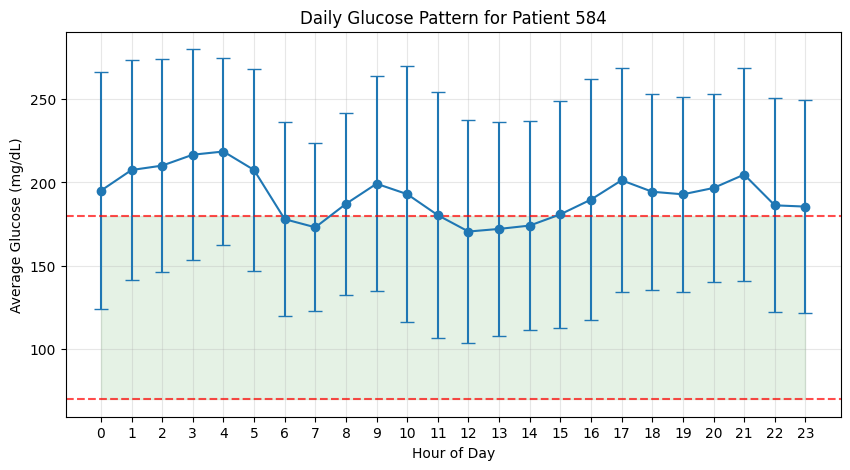

Hourly glucose patterns for patient 567:
shape: (24, 4)
┌──────┬────────────┬───────────┬───────┐
│ hour ┆ mean       ┆ std       ┆ count │
│ ---  ┆ ---        ┆ ---       ┆ ---   │
│ i8   ┆ f64        ┆ f64       ┆ u32   │
╞══════╪════════════╪═══════════╪═══════╡
│ 0    ┆ 147.939331 ┆ 54.278868 ┆ 478   │
│ 1    ┆ 122.45935  ┆ 46.266301 ┆ 492   │
│ 2    ┆ 110.179226 ┆ 39.341058 ┆ 491   │
│ 3    ┆ 115.372917 ┆ 47.874886 ┆ 480   │
│ 4    ┆ 124.0      ┆ 55.078574 ┆ 480   │
│ …    ┆ …          ┆ …         ┆ …     │
│ 19   ┆ 171.110874 ┆ 61.943803 ┆ 469   │
│ 20   ┆ 185.430131 ┆ 64.052739 ┆ 458   │
│ 21   ┆ 181.316017 ┆ 59.219908 ┆ 462   │
│ 22   ┆ 189.865306 ┆ 61.614295 ┆ 490   │
│ 23   ┆ 186.105809 ┆ 64.782534 ┆ 482   │
└──────┴────────────┴───────────┴───────┘


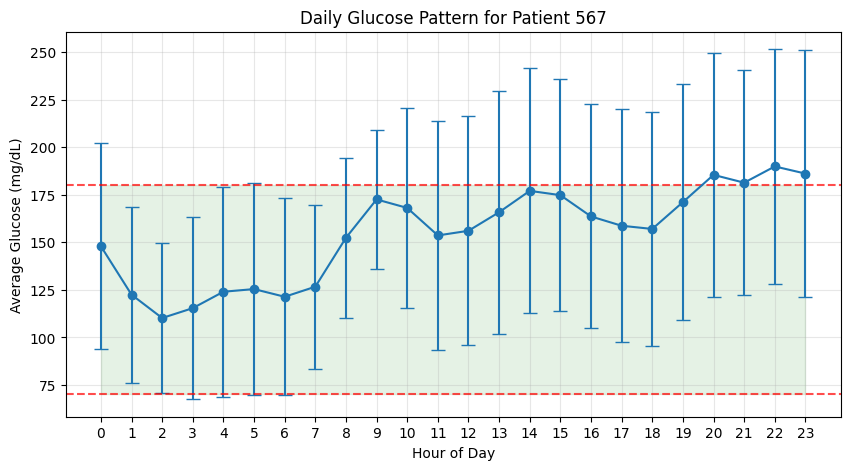

Hourly glucose patterns for patient 544:
shape: (24, 4)
┌──────┬────────────┬───────────┬───────┐
│ hour ┆ mean       ┆ std       ┆ count │
│ ---  ┆ ---        ┆ ---       ┆ ---   │
│ i8   ┆ f64        ┆ f64       ┆ u32   │
╞══════╪════════════╪═══════════╪═══════╡
│ 0    ┆ 162.62963  ┆ 54.273449 ┆ 432   │
│ 1    ┆ 148.286036 ┆ 49.797302 ┆ 444   │
│ 2    ┆ 143.438356 ┆ 51.988642 ┆ 438   │
│ 3    ┆ 139.207763 ┆ 52.754301 ┆ 438   │
│ 4    ┆ 134.61036  ┆ 46.634731 ┆ 444   │
│ …    ┆ …          ┆ …         ┆ …     │
│ 19   ┆ 153.394397 ┆ 58.609681 ┆ 464   │
│ 20   ┆ 174.186207 ┆ 60.378413 ┆ 435   │
│ 21   ┆ 200.064815 ┆ 53.420196 ┆ 432   │
│ 22   ┆ 205.854167 ┆ 55.473658 ┆ 432   │
│ 23   ┆ 185.402778 ┆ 57.8779   ┆ 432   │
└──────┴────────────┴───────────┴───────┘


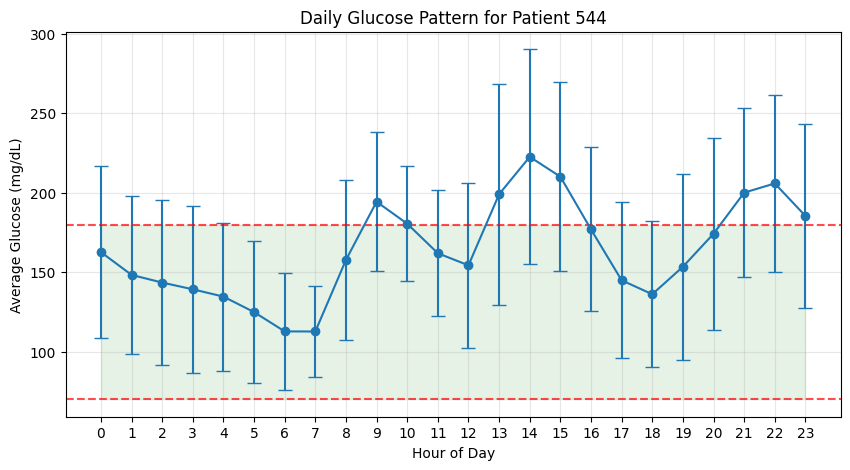

Hourly glucose patterns for patient 552:
shape: (24, 4)
┌──────┬────────────┬───────────┬───────┐
│ hour ┆ mean       ┆ std       ┆ count │
│ ---  ┆ ---        ┆ ---       ┆ ---   │
│ i8   ┆ f64        ┆ f64       ┆ u32   │
╞══════╪════════════╪═══════════╪═══════╡
│ 0    ┆ 155.237245 ┆ 43.92894  ┆ 392   │
│ 1    ┆ 152.688776 ┆ 46.511062 ┆ 392   │
│ 2    ┆ 149.568475 ┆ 49.979398 ┆ 387   │
│ 3    ┆ 143.384224 ┆ 50.214107 ┆ 393   │
│ 4    ┆ 137.190355 ┆ 49.582807 ┆ 394   │
│ …    ┆ …          ┆ …         ┆ …     │
│ 19   ┆ 151.211382 ┆ 56.976051 ┆ 369   │
│ 20   ┆ 164.351562 ┆ 61.350798 ┆ 384   │
│ 21   ┆ 172.365922 ┆ 68.059849 ┆ 358   │
│ 22   ┆ 169.91716  ┆ 58.170977 ┆ 338   │
│ 23   ┆ 169.19797  ┆ 53.072051 ┆ 394   │
└──────┴────────────┴───────────┴───────┘


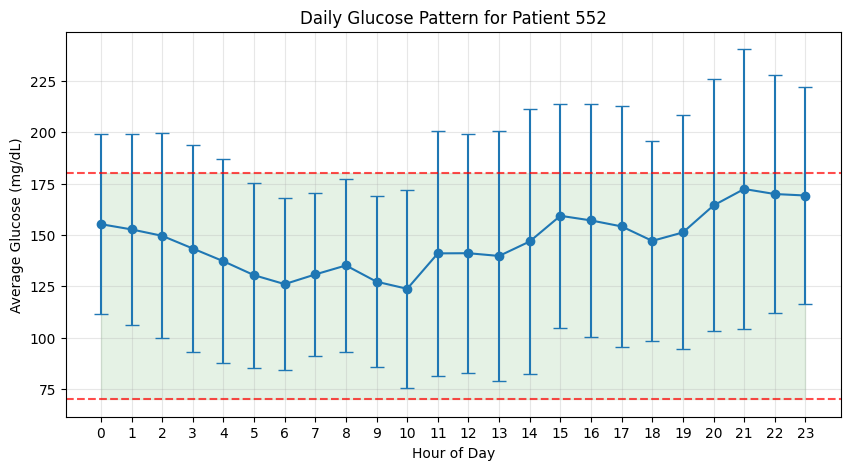

Hourly glucose patterns for patient 540:
shape: (24, 4)
┌──────┬────────────┬───────────┬───────┐
│ hour ┆ mean       ┆ std       ┆ count │
│ ---  ┆ ---        ┆ ---       ┆ ---   │
│ i8   ┆ f64        ┆ f64       ┆ u32   │
╞══════╪════════════╪═══════════╪═══════╡
│ 0    ┆ 142.420619 ┆ 47.480622 ┆ 485   │
│ 1    ┆ 143.32906  ┆ 53.002552 ┆ 468   │
│ 2    ┆ 142.839286 ┆ 62.495645 ┆ 448   │
│ 3    ┆ 137.518359 ┆ 63.680676 ┆ 463   │
│ 4    ┆ 135.59322  ┆ 62.382253 ┆ 472   │
│ …    ┆ …          ┆ …         ┆ …     │
│ 19   ┆ 133.602434 ┆ 51.699768 ┆ 493   │
│ 20   ┆ 127.01992  ┆ 59.343646 ┆ 502   │
│ 21   ┆ 131.303846 ┆ 60.492455 ┆ 520   │
│ 22   ┆ 140.033138 ┆ 53.663383 ┆ 513   │
│ 23   ┆ 144.75969  ┆ 49.304054 ┆ 516   │
└──────┴────────────┴───────────┴───────┘


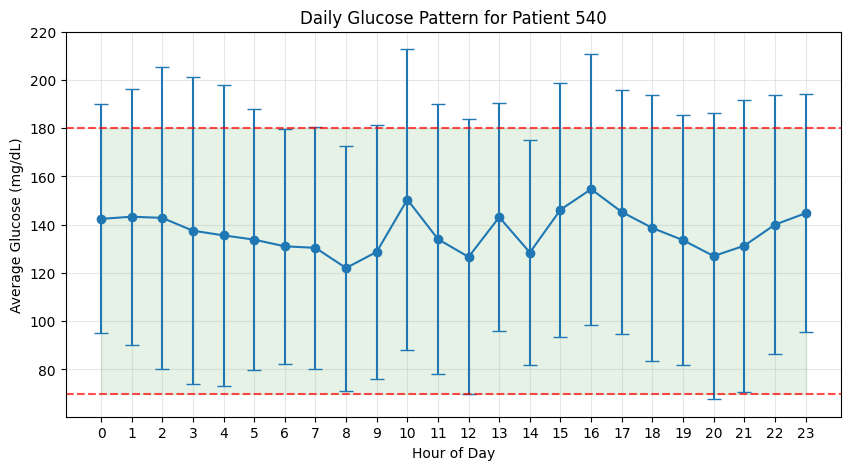

Hourly glucose patterns for patient 596:
shape: (24, 4)
┌──────┬────────────┬───────────┬───────┐
│ hour ┆ mean       ┆ std       ┆ count │
│ ---  ┆ ---        ┆ ---       ┆ ---   │
│ i8   ┆ f64        ┆ f64       ┆ u32   │
╞══════╪════════════╪═══════════╪═══════╡
│ 0    ┆ 132.348008 ┆ 41.400946 ┆ 477   │
│ 1    ┆ 128.43125  ┆ 45.369136 ┆ 480   │
│ 2    ┆ 129.403766 ┆ 47.313865 ┆ 478   │
│ 3    ┆ 139.185501 ┆ 48.196288 ┆ 469   │
│ 4    ┆ 146.420732 ┆ 46.761472 ┆ 492   │
│ …    ┆ …          ┆ …         ┆ …     │
│ 19   ┆ 161.575758 ┆ 61.651579 ┆ 462   │
│ 20   ┆ 163.944568 ┆ 57.559817 ┆ 451   │
│ 21   ┆ 161.493421 ┆ 52.118208 ┆ 456   │
│ 22   ┆ 151.492505 ┆ 41.737703 ┆ 467   │
│ 23   ┆ 142.226695 ┆ 39.335369 ┆ 472   │
└──────┴────────────┴───────────┴───────┘


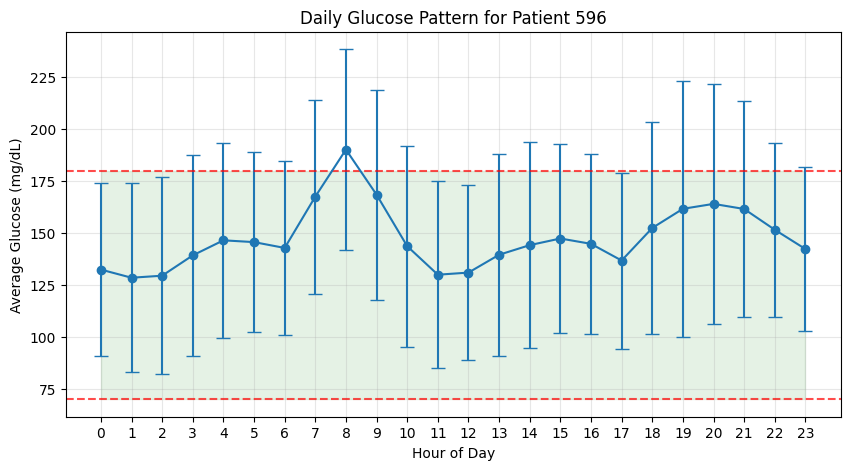

Hourly glucose patterns for patient 575:
shape: (24, 4)
┌──────┬────────────┬───────────┬───────┐
│ hour ┆ mean       ┆ std       ┆ count │
│ ---  ┆ ---        ┆ ---       ┆ ---   │
│ i8   ┆ f64        ┆ f64       ┆ u32   │
╞══════╪════════════╪═══════════╪═══════╡
│ 0    ┆ 138.153082 ┆ 56.99359  ┆ 503   │
│ 1    ┆ 135.055556 ┆ 47.828758 ┆ 468   │
│ 2    ┆ 136.290598 ┆ 51.198076 ┆ 468   │
│ 3    ┆ 137.508547 ┆ 49.174621 ┆ 468   │
│ 4    ┆ 141.826923 ┆ 53.17397  ┆ 468   │
│ …    ┆ …          ┆ …         ┆ …     │
│ 19   ┆ 150.460888 ┆ 68.257605 ┆ 473   │
│ 20   ┆ 147.480315 ┆ 60.304729 ┆ 508   │
│ 21   ┆ 151.670433 ┆ 64.636623 ┆ 531   │
│ 22   ┆ 141.562613 ┆ 63.642261 ┆ 551   │
│ 23   ┆ 136.481273 ┆ 55.040925 ┆ 534   │
└──────┴────────────┴───────────┴───────┘


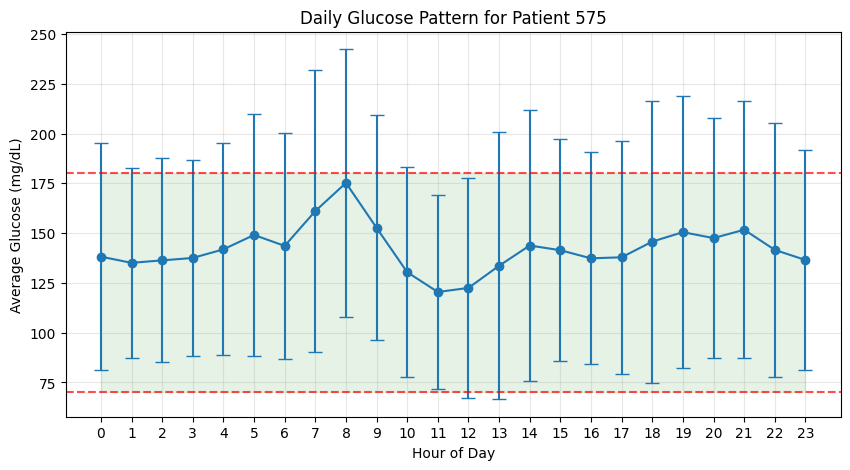

Hourly glucose patterns for patient 563:
shape: (24, 4)
┌──────┬────────────┬───────────┬───────┐
│ hour ┆ mean       ┆ std       ┆ count │
│ ---  ┆ ---        ┆ ---       ┆ ---   │
│ i8   ┆ f64        ┆ f64       ┆ u32   │
╞══════╪════════════╪═══════════╪═══════╡
│ 0    ┆ 122.501938 ┆ 42.520697 ┆ 516   │
│ 1    ┆ 125.091085 ┆ 44.228373 ┆ 516   │
│ 2    ┆ 131.488372 ┆ 47.642009 ┆ 516   │
│ 3    ┆ 142.015686 ┆ 52.372999 ┆ 510   │
│ 4    ┆ 143.149901 ┆ 46.247628 ┆ 507   │
│ …    ┆ …          ┆ …         ┆ …     │
│ 19   ┆ 155.067327 ┆ 50.858068 ┆ 505   │
│ 20   ┆ 152.760956 ┆ 49.238904 ┆ 502   │
│ 21   ┆ 147.160714 ┆ 46.329917 ┆ 504   │
│ 22   ┆ 139.541502 ┆ 47.01244  ┆ 506   │
│ 23   ┆ 131.164093 ┆ 46.414103 ┆ 518   │
└──────┴────────────┴───────────┴───────┘


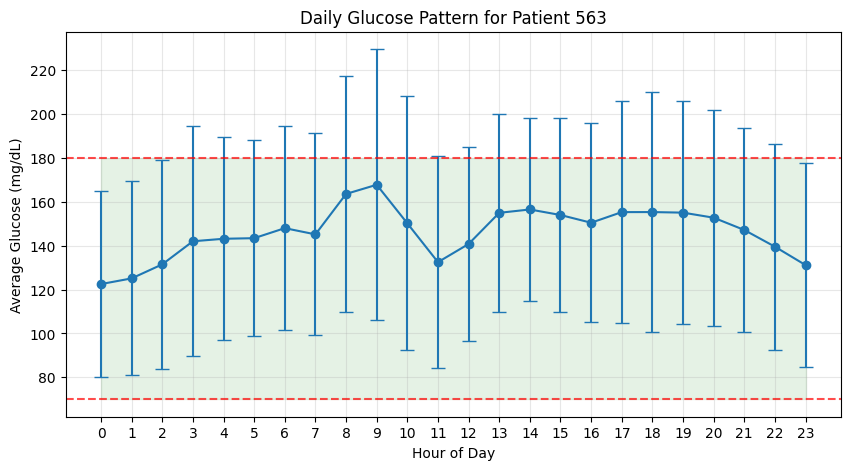

Hourly glucose patterns for patient 591:
shape: (24, 4)
┌──────┬────────────┬───────────┬───────┐
│ hour ┆ mean       ┆ std       ┆ count │
│ ---  ┆ ---        ┆ ---       ┆ ---   │
│ i8   ┆ f64        ┆ f64       ┆ u32   │
╞══════╪════════════╪═══════════╪═══════╡
│ 0    ┆ 145.620985 ┆ 51.189288 ┆ 467   │
│ 1    ┆ 156.5      ┆ 54.597042 ┆ 458   │
│ 2    ┆ 159.197368 ┆ 58.363624 ┆ 456   │
│ 3    ┆ 156.625277 ┆ 65.428327 ┆ 451   │
│ 4    ┆ 155.835526 ┆ 65.506155 ┆ 456   │
│ …    ┆ …          ┆ …         ┆ …     │
│ 19   ┆ 170.028761 ┆ 54.607948 ┆ 452   │
│ 20   ┆ 159.866667 ┆ 58.440439 ┆ 480   │
│ 21   ┆ 155.602083 ┆ 54.563613 ┆ 480   │
│ 22   ┆ 153.833333 ┆ 56.603825 ┆ 480   │
│ 23   ┆ 152.316008 ┆ 52.208994 ┆ 481   │
└──────┴────────────┴───────────┴───────┘


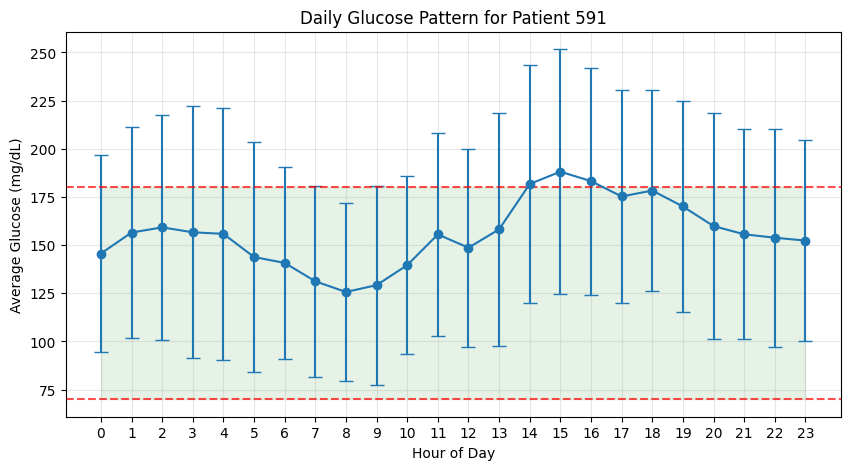

Hourly glucose patterns for patient 559:
shape: (24, 4)
┌──────┬────────────┬───────────┬───────┐
│ hour ┆ mean       ┆ std       ┆ count │
│ ---  ┆ ---        ┆ ---       ┆ ---   │
│ i8   ┆ f64        ┆ f64       ┆ u32   │
╞══════╪════════════╪═══════════╪═══════╡
│ 0    ┆ 149.103297 ┆ 70.179665 ┆ 455   │
│ 1    ┆ 144.726862 ┆ 64.722833 ┆ 443   │
│ 2    ┆ 145.649123 ┆ 58.409503 ┆ 456   │
│ 3    ┆ 145.278146 ┆ 57.081276 ┆ 453   │
│ 4    ┆ 147.238739 ┆ 50.417371 ┆ 444   │
│ …    ┆ …          ┆ …         ┆ …     │
│ 19   ┆ 170.612245 ┆ 71.546531 ┆ 441   │
│ 20   ┆ 161.285408 ┆ 62.718676 ┆ 466   │
│ 21   ┆ 160.182403 ┆ 62.221897 ┆ 466   │
│ 22   ┆ 158.835526 ┆ 60.377324 ┆ 456   │
│ 23   ┆ 153.888158 ┆ 61.474292 ┆ 456   │
└──────┴────────────┴───────────┴───────┘


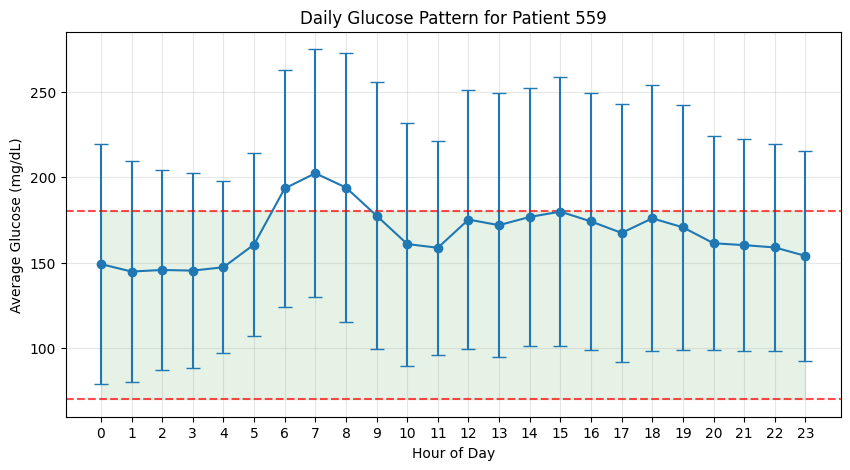

Hourly glucose patterns for patient 570:
shape: (24, 4)
┌──────┬────────────┬───────────┬───────┐
│ hour ┆ mean       ┆ std       ┆ count │
│ ---  ┆ ---        ┆ ---       ┆ ---   │
│ i8   ┆ f64        ┆ f64       ┆ u32   │
╞══════╪════════════╪═══════════╪═══════╡
│ 0    ┆ 175.194444 ┆ 61.344768 ┆ 468   │
│ 1    ┆ 189.971739 ┆ 59.086596 ┆ 460   │
│ 2    ┆ 202.205817 ┆ 53.294155 ┆ 447   │
│ 3    ┆ 210.127315 ┆ 52.646173 ┆ 432   │
│ 4    ┆ 212.759259 ┆ 50.534107 ┆ 432   │
│ …    ┆ …          ┆ …         ┆ …     │
│ 19   ┆ 153.544218 ┆ 49.66889  ┆ 441   │
│ 20   ┆ 151.735808 ┆ 55.670668 ┆ 458   │
│ 21   ┆ 157.329764 ┆ 65.829068 ┆ 467   │
│ 22   ┆ 161.772043 ┆ 68.521734 ┆ 465   │
│ 23   ┆ 165.014644 ┆ 65.059478 ┆ 478   │
└──────┴────────────┴───────────┴───────┘


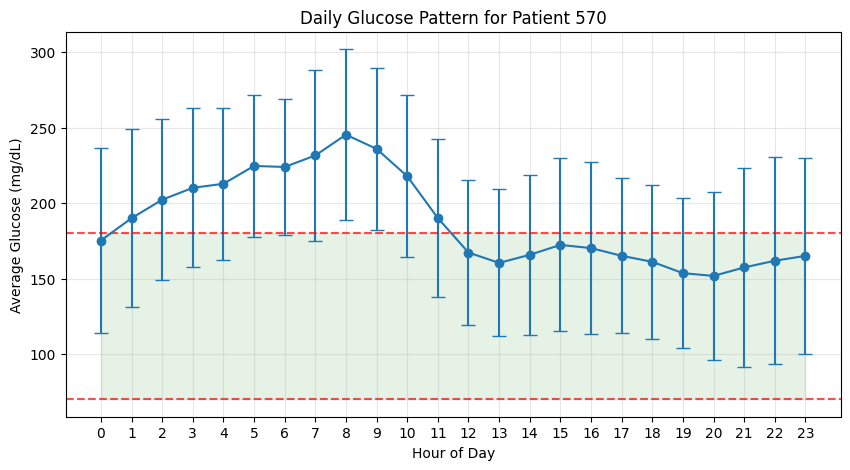

Hourly glucose patterns for patient 588:
shape: (24, 4)
┌──────┬────────────┬───────────┬───────┐
│ hour ┆ mean       ┆ std       ┆ count │
│ ---  ┆ ---        ┆ ---       ┆ ---   │
│ i8   ┆ f64        ┆ f64       ┆ u32   │
╞══════╪════════════╪═══════════╪═══════╡
│ 0    ┆ 157.818008 ┆ 45.963052 ┆ 522   │
│ 1    ┆ 151.748106 ┆ 47.667999 ┆ 528   │
│ 2    ┆ 151.585271 ┆ 50.251006 ┆ 516   │
│ 3    ┆ 163.541667 ┆ 45.766487 ┆ 528   │
│ 4    ┆ 174.026515 ┆ 42.155257 ┆ 528   │
│ …    ┆ …          ┆ …         ┆ …     │
│ 19   ┆ 171.176364 ┆ 52.410456 ┆ 550   │
│ 20   ┆ 160.293578 ┆ 55.212175 ┆ 545   │
│ 21   ┆ 169.39633  ┆ 58.428507 ┆ 545   │
│ 22   ┆ 173.444444 ┆ 57.95631  ┆ 540   │
│ 23   ┆ 166.456604 ┆ 48.229044 ┆ 530   │
└──────┴────────────┴───────────┴───────┘


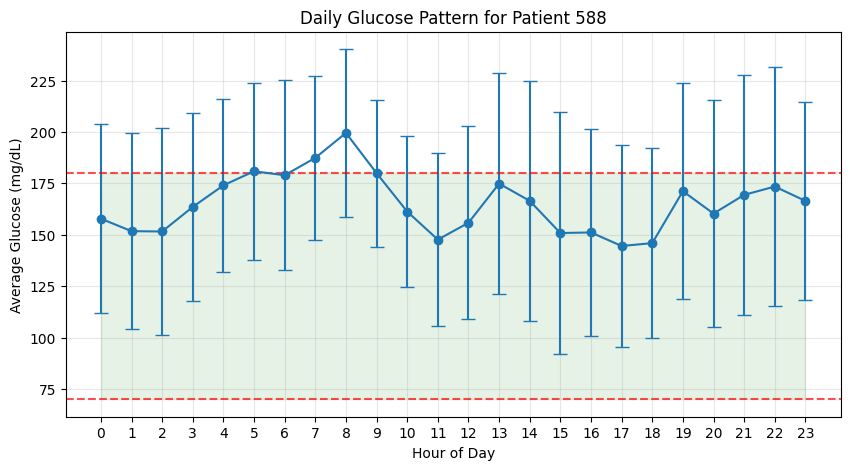

In [20]:
for patient in patient_ids:
    glucose_df = patient_data[patient]['glucose']
    time_of_day_analysis(patient, glucose_df)

## Análisis de Features

In [21]:
def create_bolus_visualization(df, patient_id):
    # Check for ts_begin instead of ts
    if 'ts_begin' in df.columns and 'dose' in df.columns:
        # Clean any None or NaN values
        clean_df = df.filter(pl.col('dose').is_not_null())
        
        if len(clean_df) > 0:
            # Use ts_begin instead of ts
            timestamps = clean_df['ts_begin'].to_list()
            doses = clean_df['dose'].to_list()
            
            time_series_fig = go.Figure()
            
            # Time series plot of insulin doses
            time_series_fig.add_trace(go.Scatter(
                x=timestamps, 
                y=doses,
                mode='markers',
                name='Insulin Doses',
                marker=dict(
                    size=10, 
                    color=doses,
                    colorscale='Blues',
                    showscale=True,
                    colorbar=dict(title="Dose (units)")
                )
            ))
            
            time_series_fig.update_layout(
                title=f"Insulin Boluses Over Time for Patient {patient_id}",
                xaxis_title="Time",
                yaxis_title="Insulin Dose (units)"
            )
            
            # Distribution of doses
            distribution_pattern_fig = go.Figure()
            distribution_pattern_fig.add_trace(go.Histogram(
                x=doses,
                nbinsx=15,
                marker_color='steelblue',
                name='Dose Distribution'
            ))
            
            distribution_pattern_fig.update_layout(
                title=f"Distribution of Insulin Doses for Patient {patient_id}",
                xaxis_title="Insulin Dose (units)",
                yaxis_title="Frequency"
            )
            
            # Add time of day analysis - when are doses typically given?
            hour_data = df.with_columns(pl.col('ts_begin').dt.hour().alias('hour'))
            hours_count = (hour_data
                .group_by('hour')
                .agg(pl.len().alias('count'))
                .sort('hour')
            )
            
            bar_chart_fig = go.Figure()
            bar_chart_fig.add_trace(go.Bar(
                x=hours_count['hour'].to_list(),
                y=hours_count['count'].to_list(),
                marker_color='darkblue'
            ))
            
            bar_chart_fig.update_layout(
                title=f"Bolus Timing Distribution for Patient {patient_id}",
                xaxis_title="Hour of Day",
                yaxis_title="Number of Boluses",
                xaxis=dict(tickvals=list(range(0, 24, 2)))
            )
            
            time_series_fig.show()
            distribution_pattern_fig.show()
            bar_chart_fig.show()
    else:
        print(f"Required columns not found. Available columns: {df.columns}")

In [22]:
def create_meal_visualization(df, patient_id):
    if 'ts' in df.columns and 'carbs' in df.columns:
        clean_df = df.filter(pl.col('carbs').is_not_null())
        
        if len(clean_df) > 0:
            timestamps = clean_df['ts'].to_list()
            carbs = clean_df['carbs'].to_list()
            
            time_series_fig = go.Figure()
            
            time_series_fig.add_trace(go.Scatter(
                x=timestamps, 
                y=carbs,
                mode='markers',
                name='Carb Intake',
                marker=dict(
                    size=10, 
                    color=carbs,
                    colorscale='Greens',
                    showscale=True,
                    colorbar=dict(title="Carbs (g)")
                )
            ))
            
            time_series_fig.update_layout(
                title=f"Carbohydrate Intake Over Time for Patient {patient_id}",
                xaxis_title="Time",
                yaxis_title="Carbohydrates (g)"
            )
            
            # Add meal size distribution
            distribution_pattern_fig = go.Figure()
            distribution_pattern_fig.add_trace(go.Histogram(
                x=carbs,
                nbinsx=15,
                marker_color='lightgreen',
                name='Meal Size Distribution'
            ))
            
            distribution_pattern_fig.update_layout(
                title=f"Distribution of Meal Sizes for Patient {patient_id}",
                xaxis_title="Carbohydrates (g)",
                yaxis_title="Frequency"
            )
            
            # Add time of day analysis - when are meals typically eaten?
            hour_data = df.with_columns(pl.col('ts').dt.hour().alias('hour'))
            hours_count = (hour_data
                .group_by('hour')
                .agg([
                    pl.len().alias('count'),
                    pl.col('carbs').mean().alias('avg_carbs')
                ])
                .sort('hour')
            )
            
            bar_chart_fig = go.Figure()
            bar_chart_fig.add_trace(go.Bar(
                x=hours_count['hour'].to_list(),
                y=hours_count['count'].to_list(),
                name='Meal Count',
                marker_color='lightgreen'
            ))
            
            bar_chart_fig.add_trace(go.Scatter(
                x=hours_count['hour'].to_list(),
                y=hours_count['avg_carbs'].to_list(),
                name='Avg Carbs',
                mode='lines+markers',
                yaxis='y2',
                line=dict(color='darkgreen', width=2)
            ))
            
            bar_chart_fig.update_layout(
                title=f"Meal Timing Analysis for Patient {patient_id}",
                xaxis_title="Hour of Day",
                yaxis_title="Number of Meals",
                yaxis2=dict(
                    title="Avg Carbs (g)",
                    overlaying="y",
                    side="right"
                ),
                xaxis=dict(tickvals=list(range(0, 24, 2))),
                legend=dict(x=0.01, y=0.99)
            )
            
            time_series_fig.show()
            distribution_pattern_fig.show()
            bar_chart_fig.show()

In [23]:
def create_exercise_visualization(df, patient_id):
    """Create visualizations for exercise data."""
    if 'ts' not in df.columns:
        print(f"No timestamp data available for exercise visualization")
        return
        
    timestamps = df['ts'].to_list()
    
    # Create event markers for exercises
    time_series_fig = go.Figure()
    time_series_fig.add_trace(go.Scatter(
        x=timestamps,
        y=[1] * len(timestamps),  # All at same level for visibility
        mode='markers',
        marker=dict(size=10, color='orange', symbol='triangle-up'),
        name='Exercise Events'
    ))
    
    # Add duration if available
    if 'duration' in df.columns:
        durations = df['duration'].to_list()
        
        # Add intensity information if available
        hover_text = []
        for i, d in enumerate(durations):
            info_text = f"Duration: {d} min"
            if 'intensity' in df.columns and not df['intensity'].is_null().all():
                intensity = df['intensity'][i] if i < len(df) else None
                if intensity is not None:
                    info_text += f"<br>Intensity: {intensity}"
            hover_text.append(info_text)
            
        time_series_fig.update_traces(
            text=hover_text,
            hoverinfo="text+x"
        )
        
        # Add second plot for durations
        durations_fig = go.Figure()
        durations_fig.add_trace(go.Box(
            y=durations,
            name='Exercise Duration',
            boxmean=True,
            marker_color='orange'
        ))
        
        durations_fig.update_layout(
            title=f"Exercise Duration Analysis for Patient {patient_id}",
            yaxis_title="Duration (min)"
        )
    
    time_series_fig.update_layout(
        title=f"Exercise Events for Patient {patient_id}",
        xaxis_title="Time",
        yaxis_title="",
        yaxis=dict(visible=False)  # Hide y-axis since it's just for visualization
    )
    
    # Add weekday/hour heatmap for exercise timing patterns
    try:
        weekday_hour_data = df.with_columns([
            pl.col('ts').dt.weekday().alias('weekday'),
            pl.col('ts').dt.hour().alias('hour')
        ])
        
        # Create weekday-hour count table
        weekday_names = ['Monday', 'Tuesday', 'Wednesday', 'Thursday', 'Friday', 'Saturday', 'Sunday']
        heatmap_data = np.zeros((7, 24))
        
        # This is where the error was occurring - fixed iteration approach
        for row in weekday_hour_data.iter_rows(named=True):
            weekday = row['weekday']
            hour = row['hour']
            if 0 <= weekday < 7 and 0 <= hour < 24:  # Add bounds checking
                heatmap_data[weekday, hour] += 1
        
        heatmap_fig = go.Figure(data=go.Heatmap(
            z=heatmap_data,
            x=list(range(24)),
            y=weekday_names,
            colorscale='Oranges',
            hoverongaps=False
        ))
        
        heatmap_fig.update_layout(
            title=f"Exercise Timing Patterns for Patient {patient_id}",
            xaxis_title="Hour of Day",
            yaxis_title="Day of Week"
        )
        
        # Display all figures
        time_series_fig.show()
        if 'duration' in df.columns:
            durations_fig.show()
        heatmap_fig.show()
        
    except Exception as e:
        print(f"Error creating heatmap: {e}")
        # Still show the time series even if heatmap fails
        time_series_fig.show()
        if 'duration' in df.columns:
            durations_fig.show()

In [24]:
def create_sleep_visualization(df, patient_id):
    # Check for either the regular sleep columns or the basis_sleep columns
    if ('ts_begin' in df.columns and 'ts_end' in df.columns):
        begin_col = 'ts_begin'
        end_col = 'ts_end'
    elif ('tbegin' in df.columns and 'tend' in df.columns):
        begin_col = 'tbegin'
        end_col = 'tend'
    else:
        print(f"Required columns not found. Available columns: {df.columns}")
        return
    print(f"Using columns {begin_col} and {end_col} for sleep data")
    
    # Calculate sleep duration in hours
    try:
        # Print the timestamp data types to verify they're datetime objects
        print(f"Begin timestamp dtype: {df[begin_col].dtype}")
        print(f"End timestamp dtype: {df[end_col].dtype}")
        
        # Calculate durations with more explicit error handling
        df = df.with_columns([
            pl.col(begin_col).cast(pl.Datetime).alias('begin_dt'),
            pl.col(end_col).cast(pl.Datetime).alias('end_dt')
        ])
        
        # Calculate duration and ensure it's numeric
        df = df.with_columns([
            ((pl.col(end_col) - pl.col(begin_col)).dt.total_hours().abs()).alias('duration_hrs')
        ])
        
        # Calculate weekday now, using the datetime column we created
        df = df.with_columns([
            pl.col(begin_col).dt.weekday().alias('weekday')
        ])
        
        # Verify the duration calculation worked
        print(f"Duration calculation - first 5 rows:")
        print(df.select([begin_col, end_col, 'duration_hrs']).head(5))
        
        timestamps = df[begin_col].to_list()
        durations_hrs = df['duration_hrs'].to_list()
        
    except Exception as e:
        print(f"Error calculating sleep duration: {e}")
        print("Attempting alternative calculation method...")
        
        # Fallback method using pandas for calculation
        import pandas as pd
        df_pd = df.to_pandas()
        
        # Convert to datetime just in case
        df_pd[begin_col] = pd.to_datetime(df_pd[begin_col])
        df_pd[end_col] = pd.to_datetime(df_pd[end_col])
        
        # Calculate duration in hours
        df_pd['duration_hrs'] = (df_pd[begin_col] - df_pd[end_col]).abs().dt.total_seconds() / 3600
        
        # Add weekday information 
        df_pd['weekday'] = df_pd[begin_col].dt.weekday
        
        # Convert back to polars
        df = pl.from_pandas(df_pd)
        timestamps = df[begin_col].to_list()
        durations_hrs = df['duration_hrs'].to_list()
    
    # Verify we have the data before proceeding
    if 'duration_hrs' not in df.columns:
        print("Error: duration_hrs column not created successfully")
        return
        
    # Continue with visualization as before...
    time_series_fig = go.Figure()
    
    # Color by quality if available - FIX HERE
    if 'quality' in df.columns:
        # Convert quality to float to avoid string color errors
        df = df.with_columns([
            pl.col('quality').cast(pl.Float64).alias('quality_float')
        ])
        qualities = df['quality_float'].to_list()
        
        time_series_fig.add_trace(go.Scatter(
            x=timestamps,
            y=durations_hrs,
            mode='lines+markers',
            name='Sleep Duration',
            marker=dict(
                size=10,
                color=qualities,
                colorscale='Viridis',
                showscale=True,
                colorbar=dict(title="Sleep Quality")
            ),
            line=dict(color='purple')
        ))
    else:
        time_series_fig.add_trace(go.Scatter(
            x=timestamps,
            y=durations_hrs,
            mode='lines+markers',
            name='Sleep Duration',
            line=dict(color='purple')
        ))
    
    time_series_fig.update_layout(
        title=f"Sleep Duration Over Time for Patient {patient_id}",
        xaxis_title="Date",
        yaxis_title="Sleep Duration (hours)"
    )
    
    # Add sleep duration distribution
    distribution_fig = go.Figure()
    distribution_fig.add_trace(go.Histogram(
        x=durations_hrs,
        nbinsx=10,
        marker_color='lavender',
        name='Sleep Duration'
    ))
    
    distribution_fig.update_layout(
        title=f"Sleep Duration Distribution for Patient {patient_id}",
        xaxis_title="Sleep Duration (hours)",
        yaxis_title="Frequency"
    )
    
    # Add boxplot by weekday - ensure the weekday column exists
    if 'weekday' not in df.columns:
        print("Warning: weekday information not available for boxplot")
    else:
        # Group by weekday
        weekday_names = ['Monday', 'Tuesday', 'Wednesday', 'Thursday', 'Friday', 'Saturday', 'Sunday']
        weekday_sleep = []
        
        for i in range(7):
            day_data = df.filter(pl.col('weekday') == i)
            if len(day_data) > 0:
                durations = day_data['duration_hrs'].to_list()
                weekday_sleep.append(durations)
            else:
                weekday_sleep.append([])
        
        box_chart_fig = go.Figure()
        for i in range(7):
            if weekday_sleep[i]:
                box_chart_fig.add_trace(go.Box(
                    y=weekday_sleep[i],
                    name=weekday_names[i],
                    boxmean=True
                ))
        
        box_chart_fig.update_layout(
            title=f"Sleep Duration by Weekday for Patient {patient_id}",
            yaxis_title="Sleep Duration (hours)"
        )
    
    # If quality data is available, create a visualization for it
    if 'quality' in df.columns:
        quality_fig = go.Figure()
        
        # Make sure to cast quality to float here as well
        quality_values = df['quality'].cast(pl.Float64).to_list()
        
        quality_fig.add_trace(go.Histogram(
            x=quality_values,
            nbinsx=5,
            marker_color='teal',
            name='Sleep Quality'
        ))
        
        quality_fig.update_layout(
            title=f"Distribution of Sleep Quality for Patient {patient_id}",
            xaxis_title="Sleep Quality",
            yaxis_title="Frequency"
        )
        
        # Show correlation between duration and quality - fix here too
        correlation_fig = go.Figure()
        correlation_fig.add_trace(go.Scatter(
            x=df['duration_hrs'].to_list(),
            y=quality_values,  # Use the numeric quality values
            mode='markers',
            marker=dict(
                size=10,
                opacity=0.7
            ),
            name='Duration vs Quality'
        ))
        
        correlation_fig.update_layout(
            title=f"Sleep Duration vs Quality for Patient {patient_id}",
            xaxis_title="Sleep Duration (hours)",
            yaxis_title="Sleep Quality"
        )
        
        # Show all figures
        time_series_fig.show()
        distribution_fig.show()
        if 'weekday' in df.columns:
            box_chart_fig.show()
        quality_fig.show()
        correlation_fig.show()
    else:
        # Show figures without quality data
        time_series_fig.show()
        distribution_fig.show()
        if 'weekday' in df.columns:
            box_chart_fig.show()

In [25]:
def create_basal_visualization(basal_data, patient_id=None, ax=None, time_range=None):
    """
    Create a visualization of basal insulin rates.
    
    Parameters:
    -----------
    basal_data : DataFrame, str, or list
        Polars DataFrame, XML string, or parsed list of basal events
    patient_id : str, optional
        Patient ID for title
    ax : matplotlib.axes.Axes, optional
        The axes to plot on. If None, a new figure and axes will be created.
    time_range : tuple, optional
        (start_time, end_time) to limit the x-axis range
    
    Returns:
    --------
    matplotlib.axes.Axes
        The axes containing the plot
    """
    
    # If ax is not provided, create a new figure and axes
    if ax is None:
        fig, ax = plt.subplots(figsize=(10, 4))
    
    # Handle different input types
    if isinstance(basal_data, pl.DataFrame):
        # For Polars DataFrame
        if 'ts' in basal_data.columns and 'value' in basal_data.columns:
            times = basal_data['ts'].to_list()
            rates = basal_data['value'].to_list()
        else:
            print(f"Required columns not found. Available columns: {basal_data.columns}")
            return ax
    elif isinstance(basal_data, str):
        # For XML string
        root = ET.fromstring(basal_data)
        events = root.findall('.//event')
        times = []
        rates = []
        for event in events:
            ts = event.get('ts')
            value = float(event.get('value'))
            dt = datetime.strptime(ts, '%d-%m-%Y %H:%M:%S')
            times.append(dt)
            rates.append(value)
    elif isinstance(basal_data, list) and len(basal_data) > 0 and hasattr(basal_data[0], 'get'):
        # For list of XML elements
        times = []
        rates = []
        for event in basal_data:
            ts = event.get('ts')
            value = float(event.get('value'))
            dt = datetime.strptime(ts, '%d-%m-%Y %H:%M:%S')
            times.append(dt)
            rates.append(value)
    else:
        print("Unsupported data format for basal visualization")
        return ax
    
    if not times or not rates:
        print("No data found for visualization")
        return ax
    
    # Sort by time to ensure proper visualization
    time_rate_pairs = sorted(zip(times, rates), key=lambda x: x[0])
    times = [pair[0] for pair in time_rate_pairs]
    rates = [pair[1] for pair in time_rate_pairs]
    
    # Create step plot (where='post' means the value stays constant until the next change)
    ax.step(times, rates, where='post', color='purple', linewidth=2, label='Basal Rate')
    
    # Fill the area under the step plot to emphasize the insulin delivery
    ax.fill_between(times, rates, step='post', alpha=0.3, color='purple')
    
    # Set labels and title
    ax.set_xlabel('Time')
    ax.set_ylabel('Basal Rate (units/hour)')
    title = 'Basal Insulin Profile'
    if patient_id:
        title += f' for Patient {patient_id}'
    ax.set_title(title)
    
    # Format x-axis to show dates nicely
    ax.xaxis.set_major_formatter(DateFormatter('%d-%m %H:%M'))
    plt.xticks(rotation=45)
    
    # Set y-axis to start at 0 and include a small margin above the maximum rate
    ax.set_ylim(bottom=0, top=max(rates) * 1.2)
    
    # Add grid for better readability
    ax.grid(True, linestyle='--', alpha=0.7)
    
    # Set time range if provided
    if time_range:
        ax.set_xlim(time_range)
    
    # Add legend
    ax.legend()
    
    # Make layout tight
    plt.tight_layout()
    
    return ax

In [26]:
def create_feature_visualization(patient_id, feature_name, df):
    """Create appropriate visualizations based on feature type."""
    
    if len(df) == 0:
        print(f"No {feature_name} data available for visualization")
        return
        
    print(f"Creating visualization for {feature_name} with {len(df)} records")
    
    # First figure: Time series visualization (works for most features)
    fig1 = go.Figure()
    
    # Second figure: Distribution or pattern visualization
    fig2 = go.Figure()
    
    if feature_name == 'bolus':
        create_bolus_visualization(df, patient_id)
    elif feature_name == 'meal':
        create_meal_visualization(df, patient_id)
    elif feature_name == 'exercise':
        create_exercise_visualization(df, patient_id)
    elif feature_name == 'basis_sleep' or feature_name == 'sleep':
        create_sleep_visualization(df, patient_id)
    elif feature_name == 'basal':
        create_basal_visualization(df, patient_id)
    else:
        # Generic visualization for any other feature type
        print(f"Creating generic visualization for {feature_name}")
        
        # Find numeric columns for visualization
        numeric_cols = [col for col in df.columns 
                     if col not in ['patient_id', 'ts'] 
                     and df[col].dtype in [pl.Float64, pl.Int64]]
        
        if numeric_cols:
            for col in numeric_cols:
                if 'ts' in df.columns:
                    # Time series plot
                    clean_df = df.filter(pl.col(col).is_not_null())
                    if len(clean_df) > 0:
                        fig1.add_trace(go.Scatter(
                            x=clean_df['ts'].to_list(),
                            y=clean_df[col].to_list(),
                            mode='lines+markers',
                            name=col
                        ))
            
            fig1.update_layout(
                title=f"{feature_name.capitalize()} Data for Patient {patient_id}",
                xaxis_title="Time",
                yaxis_title="Value"
            )
            
            fig1.show()
            
            # Distribution plots for numeric columns
            for col in numeric_cols:
                clean_df = df.filter(pl.col(col).is_not_null())
                if len(clean_df) > 0:
                    fig_dist = go.Figure()
                    fig_dist.add_trace(go.Histogram(
                        x=clean_df[col].to_list(),
                        nbinsx=15,
                        marker_color='lightblue',
                        name=col
                    ))
                    
                    fig_dist.update_layout(
                        title=f"Distribution of {col} for Patient {patient_id}",
                        xaxis_title=col,
                        yaxis_title="Frequency"
                    )
                    
                    fig_dist.show()
        else:
            # For categorical data or data without numeric values
            print(f"No numeric columns available for plotting in {feature_name}")
            
            # Try to visualize timestamps or categories if available
            if 'ts' in df.columns:
                # Plot occurrences over time
                dates = pd.to_datetime(df['ts'].to_list()).date
                date_counts = pd.Series(dates).value_counts().sort_index()
                
                fig1.add_trace(go.Bar(
                    x=date_counts.index,
                    y=date_counts.values,
                    name=feature_name
                ))
                
                fig1.update_layout(
                    title=f"{feature_name.capitalize()} Events by Date for Patient {patient_id}",
                    xaxis_title="Date",
                    yaxis_title="Number of Events"
                )
                
                fig1.show()

In [27]:
def analyze_feature(feature_name, patient_data):
    """Analyze a specific feature across all patients."""
    print(f"\n## {feature_name.upper()} ANALYSIS ##\n")
    
    for patient_id, data in patient_data.items():
        if feature_name in data and len(data[feature_name]) > 0:
            df = data[feature_name]
            if df is None:
                print(f"No data available for {feature_name} for patient {patient_id}")
                continue
            print(f"\nAnalyzing {feature_name} for patient {patient_id}:")
            print(f"Number of records: {len(df)}")
            
            # Show dataframe structure (columns)
            print("Feature columns:", df.columns)
            
            # Basic statistics for numeric columns
            numeric_cols = [col for col in df.columns 
                           if col not in ['patient_id'] and 
                           df[col].dtype in [pl.Float64, pl.Int64]]
            
            for col in numeric_cols:
                try:
                    print(f"\nStatistics for {col}:")
                    print(df[col].describe())
                except:
                    print(f"Could not analyze column {col}")
            
            # Create visualization if appropriate
            if len(df.columns) > 0:
                try:
                    create_feature_visualization(patient_id, feature_name, df)
                except Exception as e:
                    print(f"Could not create visualization: {e}")
        else:
            print(f"No {feature_name} data available for patient {patient_id}")

In [28]:
def visualize_meal_bolus_glucose_relationships(patient_id, meal_bolus_pairs, glucose_df):
    """
    Create visualizations showing relationships between meals, insulin boluses, and glucose responses.
    
    Parameters:
    - patient_id: ID of the patient
    - meal_bolus_pairs: List of dictionaries containing aligned meal and bolus data
    - glucose_df: Polars DataFrame containing glucose readings
    """
    if not meal_bolus_pairs:
        print(f"No meal-bolus pairs available for patient {patient_id}")
        return
    
    # Create a figure for carb-insulin ratio effectiveness
    fig1 = go.Figure()
    
    # Extract data for plotting
    carbs = [p['carbs'] for p in meal_bolus_pairs if 'carbs' in p]
    doses = [p['insulin_dose'] for p in meal_bolus_pairs if 'insulin_dose' in p and p['insulin_dose'] is not None]
    ratios = [p['carb_insulin_ratio'] for p in meal_bolus_pairs if 'carb_insulin_ratio' in p]
    in_range_pcts = [p['percent_in_range'] for p in meal_bolus_pairs if 'percent_in_range' in p]
    peaks = [p['glucose_peak'] for p in meal_bolus_pairs if 'glucose_peak' in p]
    
    # Plot carbs vs. insulin with color showing glucose outcomes
    if carbs and doses and peaks:
        fig1.add_trace(go.Scatter(
            x=carbs,
            y=doses,
            mode='markers',
            marker=dict(
                size=10,
                color=peaks,
                colorscale='RdYlGn_r',  # Red for high peaks, green for low peaks
                colorbar=dict(title="Glucose Peak (mg/dL)"),
                showscale=True
            ),
            text=[f"Carbs: {c}g<br>Insulin: {d}u<br>Peak: {p} mg/dL<br>In range: {r:.1f}%" 
                  for c, d, p, r in zip(carbs, doses, peaks, in_range_pcts)],
            hoverinfo="text",
            name="Meal-Bolus Pairs"
        ))
        
        # Add reference lines for common carb-to-insulin ratios
        max_carbs = max(carbs)
        for ratio in [5, 10, 15, 20]:
            x_ref = list(range(0, int(max_carbs) + 10, 10))
            y_ref = [x/ratio for x in x_ref]
            
            fig1.add_trace(go.Scatter(
                x=x_ref,
                y=y_ref,
                mode='lines',
                line=dict(dash='dash', width=1),
                name=f"{ratio}:1 ratio"
            ))
        
        fig1.update_layout(
            title=f"Carbohydrate to Insulin Relationship for Patient {patient_id}",
            xaxis_title="Carbohydrates (g)",
            yaxis_title="Insulin Dose (units)",
            legend_title="Carb:Insulin Ratios"
        )
        
        fig1.show()
    
    # Create glucose response profiles for each meal-bolus pair
    fig2 = go.Figure()
    
    # Select a few representative meal-bolus pairs to avoid overcrowding
    sample_size = min(10, len(meal_bolus_pairs))
    sample_pairs = meal_bolus_pairs[:sample_size]
    
    for i, pair in enumerate(sample_pairs):
        if 'meal_time' in pair:
            # Get glucose readings from 30 min before meal to 3 hours after
            start_time = pair['meal_time'] - pd.Timedelta(minutes=30)
            end_time = pair['meal_time'] + pd.Timedelta(hours=3)
            
            meal_glucose = glucose_df.filter(
                (pl.col('timestamp') >= start_time) &
                (pl.col('timestamp') <= end_time)
            )
            
            if len(meal_glucose) > 0:
                # Normalize times to minutes relative to meal
                times = [(t - pair['meal_time']).total_seconds()/60 
                         for t in meal_glucose['timestamp'].to_list()]
                values = meal_glucose['value'].to_list()
                
                # Add this meal's glucose profile to the figure
                fig2.add_trace(go.Scatter(
                    x=times,
                    y=values,
                    mode='lines',
                    name=f"Meal {i+1}: {pair['carbs']}g, {pair['insulin_dose']}u",
                    opacity=0.7
                ))
    
    # Add reference lines and areas
    fig2.add_hrect(y0=70, y1=180, fillcolor="green", opacity=0.1, 
                  line_width=0, name="Target Range")
    fig2.add_vline(x=0, line_dash="dash", line_color="blue", 
                  annotation_text="Meal Time", annotation_position="top right")
    
    fig2.update_layout(
        title=f"Glucose Responses to Meals for Patient {patient_id}",
        xaxis_title="Minutes from Meal",
        yaxis_title="Glucose (mg/dL)",
        hovermode="closest",
        legend_title="Meal Details"
    )
    
    fig2.show()
    
    # Create a chart showing how the carb-to-insulin ratio affects peak glucose
    if ratios and peaks:
        fig3 = go.Figure()
        
        fig3.add_trace(go.Scatter(
            x=ratios,
            y=peaks,
            mode='markers',
            marker=dict(
                size=10,
                color=in_range_pcts,
                colorscale='RdYlGn',  # Green for high in-range time, red for low
                colorbar=dict(title="Time in Range (%)"),
                showscale=True
            ),
            text=[f"Ratio: {r:.1f}g/u<br>Peak: {p} mg/dL<br>In range: {ir:.1f}%" 
                  for r, p, ir in zip(ratios, peaks, in_range_pcts)],
            hoverinfo="text",
        ))
        
        # Add reference line for target glucose
        fig3.add_hline(y=180, line_dash="dash", line_color="red", 
                      annotation_text="High Threshold", annotation_position="right")
        
        # Calculate trend line
        if len(ratios) >= 2:
            try:
                slope, intercept = np.polyfit(ratios, peaks, 1)
                x_range = np.linspace(min(ratios), max(ratios), 100)
                y_fit = slope * x_range + intercept
                
                fig3.add_trace(go.Scatter(
                    x=x_range,
                    y=y_fit,
                    mode='lines',
                    line=dict(color='black', dash='dot'),
                    name=f"Trend (slope: {slope:.1f})"
                ))
                
                # Add annotation explaining the trend
                trend_direction = "higher" if slope > 0 else "lower"
                fig3.add_annotation(
                    text=f"Each additional g/u results in {abs(slope):.1f} mg/dL {trend_direction} peak",
                    xref="paper", yref="paper",
                    x=0.5, y=0.05,
                    showarrow=False,
                    font=dict(size=10)
                )
            except:
                # In case the trend calculation fails
                pass
                
        fig3.update_layout(
            title=f"Impact of Carb-to-Insulin Ratio on Peak Glucose for Patient {patient_id}",
            xaxis_title="Carb-to-Insulin Ratio (g/unit)",
            yaxis_title="Peak Glucose (mg/dL)"
        )
        
        fig3.show()
        
    # Create a visualization of time-to-peak distribution
    if 'time_to_peak' in meal_bolus_pairs[0]:
        times_to_peak = [p['time_to_peak'] for p in meal_bolus_pairs if 'time_to_peak' in p]
        
        if times_to_peak:
            fig4 = go.Figure()
            
            fig4.add_trace(go.Histogram(
                x=times_to_peak,
                nbinsx=10,
                marker_color='steelblue'
            ))
            
            # Add vertical line at mean time to peak
            mean_ttp = sum(times_to_peak) / len(times_to_peak)
            fig4.add_vline(
                x=mean_ttp, 
                line_dash="solid", 
                line_color="red",
                annotation_text=f"Mean: {mean_ttp:.0f} min", 
                annotation_position="top right"
            )
            
            fig4.update_layout(
                title=f"Distribution of Time to Peak Glucose for Patient {patient_id}",
                xaxis_title="Minutes from Meal to Peak Glucose",
                yaxis_title="Count"
            )
            
            fig4.show()
            
    # Summary statistics in table format
    summary_data = {
        "Metric": [
            "Number of Meals", 
            "Avg Carbs per Meal", 
            "Avg Insulin per Meal",
            "Avg Carb:Insulin Ratio", 
            "Avg Peak Glucose",
            "Avg Time to Peak",
            "Avg Time in Range"
        ],
        "Value": [
            len(meal_bolus_pairs),
            f"{sum(carbs)/len(carbs):.1f} g" if carbs else "N/A",
            f"{sum(doses)/len(doses):.1f} u" if doses else "N/A",
            f"{sum(ratios)/len(ratios):.1f} g/u" if ratios else "N/A",
            f"{sum(peaks)/len(peaks):.1f} mg/dL" if peaks else "N/A",
            f"{sum(times_to_peak)/len(times_to_peak):.1f} min" if times_to_peak else "N/A",
            f"{sum(in_range_pcts)/len(in_range_pcts):.1f}%" if in_range_pcts else "N/A"
        ]
    }
    
    fig5 = go.Figure(data=[go.Table(
        header=dict(
            values=list(summary_data.keys()),
            fill_color='paleturquoise',
            align='left'
        ),
        cells=dict(
            values=list(summary_data.values()),
            fill_color='lavender',
            align='left'
        )
    )])
    
    fig5.update_layout(
        title=f"Meal-Bolus Summary for Patient {patient_id}",
        height=300
    )
    
    fig5.show()

In [29]:
def analyze_meal_bolus_glucose_relationship(patient_id, patient_data):
    """Analyze the relationship between meals, insulin, and glucose response."""
    if all(k in patient_data for k in ['meal', 'bolus', 'glucose']):
        meal_df = patient_data['meal']
        bolus_df = patient_data['bolus']
        glucose_df = patient_data['glucose']
        
        if len(meal_df) == 0 or len(bolus_df) == 0 or len(glucose_df) == 0:
            print(f"Missing data for patient {patient_id}")
            return
            
        print(f"\nAnalyzing meal-bolus-glucose relationship for patient {patient_id}")
        
        # Time-align meals with nearby boluses
        meal_bolus_pairs = []
        for _, meal_row in meal_df.iter_rows(named=True):
            meal_time = meal_row['ts'] if 'ts' in meal_row else None
            if meal_time and 'carbs' in meal_row:
                # Find boluses within 30 minutes of meal
                nearby_boluses = bolus_df.filter(
                    (pl.col('ts') >= meal_time - pd.Timedelta(minutes=15)) &
                    (pl.col('ts') <= meal_time + pd.Timedelta(minutes=15))
                )
                
                if len(nearby_boluses) > 0:
                    for _, bolus_row in nearby_boluses.iter_rows(named=True):
                        meal_bolus_pairs.append({
                            'meal_time': meal_time,
                            'carbs': meal_row['carbs'],
                            'bolus_time': bolus_row['ts'],
                            'insulin_dose': bolus_row['dose'] if 'dose' in bolus_row else None
                        })
        
        # Analyze glucose response for each meal-bolus pair
        for pair in meal_bolus_pairs:
            # Get glucose readings in the 3 hours after meal
            post_meal_glucose = glucose_df.filter(
                (pl.col('timestamp') >= pair['meal_time']) &
                (pl.col('timestamp') <= pair['meal_time'] + pd.Timedelta(hours=3))
            )
            
            if len(post_meal_glucose) > 0:
                # Calculate metrics about glucose response
                pair['glucose_peak'] = post_meal_glucose['value'].max()
                pair['time_to_peak'] = (
                    post_meal_glucose.filter(pl.col('value') == pair['glucose_peak'])['timestamp'].item() - 
                    pair['meal_time']
                ).total_seconds() / 60  # in minutes
                
                # Calculate if dose was appropriate (glucose stayed in range)
                in_range = ((post_meal_glucose['value'] >= 70) & 
                           (post_meal_glucose['value'] <= 180)).mean() * 100
                pair['percent_in_range'] = in_range
                
                # Calculate carb-to-insulin ratio
                if pair['insulin_dose'] and pair['insulin_dose'] > 0:
                    pair['carb_insulin_ratio'] = pair['carbs'] / pair['insulin_dose']
                
        # Create visualization of these relationships
        if meal_bolus_pairs:
            visualize_meal_bolus_glucose_relationships(patient_id, meal_bolus_pairs, glucose_df)
            
            # Calculate summary statistics
            carbs = [p['carbs'] for p in meal_bolus_pairs if 'carbs' in p]
            doses = [p['insulin_dose'] for p in meal_bolus_pairs if 'insulin_dose' in p and p['insulin_dose'] is not None]
            ratios = [p['carb_insulin_ratio'] for p in meal_bolus_pairs if 'carb_insulin_ratio' in p]
            
            if carbs and doses:
                print(f"Average carbs per meal: {sum(carbs)/len(carbs):.1f}g")
                print(f"Average insulin dose: {sum(doses)/len(doses):.1f} units")
                
            if ratios:
                print(f"Average carb-to-insulin ratio: {sum(ratios)/len(ratios):.1f} g/unit")

In [30]:
def classify_patient_tendency(patient_id, glucose_df):
    """Analyze if a patient tends toward hyperglycemia or hypoglycemia."""
    if len(glucose_df) == 0:
        return None
        
    # Calculate time spent in different ranges
    hypo_time = (glucose_df['value'] < 70).mean() * 100
    normal_time = ((glucose_df['value'] >= 70) & (glucose_df['value'] <= 180)).mean() * 100
    hyper_time = (glucose_df['value'] > 180).mean() * 100
    
    # Calculate average glucose
    avg_glucose = glucose_df['value'].mean()
    
    # Calculate hypoglycemic and hyperglycemic events
    # (define an event as consecutive readings below/above threshold)
    events = []
    current_event = {'type': None, 'start': None, 'end': None}
    
    glucose_vals = glucose_df.sort('timestamp').select(['timestamp', 'value']).to_dicts()
    
    for i, reading in enumerate(glucose_vals):
        if reading['value'] < 70:  # Hypoglycemia
            if current_event['type'] != 'hypo':
                if current_event['type']:  # Close previous event
                    events.append(current_event)
                current_event = {'type': 'hypo', 'start': reading['timestamp'], 'end': reading['timestamp']}
            else:
                current_event['end'] = reading['timestamp']
                
        elif reading['value'] > 180:  # Hyperglycemia
            if current_event['type'] != 'hyper':
                if current_event['type']:  # Close previous event
                    events.append(current_event)
                current_event = {'type': 'hyper', 'start': reading['timestamp'], 'end': reading['timestamp']}
            else:
                current_event['end'] = reading['timestamp']
                
        else:  # Normal range
            if current_event['type']:  # Close previous event
                events.append(current_event)
                current_event = {'type': None, 'start': None, 'end': None}
    
    # Count events
    hypo_events = sum(1 for e in events if e['type'] == 'hypo')
    hyper_events = sum(1 for e in events if e['type'] == 'hyper')
    
    # Calculate overall tendency
    if hypo_events > hyper_events and hypo_time > hyper_time:
        tendency = "hypoglycemic"
    elif hyper_events > hypo_events and hyper_time > hypo_time:
        tendency = "hyperglycemic"
    else:
        tendency = "mixed"
    
    print(f"\nPatient {patient_id} Glycemic Analysis:")
    print(f"Average glucose: {avg_glucose:.1f} mg/dL")
    print(f"Time in hypoglycemia: {hypo_time:.1f}%")
    print(f"Time in normal range: {normal_time:.1f}%")
    print(f"Time in hyperglycemia: {hyper_time:.1f}%")
    print(f"Hypoglycemic events: {hypo_events}")
    print(f"Hyperglycemic events: {hyper_events}")
    print(f"Overall tendency: {tendency}")
    
    # Create visualization
    fig = go.Figure()
    fig.add_trace(go.Pie(
        labels=['Hypoglycemia', 'Normal Range', 'Hyperglycemia'],
        values=[hypo_time, normal_time, hyper_time],
        marker_colors=['red', 'green', 'orange']
    ))
    fig.update_layout(title=f"Glucose Range Distribution for Patient {patient_id}")
    fig.show()
    
    return {
        'patient_id': patient_id,
        'avg_glucose': avg_glucose,
        'hypo_time': hypo_time,
        'normal_time': normal_time,
        'hyper_time': hyper_time,
        'hypo_events': hypo_events,
        'hyper_events': hyper_events,
        'tendency': tendency
    }

## Features Importantes

In [31]:
important_features = ['glucose_level', 'meal', 'bolus', 'exercise', 'sleep', 'basal']
current_index = 0

### Glucosa

In [32]:
analyze_feature(important_features[current_index], patient_data)

current_index += 1


## GLUCOSE_LEVEL ANALYSIS ##


Analyzing glucose_level for patient 584:
Number of records: 12150
Feature columns: ['ts', 'value', 'patient_id']

Statistics for value:
shape: (9, 2)
┌────────────┬────────────┐
│ statistic  ┆ value      │
│ ---        ┆ ---        │
│ str        ┆ f64        │
╞════════════╪════════════╡
│ count      ┆ 12150.0    │
│ null_count ┆ 0.0        │
│ mean       ┆ 192.484444 │
│ std        ┆ 65.442789  │
│ min        ┆ 40.0       │
│ 25%        ┆ 145.0      │
│ 50%        ┆ 183.0      │
│ 75%        ┆ 230.0      │
│ max        ┆ 400.0      │
└────────────┴────────────┘
Creating visualization for glucose_level with 12150 records
Creating generic visualization for glucose_level



Analyzing glucose_level for patient 567:
Number of records: 10858
Feature columns: ['ts', 'value', 'patient_id']

Statistics for value:
shape: (9, 2)
┌────────────┬────────────┐
│ statistic  ┆ value      │
│ ---        ┆ ---        │
│ str        ┆ f64        │
╞════════════╪════════════╡
│ count      ┆ 10858.0    │
│ null_count ┆ 0.0        │
│ mean       ┆ 153.820685 │
│ std        ┆ 60.929583  │
│ min        ┆ 40.0       │
│ 25%        ┆ 108.0      │
│ 50%        ┆ 148.0      │
│ 75%        ┆ 189.0      │
│ max        ┆ 400.0      │
└────────────┴────────────┘
Creating visualization for glucose_level with 10858 records
Creating generic visualization for glucose_level



Analyzing glucose_level for patient 544:
Number of records: 10623
Feature columns: ['ts', 'value', 'patient_id']

Statistics for value:
shape: (9, 2)
┌────────────┬────────────┐
│ statistic  ┆ value      │
│ ---        ┆ ---        │
│ str        ┆ f64        │
╞════════════╪════════════╡
│ count      ┆ 10623.0    │
│ null_count ┆ 0.0        │
│ mean       ┆ 165.215288 │
│ std        ┆ 59.882266  │
│ min        ┆ 48.0       │
│ 25%        ┆ 120.0      │
│ 50%        ┆ 157.0      │
│ 75%        ┆ 201.0      │
│ max        ┆ 400.0      │
└────────────┴────────────┘
Creating visualization for glucose_level with 10623 records
Creating generic visualization for glucose_level



Analyzing glucose_level for patient 552:
Number of records: 9080
Feature columns: ['ts', 'value', 'patient_id']

Statistics for value:
shape: (9, 2)
┌────────────┬────────────┐
│ statistic  ┆ value      │
│ ---        ┆ ---        │
│ str        ┆ f64        │
╞════════════╪════════════╡
│ count      ┆ 9080.0     │
│ null_count ┆ 0.0        │
│ mean       ┆ 146.694383 │
│ std        ┆ 54.57926   │
│ min        ┆ 45.0       │
│ 25%        ┆ 106.0      │
│ 50%        ┆ 139.0      │
│ 75%        ┆ 179.0      │
│ max        ┆ 345.0      │
└────────────┴────────────┘
Creating visualization for glucose_level with 9080 records
Creating generic visualization for glucose_level



Analyzing glucose_level for patient 540:
Number of records: 11947
Feature columns: ['ts', 'value', 'patient_id']

Statistics for value:
shape: (9, 2)
┌────────────┬────────────┐
│ statistic  ┆ value      │
│ ---        ┆ ---        │
│ str        ┆ f64        │
╞════════════╪════════════╡
│ count      ┆ 11947.0    │
│ null_count ┆ 0.0        │
│ mean       ┆ 137.098602 │
│ std        ┆ 55.026251  │
│ min        ┆ 40.0       │
│ 25%        ┆ 94.0       │
│ 50%        ┆ 127.0      │
│ 75%        ┆ 171.0      │
│ max        ┆ 369.0      │
└────────────┴────────────┘
Creating visualization for glucose_level with 11947 records
Creating generic visualization for glucose_level



Analyzing glucose_level for patient 596:
Number of records: 10877
Feature columns: ['ts', 'value', 'patient_id']

Statistics for value:
shape: (9, 2)
┌────────────┬────────────┐
│ statistic  ┆ value      │
│ ---        ┆ ---        │
│ str        ┆ f64        │
╞════════════╪════════════╡
│ count      ┆ 10877.0    │
│ null_count ┆ 0.0        │
│ mean       ┆ 147.194355 │
│ std        ┆ 49.297883  │
│ min        ┆ 40.0       │
│ 25%        ┆ 109.0      │
│ 50%        ┆ 140.0      │
│ 75%        ┆ 178.0      │
│ max        ┆ 367.0      │
└────────────┴────────────┘
Creating visualization for glucose_level with 10877 records
Creating generic visualization for glucose_level



Analyzing glucose_level for patient 575:
Number of records: 11866
Feature columns: ['ts', 'value', 'patient_id']

Statistics for value:
shape: (9, 2)
┌────────────┬───────────┐
│ statistic  ┆ value     │
│ ---        ┆ ---       │
│ str        ┆ f64       │
╞════════════╪═══════════╡
│ count      ┆ 11866.0   │
│ null_count ┆ 0.0       │
│ mean       ┆ 141.77347 │
│ std        ┆ 60.267819 │
│ min        ┆ 40.0      │
│ 25%        ┆ 98.0      │
│ 50%        ┆ 132.0     │
│ 75%        ┆ 174.0     │
│ max        ┆ 400.0     │
└────────────┴───────────┘
Creating visualization for glucose_level with 11866 records
Creating generic visualization for glucose_level



Analyzing glucose_level for patient 563:
Number of records: 12124
Feature columns: ['ts', 'value', 'patient_id']

Statistics for value:
shape: (9, 2)
┌────────────┬───────────┐
│ statistic  ┆ value     │
│ ---        ┆ ---       │
│ str        ┆ f64       │
╞════════════╪═══════════╡
│ count      ┆ 12124.0   │
│ null_count ┆ 0.0       │
│ mean       ┆ 146.07712 │
│ std        ┆ 49.68904  │
│ min        ┆ 40.0      │
│ 25%        ┆ 108.0     │
│ 50%        ┆ 140.0     │
│ 75%        ┆ 177.0     │
│ max        ┆ 400.0     │
└────────────┴───────────┘
Creating visualization for glucose_level with 12124 records
Creating generic visualization for glucose_level



Analyzing glucose_level for patient 591:
Number of records: 10847
Feature columns: ['ts', 'value', 'patient_id']

Statistics for value:
shape: (9, 2)
┌────────────┬────────────┐
│ statistic  ┆ value      │
│ ---        ┆ ---        │
│ str        ┆ f64        │
╞════════════╪════════════╡
│ count      ┆ 10847.0    │
│ null_count ┆ 0.0        │
│ mean       ┆ 156.022034 │
│ std        ┆ 58.042463  │
│ min        ┆ 40.0       │
│ 25%        ┆ 111.0      │
│ 50%        ┆ 149.0      │
│ 75%        ┆ 195.0      │
│ max        ┆ 397.0      │
└────────────┴────────────┘
Creating visualization for glucose_level with 10847 records
Creating generic visualization for glucose_level



Analyzing glucose_level for patient 559:
Number of records: 10796
Feature columns: ['ts', 'value', 'patient_id']

Statistics for value:
shape: (9, 2)
┌────────────┬────────────┐
│ statistic  ┆ value      │
│ ---        ┆ ---        │
│ str        ┆ f64        │
╞════════════╪════════════╡
│ count      ┆ 10796.0    │
│ null_count ┆ 0.0        │
│ mean       ┆ 166.692293 │
│ std        ┆ 70.577174  │
│ min        ┆ 40.0       │
│ 25%        ┆ 108.0      │
│ 50%        ┆ 157.0      │
│ 75%        ┆ 212.0      │
│ max        ┆ 400.0      │
└────────────┴────────────┘
Creating visualization for glucose_level with 10796 records
Creating generic visualization for glucose_level



Analyzing glucose_level for patient 570:
Number of records: 10982
Feature columns: ['ts', 'value', 'patient_id']

Statistics for value:
shape: (9, 2)
┌────────────┬────────────┐
│ statistic  ┆ value      │
│ ---        ┆ ---        │
│ str        ┆ f64        │
╞════════════╪════════════╡
│ count      ┆ 10982.0    │
│ null_count ┆ 0.0        │
│ mean       ┆ 187.492989 │
│ std        ┆ 62.328928  │
│ min        ┆ 46.0       │
│ 25%        ┆ 142.0      │
│ 50%        ┆ 189.0      │
│ 75%        ┆ 232.0      │
│ max        ┆ 377.0      │
└────────────┴────────────┘
Creating visualization for glucose_level with 10982 records
Creating generic visualization for glucose_level



Analyzing glucose_level for patient 588:
Number of records: 12640
Feature columns: ['ts', 'value', 'patient_id']

Statistics for value:
shape: (9, 2)
┌────────────┬────────────┐
│ statistic  ┆ value      │
│ ---        ┆ ---        │
│ str        ┆ f64        │
╞════════════╪════════════╡
│ count      ┆ 12640.0    │
│ null_count ┆ 0.0        │
│ mean       ┆ 164.988291 │
│ std        ┆ 50.510063  │
│ min        ┆ 40.0       │
│ 25%        ┆ 128.0      │
│ 50%        ┆ 161.0      │
│ 75%        ┆ 200.0      │
│ max        ┆ 400.0      │
└────────────┴────────────┘
Creating visualization for glucose_level with 12640 records
Creating generic visualization for glucose_level


### Comidas

In [33]:
analyze_feature(important_features[current_index], patient_data)

current_index += 1


## MEAL ANALYSIS ##


Analyzing meal for patient 584:
Number of records: 95
Feature columns: ['ts', 'type', 'carbs', 'patient_id']

Statistics for carbs:
shape: (9, 2)
┌────────────┬───────────┐
│ statistic  ┆ value     │
│ ---        ┆ ---       │
│ str        ┆ f64       │
╞════════════╪═══════════╡
│ count      ┆ 95.0      │
│ null_count ┆ 0.0       │
│ mean       ┆ 54.221053 │
│ std        ┆ 13.260226 │
│ min        ┆ 15.0      │
│ 25%        ┆ 60.0      │
│ 50%        ┆ 60.0      │
│ 75%        ┆ 60.0      │
│ max        ┆ 61.0      │
└────────────┴───────────┘
Creating visualization for meal with 95 records



Analyzing meal for patient 567:
Number of records: 32
Feature columns: ['ts', 'type', 'carbs', 'patient_id']

Statistics for carbs:
shape: (9, 2)
┌────────────┬───────────┐
│ statistic  ┆ value     │
│ ---        ┆ ---       │
│ str        ┆ f64       │
╞════════════╪═══════════╡
│ count      ┆ 32.0      │
│ null_count ┆ 0.0       │
│ mean       ┆ 75.4375   │
│ std        ┆ 20.395979 │
│ min        ┆ 30.0      │
│ 25%        ┆ 65.0      │
│ 50%        ┆ 80.0      │
│ 75%        ┆ 86.0      │
│ max        ┆ 140.0     │
└────────────┴───────────┘
Creating visualization for meal with 32 records



Analyzing meal for patient 544:
Number of records: 159
Feature columns: ['ts', 'type', 'carbs', 'patient_id']

Statistics for carbs:
shape: (9, 2)
┌────────────┬───────────┐
│ statistic  ┆ value     │
│ ---        ┆ ---       │
│ str        ┆ f64       │
╞════════════╪═══════════╡
│ count      ┆ 159.0     │
│ null_count ┆ 0.0       │
│ mean       ┆ 69.0      │
│ std        ┆ 36.569684 │
│ min        ┆ 1.0       │
│ 25%        ┆ 38.0      │
│ 50%        ┆ 60.0      │
│ 75%        ┆ 103.0     │
│ max        ┆ 162.0     │
└────────────┴───────────┘
Creating visualization for meal with 159 records



Analyzing meal for patient 552:
Number of records: 78
Feature columns: ['ts', 'type', 'carbs', 'patient_id']

Statistics for carbs:
shape: (9, 2)
┌────────────┬───────────┐
│ statistic  ┆ value     │
│ ---        ┆ ---       │
│ str        ┆ f64       │
╞════════════╪═══════════╡
│ count      ┆ 78.0      │
│ null_count ┆ 0.0       │
│ mean       ┆ 54.820513 │
│ std        ┆ 32.792042 │
│ min        ┆ 1.0       │
│ 25%        ┆ 30.0      │
│ 50%        ┆ 45.0      │
│ 75%        ┆ 75.0      │
│ max        ┆ 140.0     │
└────────────┴───────────┘
Creating visualization for meal with 78 records



Analyzing meal for patient 540:
Number of records: 73
Feature columns: ['ts', 'type', 'carbs', 'patient_id']

Statistics for carbs:
shape: (9, 2)
┌────────────┬───────────┐
│ statistic  ┆ value     │
│ ---        ┆ ---       │
│ str        ┆ f64       │
╞════════════╪═══════════╡
│ count      ┆ 73.0      │
│ null_count ┆ 0.0       │
│ mean       ┆ 59.178082 │
│ std        ┆ 29.755645 │
│ min        ┆ 1.0       │
│ 25%        ┆ 30.0      │
│ 50%        ┆ 57.0      │
│ 75%        ┆ 85.0      │
│ max        ┆ 100.0     │
└────────────┴───────────┘
Creating visualization for meal with 73 records



Analyzing meal for patient 596:
Number of records: 265
Feature columns: ['ts', 'type', 'carbs', 'patient_id']

Statistics for carbs:
shape: (9, 2)
┌────────────┬───────────┐
│ statistic  ┆ value     │
│ ---        ┆ ---       │
│ str        ┆ f64       │
╞════════════╪═══════════╡
│ count      ┆ 265.0     │
│ null_count ┆ 0.0       │
│ mean       ┆ 24.328302 │
│ std        ┆ 14.1363   │
│ min        ┆ 1.0       │
│ 25%        ┆ 11.0      │
│ 50%        ┆ 24.0      │
│ 75%        ┆ 35.0      │
│ max        ┆ 64.0      │
└────────────┴───────────┘
Creating visualization for meal with 265 records



Analyzing meal for patient 575:
Number of records: 243
Feature columns: ['ts', 'type', 'carbs', 'patient_id']

Statistics for carbs:
shape: (9, 2)
┌────────────┬───────────┐
│ statistic  ┆ value     │
│ ---        ┆ ---       │
│ str        ┆ f64       │
╞════════════╪═══════════╡
│ count      ┆ 243.0     │
│ null_count ┆ 0.0       │
│ mean       ┆ 39.814815 │
│ std        ┆ 22.088914 │
│ min        ┆ 0.0       │
│ 25%        ┆ 20.0      │
│ 50%        ┆ 40.0      │
│ 75%        ┆ 55.0      │
│ max        ┆ 102.0     │
└────────────┴───────────┘
Creating visualization for meal with 243 records



Analyzing meal for patient 563:
Number of records: 129
Feature columns: ['ts', 'type', 'carbs', 'patient_id']

Statistics for carbs:
shape: (9, 2)
┌────────────┬───────────┐
│ statistic  ┆ value     │
│ ---        ┆ ---       │
│ str        ┆ f64       │
╞════════════╪═══════════╡
│ count      ┆ 129.0     │
│ null_count ┆ 0.0       │
│ mean       ┆ 28.372093 │
│ std        ┆ 15.053067 │
│ min        ┆ 5.0       │
│ 25%        ┆ 15.0      │
│ 50%        ┆ 25.0      │
│ 75%        ┆ 38.0      │
│ max        ┆ 75.0      │
└────────────┴───────────┘
Creating visualization for meal with 129 records



Analyzing meal for patient 591:
Number of records: 212
Feature columns: ['ts', 'type', 'carbs', 'patient_id']

Statistics for carbs:
shape: (9, 2)
┌────────────┬───────────┐
│ statistic  ┆ value     │
│ ---        ┆ ---       │
│ str        ┆ f64       │
╞════════════╪═══════════╡
│ count      ┆ 212.0     │
│ null_count ┆ 0.0       │
│ mean       ┆ 31.117925 │
│ std        ┆ 14.508382 │
│ min        ┆ 3.0       │
│ 25%        ┆ 20.0      │
│ 50%        ┆ 28.0      │
│ 75%        ┆ 40.0      │
│ max        ┆ 77.0      │
└────────────┴───────────┘
Creating visualization for meal with 212 records



Analyzing meal for patient 559:
Number of records: 150
Feature columns: ['ts', 'type', 'carbs', 'patient_id']

Statistics for carbs:
shape: (9, 2)
┌────────────┬───────────┐
│ statistic  ┆ value     │
│ ---        ┆ ---       │
│ str        ┆ f64       │
╞════════════╪═══════════╡
│ count      ┆ 150.0     │
│ null_count ┆ 0.0       │
│ mean       ┆ 35.92     │
│ std        ┆ 16.737018 │
│ min        ┆ 8.0       │
│ 25%        ┆ 20.0      │
│ 50%        ┆ 30.0      │
│ 75%        ┆ 45.0      │
│ max        ┆ 75.0      │
└────────────┴───────────┘
Creating visualization for meal with 150 records



Analyzing meal for patient 570:
Number of records: 136
Feature columns: ['ts', 'type', 'carbs', 'patient_id']

Statistics for carbs:
shape: (9, 2)
┌────────────┬────────────┐
│ statistic  ┆ value      │
│ ---        ┆ ---        │
│ str        ┆ f64        │
╞════════════╪════════════╡
│ count      ┆ 136.0      │
│ null_count ┆ 0.0        │
│ mean       ┆ 102.610294 │
│ std        ┆ 41.296251  │
│ min        ┆ 5.0        │
│ 25%        ┆ 75.0       │
│ 50%        ┆ 100.0      │
│ 75%        ┆ 135.0      │
│ max        ┆ 200.0      │
└────────────┴────────────┘
Creating visualization for meal with 136 records



Analyzing meal for patient 588:
Number of records: 221
Feature columns: ['ts', 'type', 'carbs', 'patient_id']

Statistics for carbs:
shape: (9, 2)
┌────────────┬───────────┐
│ statistic  ┆ value     │
│ ---        ┆ ---       │
│ str        ┆ f64       │
╞════════════╪═══════════╡
│ count      ┆ 221.0     │
│ null_count ┆ 0.0       │
│ mean       ┆ 32.21267  │
│ std        ┆ 32.715649 │
│ min        ┆ 2.0       │
│ 25%        ┆ 15.0      │
│ 50%        ┆ 29.0      │
│ 75%        ┆ 45.0      │
│ max        ┆ 450.0     │
└────────────┴───────────┘
Creating visualization for meal with 221 records


### Bolo

In [34]:
analyze_feature(important_features[current_index], patient_data)

current_index += 1


## BOLUS ANALYSIS ##


Analyzing bolus for patient 584:
Number of records: 268
Feature columns: ['ts_begin', 'ts_end', 'type', 'dose', 'patient_id']

Statistics for dose:
shape: (9, 2)
┌────────────┬──────────┐
│ statistic  ┆ value    │
│ ---        ┆ ---      │
│ str        ┆ f64      │
╞════════════╪══════════╡
│ count      ┆ 268.0    │
│ null_count ┆ 0.0      │
│ mean       ┆ 7.123321 │
│ std        ┆ 3.275349 │
│ min        ┆ 0.1      │
│ 25%        ┆ 4.6      │
│ 50%        ┆ 8.8      │
│ 75%        ┆ 9.2      │
│ max        ┆ 16.2     │
└────────────┴──────────┘
Creating visualization for bolus with 268 records



Analyzing bolus for patient 567:
Number of records: 313
Feature columns: ['ts_begin', 'ts_end', 'type', 'dose', 'patient_id']

Statistics for dose:
shape: (9, 2)
┌────────────┬───────────┐
│ statistic  ┆ value     │
│ ---        ┆ ---       │
│ str        ┆ f64       │
╞════════════╪═══════════╡
│ count      ┆ 313.0     │
│ null_count ┆ 0.0       │
│ mean       ┆ 11.849201 │
│ std        ┆ 5.747126  │
│ min        ┆ 0.15      │
│ 25%        ┆ 7.5       │
│ 50%        ┆ 11.1      │
│ 75%        ┆ 15.8      │
│ max        ┆ 25.0      │
└────────────┴───────────┘
Creating visualization for bolus with 313 records



Analyzing bolus for patient 544:
Number of records: 134
Feature columns: ['ts_begin', 'ts_end', 'type', 'dose', 'patient_id']

Statistics for dose:
shape: (9, 2)
┌────────────┬──────────┐
│ statistic  ┆ value    │
│ ---        ┆ ---      │
│ str        ┆ f64      │
╞════════════╪══════════╡
│ count      ┆ 134.0    │
│ null_count ┆ 0.0      │
│ mean       ┆ 9.796269 │
│ std        ┆ 4.676102 │
│ min        ┆ 0.7      │
│ 25%        ┆ 5.7      │
│ 50%        ┆ 9.1      │
│ 75%        ┆ 13.7     │
│ max        ┆ 20.0     │
└────────────┴──────────┘
Creating visualization for bolus with 134 records



Analyzing bolus for patient 552:
Number of records: 336
Feature columns: ['ts_begin', 'ts_end', 'type', 'dose', 'patient_id']

Statistics for dose:
shape: (9, 2)
┌────────────┬──────────┐
│ statistic  ┆ value    │
│ ---        ┆ ---      │
│ str        ┆ f64      │
╞════════════╪══════════╡
│ count      ┆ 336.0    │
│ null_count ┆ 0.0      │
│ mean       ┆ 3.874554 │
│ std        ┆ 3.196978 │
│ min        ┆ 0.1      │
│ 25%        ┆ 1.7      │
│ 50%        ┆ 2.8      │
│ 75%        ┆ 5.2      │
│ max        ┆ 16.0     │
└────────────┴──────────┘
Creating visualization for bolus with 336 records



Analyzing bolus for patient 540:
Number of records: 309
Feature columns: ['ts_begin', 'ts_end', 'type', 'dose', 'patient_id']

Statistics for dose:
shape: (9, 2)
┌────────────┬──────────┐
│ statistic  ┆ value    │
│ ---        ┆ ---      │
│ str        ┆ f64      │
╞════════════╪══════════╡
│ count      ┆ 309.0    │
│ null_count ┆ 0.0      │
│ mean       ┆ 3.976052 │
│ std        ┆ 2.857752 │
│ min        ┆ 0.1      │
│ 25%        ┆ 2.0      │
│ 50%        ┆ 3.1      │
│ 75%        ┆ 5.3      │
│ max        ┆ 11.4     │
└────────────┴──────────┘
Creating visualization for bolus with 309 records



Analyzing bolus for patient 596:
Number of records: 208
Feature columns: ['ts_begin', 'ts_end', 'type', 'dose', 'patient_id']

Statistics for dose:
shape: (9, 2)
┌────────────┬──────────┐
│ statistic  ┆ value    │
│ ---        ┆ ---      │
│ str        ┆ f64      │
╞════════════╪══════════╡
│ count      ┆ 208.0    │
│ null_count ┆ 0.0      │
│ mean       ┆ 2.934135 │
│ std        ┆ 1.498707 │
│ min        ┆ 0.2      │
│ 25%        ┆ 1.5      │
│ 50%        ┆ 3.3      │
│ 75%        ┆ 4.0      │
│ max        ┆ 7.6      │
└────────────┴──────────┘
Creating visualization for bolus with 208 records



Analyzing bolus for patient 575:
Number of records: 187
Feature columns: ['ts_begin', 'ts_end', 'type', 'dose', 'bwz_carb_input', 'patient_id']

Statistics for dose:
shape: (9, 2)
┌────────────┬──────────┐
│ statistic  ┆ value    │
│ ---        ┆ ---      │
│ str        ┆ f64      │
╞════════════╪══════════╡
│ count      ┆ 187.0    │
│ null_count ┆ 0.0      │
│ mean       ┆ 5.082888 │
│ std        ┆ 2.627466 │
│ min        ┆ 0.2      │
│ 25%        ┆ 3.1      │
│ 50%        ┆ 4.9      │
│ 75%        ┆ 6.6      │
│ max        ┆ 12.8     │
└────────────┴──────────┘
Creating visualization for bolus with 187 records



Analyzing bolus for patient 563:
Number of records: 347
Feature columns: ['ts_begin', 'ts_end', 'type', 'dose', 'bwz_carb_input', 'patient_id']

Statistics for dose:
shape: (9, 2)
┌────────────┬──────────┐
│ statistic  ┆ value    │
│ ---        ┆ ---      │
│ str        ┆ f64      │
╞════════════╪══════════╡
│ count      ┆ 347.0    │
│ null_count ┆ 0.0      │
│ mean       ┆ 7.605504 │
│ std        ┆ 4.186241 │
│ min        ┆ 0.05     │
│ 25%        ┆ 4.4      │
│ 50%        ┆ 7.5      │
│ 75%        ┆ 10.4     │
│ max        ┆ 24.7     │
└────────────┴──────────┘
Creating visualization for bolus with 347 records



Analyzing bolus for patient 591:
Number of records: 261
Feature columns: ['ts_begin', 'ts_end', 'type', 'dose', 'bwz_carb_input', 'patient_id']

Statistics for dose:
shape: (9, 2)
┌────────────┬──────────┐
│ statistic  ┆ value    │
│ ---        ┆ ---      │
│ str        ┆ f64      │
╞════════════╪══════════╡
│ count      ┆ 261.0    │
│ null_count ┆ 0.0      │
│ mean       ┆ 3.126054 │
│ std        ┆ 1.835968 │
│ min        ┆ 0.1      │
│ 25%        ┆ 1.8      │
│ 50%        ┆ 2.8      │
│ 75%        ┆ 4.1      │
│ max        ┆ 9.4      │
└────────────┴──────────┘
Creating visualization for bolus with 261 records



Analyzing bolus for patient 559:
Number of records: 152
Feature columns: ['ts_begin', 'ts_end', 'type', 'dose', 'bwz_carb_input', 'patient_id']

Statistics for dose:
shape: (9, 2)
┌────────────┬──────────┐
│ statistic  ┆ value    │
│ ---        ┆ ---      │
│ str        ┆ f64      │
╞════════════╪══════════╡
│ count      ┆ 152.0    │
│ null_count ┆ 0.0      │
│ mean       ┆ 3.695066 │
│ std        ┆ 1.987942 │
│ min        ┆ 0.1      │
│ 25%        ┆ 2.3      │
│ 50%        ┆ 3.6      │
│ 75%        ┆ 5.0      │
│ max        ┆ 9.3      │
└────────────┴──────────┘
Creating visualization for bolus with 152 records



Analyzing bolus for patient 570:
Number of records: 326
Feature columns: ['ts_begin', 'ts_end', 'type', 'dose', 'bwz_carb_input', 'patient_id']

Statistics for dose:
shape: (9, 2)
┌────────────┬──────────┐
│ statistic  ┆ value    │
│ ---        ┆ ---      │
│ str        ┆ f64      │
╞════════════╪══════════╡
│ count      ┆ 326.0    │
│ null_count ┆ 0.0      │
│ mean       ┆ 6.336043 │
│ std        ┆ 3.141494 │
│ min        ┆ 0.0      │
│ 25%        ┆ 3.8      │
│ 50%        ┆ 6.3      │
│ 75%        ┆ 8.5      │
│ max        ┆ 17.3     │
└────────────┴──────────┘
Creating visualization for bolus with 326 records



Analyzing bolus for patient 588:
Number of records: 182
Feature columns: ['ts_begin', 'ts_end', 'type', 'dose', 'bwz_carb_input', 'patient_id']

Statistics for dose:
shape: (9, 2)
┌────────────┬──────────┐
│ statistic  ┆ value    │
│ ---        ┆ ---      │
│ str        ┆ f64      │
╞════════════╪══════════╡
│ count      ┆ 182.0    │
│ null_count ┆ 0.0      │
│ mean       ┆ 4.176099 │
│ std        ┆ 2.258671 │
│ min        ┆ 0.4      │
│ 25%        ┆ 2.5      │
│ 50%        ┆ 3.5      │
│ 75%        ┆ 5.8      │
│ max        ┆ 10.0     │
└────────────┴──────────┘
Creating visualization for bolus with 182 records


### Ejercicio

In [35]:
analyze_feature(important_features[current_index], patient_data)

current_index += 1


## EXERCISE ANALYSIS ##


Analyzing exercise for patient 584:
Number of records: 3
Feature columns: ['ts', 'intensity', 'type', 'duration', 'competitive', 'patient_id']

Statistics for duration:
shape: (9, 2)
┌────────────┬───────────┐
│ statistic  ┆ value     │
│ ---        ┆ ---       │
│ str        ┆ f64       │
╞════════════╪═══════════╡
│ count      ┆ 3.0       │
│ null_count ┆ 0.0       │
│ mean       ┆ 69.333333 │
│ std        ┆ 15.30795  │
│ min        ┆ 60.0      │
│ 25%        ┆ 61.0      │
│ 50%        ┆ 61.0      │
│ 75%        ┆ 87.0      │
│ max        ┆ 87.0      │
└────────────┴───────────┘
Creating visualization for exercise with 3 records


No exercise data available for patient 567

Analyzing exercise for patient 544:
Number of records: 2
Feature columns: ['ts', 'intensity', 'type', 'duration', 'competitive', 'patient_id']

Statistics for duration:
shape: (9, 2)
┌────────────┬───────────┐
│ statistic  ┆ value     │
│ ---        ┆ ---       │
│ str        ┆ f64       │
╞════════════╪═══════════╡
│ count      ┆ 2.0       │
│ null_count ┆ 0.0       │
│ mean       ┆ 90.0      │
│ std        ┆ 84.852814 │
│ min        ┆ 30.0      │
│ 25%        ┆ 30.0      │
│ 50%        ┆ 150.0     │
│ 75%        ┆ 150.0     │
│ max        ┆ 150.0     │
└────────────┴───────────┘
Creating visualization for exercise with 2 records



Analyzing exercise for patient 552:
Number of records: 10
Feature columns: ['ts', 'intensity', 'type', 'duration', 'competitive', 'patient_id']

Statistics for duration:
shape: (9, 2)
┌────────────┬───────────┐
│ statistic  ┆ value     │
│ ---        ┆ ---       │
│ str        ┆ f64       │
╞════════════╪═══════════╡
│ count      ┆ 10.0      │
│ null_count ┆ 0.0       │
│ mean       ┆ 50.3      │
│ std        ┆ 12.311241 │
│ min        ┆ 40.0      │
│ 25%        ┆ 42.0      │
│ 50%        ┆ 45.0      │
│ 75%        ┆ 51.0      │
│ max        ┆ 75.0      │
└────────────┴───────────┘
Creating visualization for exercise with 10 records


No exercise data available for patient 540

Analyzing exercise for patient 596:
Number of records: 46
Feature columns: ['ts', 'intensity', 'type', 'duration', 'competitive', 'patient_id']

Statistics for duration:
shape: (9, 2)
┌────────────┬────────────┐
│ statistic  ┆ value      │
│ ---        ┆ ---        │
│ str        ┆ f64        │
╞════════════╪════════════╡
│ count      ┆ 46.0       │
│ null_count ┆ 0.0        │
│ mean       ┆ 104.913043 │
│ std        ┆ 62.969067  │
│ min        ┆ 0.0        │
│ 25%        ┆ 60.0       │
│ 50%        ┆ 75.0       │
│ 75%        ┆ 161.0      │
│ max        ┆ 301.0      │
└────────────┴────────────┘
Creating visualization for exercise with 46 records



Analyzing exercise for patient 575:
Number of records: 5
Feature columns: ['ts', 'intensity', 'type', 'duration', 'competitive', 'patient_id']

Statistics for duration:
shape: (9, 2)
┌────────────┬───────────┐
│ statistic  ┆ value     │
│ ---        ┆ ---       │
│ str        ┆ f64       │
╞════════════╪═══════════╡
│ count      ┆ 5.0       │
│ null_count ┆ 0.0       │
│ mean       ┆ 56.4      │
│ std        ┆ 53.031123 │
│ min        ┆ 2.0       │
│ 25%        ┆ 25.0      │
│ 50%        ┆ 45.0      │
│ 75%        ┆ 70.0      │
│ max        ┆ 140.0     │
└────────────┴───────────┘
Creating visualization for exercise with 5 records



Analyzing exercise for patient 563:
Number of records: 17
Feature columns: ['ts', 'intensity', 'type', 'duration', 'competitive', 'patient_id']

Statistics for duration:
shape: (9, 2)
┌────────────┬────────────┐
│ statistic  ┆ value      │
│ ---        ┆ ---        │
│ str        ┆ f64        │
╞════════════╪════════════╡
│ count      ┆ 17.0       │
│ null_count ┆ 0.0        │
│ mean       ┆ 117.470588 │
│ std        ┆ 96.787214  │
│ min        ┆ 0.0        │
│ 25%        ┆ 55.0       │
│ 50%        ┆ 80.0       │
│ 75%        ┆ 150.0      │
│ max        ┆ 300.0      │
└────────────┴────────────┘
Creating visualization for exercise with 17 records



Analyzing exercise for patient 591:
Number of records: 23
Feature columns: ['ts', 'intensity', 'type', 'duration', 'competitive', 'patient_id']

Statistics for duration:
shape: (9, 2)
┌────────────┬───────────┐
│ statistic  ┆ value     │
│ ---        ┆ ---       │
│ str        ┆ f64       │
╞════════════╪═══════════╡
│ count      ┆ 23.0      │
│ null_count ┆ 0.0       │
│ mean       ┆ 49.304348 │
│ std        ┆ 23.745688 │
│ min        ┆ 14.0      │
│ 25%        ┆ 36.0      │
│ 50%        ┆ 42.0      │
│ 75%        ┆ 61.0      │
│ max        ┆ 105.0     │
└────────────┴───────────┘
Creating visualization for exercise with 23 records



Analyzing exercise for patient 559:
Number of records: 20
Feature columns: ['ts', 'intensity', 'type', 'duration', 'competitive', 'patient_id']

Statistics for duration:
shape: (9, 2)
┌────────────┬───────────┐
│ statistic  ┆ value     │
│ ---        ┆ ---       │
│ str        ┆ f64       │
╞════════════╪═══════════╡
│ count      ┆ 20.0      │
│ null_count ┆ 0.0       │
│ mean       ┆ 54.7      │
│ std        ┆ 32.470391 │
│ min        ┆ 25.0      │
│ 25%        ┆ 35.0      │
│ 50%        ┆ 45.0      │
│ 75%        ┆ 55.0      │
│ max        ┆ 150.0     │
└────────────┴───────────┘
Creating visualization for exercise with 20 records



Analyzing exercise for patient 570:
Number of records: 25
Feature columns: ['ts', 'intensity', 'type', 'duration', 'competitive', 'patient_id']

Statistics for duration:
shape: (9, 2)
┌────────────┬───────────┐
│ statistic  ┆ value     │
│ ---        ┆ ---       │
│ str        ┆ f64       │
╞════════════╪═══════════╡
│ count      ┆ 25.0      │
│ null_count ┆ 0.0       │
│ mean       ┆ 192.96    │
│ std        ┆ 145.49126 │
│ min        ┆ 36.0      │
│ 25%        ┆ 69.0      │
│ 50%        ┆ 170.0     │
│ 75%        ┆ 244.0     │
│ max        ┆ 613.0     │
└────────────┴───────────┘
Creating visualization for exercise with 25 records



Analyzing exercise for patient 588:
Number of records: 36
Feature columns: ['ts', 'intensity', 'type', 'duration', 'competitive', 'patient_id']

Statistics for duration:
shape: (9, 2)
┌────────────┬───────────┐
│ statistic  ┆ value     │
│ ---        ┆ ---       │
│ str        ┆ f64       │
╞════════════╪═══════════╡
│ count      ┆ 36.0      │
│ null_count ┆ 0.0       │
│ mean       ┆ 36.138889 │
│ std        ┆ 8.418187  │
│ min        ┆ 16.0      │
│ 25%        ┆ 31.0      │
│ 50%        ┆ 35.0      │
│ 75%        ┆ 40.0      │
│ max        ┆ 57.0      │
└────────────┴───────────┘
Creating visualization for exercise with 36 records


### Sueño

In [36]:
analyze_feature(important_features[current_index], patient_data)

current_index += 1


## SLEEP ANALYSIS ##


Analyzing sleep for patient 584:
Number of records: 33
Feature columns: ['ts_begin', 'ts_end', 'quality', 'patient_id']
Creating visualization for sleep with 33 records
Using columns ts_begin and ts_end for sleep data
Begin timestamp dtype: Datetime(time_unit='us', time_zone=None)
End timestamp dtype: Datetime(time_unit='us', time_zone=None)
Duration calculation - first 5 rows:
shape: (5, 3)
┌─────────────────────┬─────────────────────┬──────────────┐
│ ts_begin            ┆ ts_end              ┆ duration_hrs │
│ ---                 ┆ ---                 ┆ ---          │
│ datetime[μs]        ┆ datetime[μs]        ┆ i64          │
╞═════════════════════╪═════════════════════╪══════════════╡
│ 2025-05-15 04:30:00 ┆ 2025-05-14 22:00:00 ┆ 6            │
│ 2025-05-16 04:35:00 ┆ 2025-05-15 22:00:00 ┆ 6            │
│ 2025-05-17 04:37:00 ┆ 2025-05-16 22:30:00 ┆ 6            │
│ 2025-05-18 07:00:00 ┆ 2025-05-17 20:00:00 ┆ 11           │
│ 2025-05-19 04:42:00 ┆ 2025-05-


Analyzing sleep for patient 567:
Number of records: 12
Feature columns: ['ts_begin', 'ts_end', 'quality', 'patient_id']
Creating visualization for sleep with 12 records
Using columns ts_begin and ts_end for sleep data
Begin timestamp dtype: Datetime(time_unit='us', time_zone=None)
End timestamp dtype: Datetime(time_unit='us', time_zone=None)
Duration calculation - first 5 rows:
shape: (5, 3)
┌─────────────────────┬─────────────────────┬──────────────┐
│ ts_begin            ┆ ts_end              ┆ duration_hrs │
│ ---                 ┆ ---                 ┆ ---          │
│ datetime[μs]        ┆ datetime[μs]        ┆ i64          │
╞═════════════════════╪═════════════════════╪══════════════╡
│ 2026-12-31 05:45:00 ┆ 2026-12-30 23:45:00 ┆ 6            │
│ 2027-01-01 06:12:00 ┆ 2026-12-31 22:12:00 ┆ 8            │
│ 2027-01-03 07:44:00 ┆ 2027-01-02 23:11:00 ┆ 8            │
│ 2027-01-08 06:17:00 ┆ 2027-01-07 23:12:00 ┆ 7            │
│ 2027-01-10 07:29:00 ┆ 2027-01-10 00:29:00 ┆ 7        


Analyzing sleep for patient 544:
Number of records: 43
Feature columns: ['ts_begin', 'ts_end', 'quality', 'patient_id']
Creating visualization for sleep with 43 records
Using columns ts_begin and ts_end for sleep data
Begin timestamp dtype: Datetime(time_unit='us', time_zone=None)
End timestamp dtype: Datetime(time_unit='us', time_zone=None)
Duration calculation - first 5 rows:
shape: (5, 3)
┌─────────────────────┬─────────────────────┬──────────────┐
│ ts_begin            ┆ ts_end              ┆ duration_hrs │
│ ---                 ┆ ---                 ┆ ---          │
│ datetime[μs]        ┆ datetime[μs]        ┆ i64          │
╞═════════════════════╪═════════════════════╪══════════════╡
│ 2027-05-12 06:16:00 ┆ 2027-05-11 23:02:00 ┆ 7            │
│ 2027-05-13 06:26:00 ┆ 2027-05-12 21:51:00 ┆ 8            │
│ 2027-05-14 06:30:00 ┆ 2027-05-13 23:36:00 ┆ 6            │
│ 2027-05-15 07:28:00 ┆ 2027-05-14 22:19:00 ┆ 9            │
│ 2027-05-16 07:05:00 ┆ 2027-05-15 22:35:00 ┆ 8        


Analyzing sleep for patient 552:
Number of records: 20
Feature columns: ['ts_begin', 'ts_end', 'quality', 'patient_id']
Creating visualization for sleep with 20 records
Using columns ts_begin and ts_end for sleep data
Begin timestamp dtype: Datetime(time_unit='us', time_zone=None)
End timestamp dtype: Datetime(time_unit='us', time_zone=None)
Duration calculation - first 5 rows:
shape: (5, 3)
┌─────────────────────┬─────────────────────┬──────────────┐
│ ts_begin            ┆ ts_end              ┆ duration_hrs │
│ ---                 ┆ ---                 ┆ ---          │
│ datetime[μs]        ┆ datetime[μs]        ┆ i64          │
╞═════════════════════╪═════════════════════╪══════════════╡
│ 2025-04-17 05:36:00 ┆ 2025-04-16 23:00:00 ┆ 6            │
│ 2025-04-23 06:00:00 ┆ 2025-04-22 22:32:00 ┆ 7            │
│ 2025-04-24 05:35:00 ┆ 2025-04-23 23:00:00 ┆ 6            │
│ 2025-04-25 09:32:00 ┆ 2025-04-25 00:30:00 ┆ 9            │
│ 2025-04-26 09:39:00 ┆ 2025-04-25 22:39:00 ┆ 11       

No sleep data available for patient 540

Analyzing sleep for patient 596:
Number of records: 42
Feature columns: ['ts_begin', 'ts_end', 'quality', 'patient_id']
Creating visualization for sleep with 42 records
Using columns ts_begin and ts_end for sleep data
Begin timestamp dtype: Datetime(time_unit='us', time_zone=None)
End timestamp dtype: Datetime(time_unit='us', time_zone=None)
Duration calculation - first 5 rows:
shape: (5, 3)
┌─────────────────────┬─────────────────────┬──────────────┐
│ ts_begin            ┆ ts_end              ┆ duration_hrs │
│ ---                 ┆ ---                 ┆ ---          │
│ datetime[μs]        ┆ datetime[μs]        ┆ i64          │
╞═════════════════════╪═════════════════════╪══════════════╡
│ 2027-04-08 07:10:00 ┆ 2027-04-07 22:54:00 ┆ 8            │
│ 2027-04-09 05:57:00 ┆ 2027-04-08 22:22:00 ┆ 7            │
│ 2027-04-10 04:20:00 ┆ 2027-04-09 23:02:00 ┆ 5            │
│ 2027-04-11 06:24:00 ┆ 2027-04-10 22:27:00 ┆ 7            │
│ 2027-04-12 06


Analyzing sleep for patient 575:
Number of records: 46
Feature columns: ['ts_begin', 'ts_end', 'quality', 'patient_id']
Creating visualization for sleep with 46 records
Using columns ts_begin and ts_end for sleep data
Begin timestamp dtype: Datetime(time_unit='us', time_zone=None)
End timestamp dtype: Datetime(time_unit='us', time_zone=None)
Duration calculation - first 5 rows:
shape: (5, 3)
┌─────────────────────┬─────────────────────┬──────────────┐
│ ts_begin            ┆ ts_end              ┆ duration_hrs │
│ ---                 ┆ ---                 ┆ ---          │
│ datetime[μs]        ┆ datetime[μs]        ┆ i64          │
╞═════════════════════╪═════════════════════╪══════════════╡
│ 2021-11-18 06:34:00 ┆ 2021-11-17 23:36:00 ┆ 6            │
│ 2021-11-19 06:29:00 ┆ 2021-11-18 23:39:00 ┆ 6            │
│ 2021-11-20 09:10:00 ┆ 2021-11-20 00:55:00 ┆ 8            │
│ 2021-11-21 08:46:00 ┆ 2021-11-21 01:38:00 ┆ 7            │
│ 2021-11-22 09:10:00 ┆ 2021-11-22 01:38:00 ┆ 7        


Analyzing sleep for patient 563:
Number of records: 33
Feature columns: ['ts_begin', 'ts_end', 'quality', 'patient_id']
Creating visualization for sleep with 33 records
Using columns ts_begin and ts_end for sleep data
Begin timestamp dtype: Datetime(time_unit='us', time_zone=None)
End timestamp dtype: Datetime(time_unit='us', time_zone=None)
Duration calculation - first 5 rows:
shape: (5, 3)
┌─────────────────────┬─────────────────────┬──────────────┐
│ ts_begin            ┆ ts_end              ┆ duration_hrs │
│ ---                 ┆ ---                 ┆ ---          │
│ datetime[μs]        ┆ datetime[μs]        ┆ i64          │
╞═════════════════════╪═════════════════════╪══════════════╡
│ 2021-09-14 05:15:00 ┆ 2021-09-13 22:00:00 ┆ 7            │
│ 2021-09-15 05:00:00 ┆ 2021-09-14 22:05:00 ┆ 6            │
│ 2021-09-16 05:04:00 ┆ 2021-09-15 22:30:00 ┆ 6            │
│ 2021-09-17 05:46:00 ┆ 2021-09-16 23:00:00 ┆ 6            │
│ 2021-09-18 07:43:00 ┆ 2021-09-18 06:48:00 ┆ 0        


Analyzing sleep for patient 591:
Number of records: 44
Feature columns: ['ts_begin', 'ts_end', 'quality', 'patient_id']
Creating visualization for sleep with 44 records
Using columns ts_begin and ts_end for sleep data
Begin timestamp dtype: Datetime(time_unit='us', time_zone=None)
End timestamp dtype: Datetime(time_unit='us', time_zone=None)
Duration calculation - first 5 rows:
shape: (5, 3)
┌─────────────────────┬─────────────────────┬──────────────┐
│ ts_begin            ┆ ts_end              ┆ duration_hrs │
│ ---                 ┆ ---                 ┆ ---          │
│ datetime[μs]        ┆ datetime[μs]        ┆ i64          │
╞═════════════════════╪═════════════════════╪══════════════╡
│ 2021-12-01 06:07:00 ┆ 2021-11-30 23:45:00 ┆ 6            │
│ 2021-12-02 05:37:00 ┆ 2021-12-01 23:25:00 ┆ 6            │
│ 2021-12-03 06:05:00 ┆ 2021-12-02 23:20:00 ┆ 6            │
│ 2021-12-04 07:00:00 ┆ 2021-12-03 22:30:00 ┆ 8            │
│ 2021-12-05 05:48:00 ┆ 2021-12-04 23:15:00 ┆ 6        


Analyzing sleep for patient 559:
Number of records: 42
Feature columns: ['ts_begin', 'ts_end', 'quality', 'patient_id']
Creating visualization for sleep with 42 records
Using columns ts_begin and ts_end for sleep data
Begin timestamp dtype: Datetime(time_unit='us', time_zone=None)
End timestamp dtype: Datetime(time_unit='us', time_zone=None)
Duration calculation - first 5 rows:
shape: (5, 3)
┌─────────────────────┬─────────────────────┬──────────────┐
│ ts_begin            ┆ ts_end              ┆ duration_hrs │
│ ---                 ┆ ---                 ┆ ---          │
│ datetime[μs]        ┆ datetime[μs]        ┆ i64          │
╞═════════════════════╪═════════════════════╪══════════════╡
│ 2021-12-08 04:58:00 ┆ 2021-12-07 21:16:00 ┆ 7            │
│ 2021-12-09 05:30:00 ┆ 2021-12-08 21:00:00 ┆ 8            │
│ 2021-12-10 05:37:00 ┆ 2021-12-09 22:09:00 ┆ 7            │
│ 2021-12-11 05:00:00 ┆ 2021-12-10 23:10:00 ┆ 5            │
│ 2021-12-12 05:28:00 ┆ 2021-12-11 22:00:00 ┆ 7        


Analyzing sleep for patient 570:
Number of records: 41
Feature columns: ['ts_begin', 'ts_end', 'quality', 'patient_id']
Creating visualization for sleep with 41 records
Using columns ts_begin and ts_end for sleep data
Begin timestamp dtype: Datetime(time_unit='us', time_zone=None)
End timestamp dtype: Datetime(time_unit='us', time_zone=None)
Duration calculation - first 5 rows:
shape: (5, 3)
┌─────────────────────┬─────────────────────┬──────────────┐
│ ts_begin            ┆ ts_end              ┆ duration_hrs │
│ ---                 ┆ ---                 ┆ ---          │
│ datetime[μs]        ┆ datetime[μs]        ┆ i64          │
╞═════════════════════╪═════════════════════╪══════════════╡
│ 2021-12-08 04:50:00 ┆ 2021-12-07 22:09:00 ┆ 6            │
│ 2021-12-09 04:56:00 ┆ 2021-12-08 22:18:00 ┆ 6            │
│ 2021-12-10 04:56:00 ┆ 2021-12-09 22:35:00 ┆ 6            │
│ 2021-12-11 07:30:00 ┆ 2021-12-10 22:20:00 ┆ 9            │
│ 2021-12-12 08:04:00 ┆ 2021-12-11 22:02:00 ┆ 10       


Analyzing sleep for patient 588:
Number of records: 46
Feature columns: ['ts_begin', 'ts_end', 'quality', 'patient_id']
Creating visualization for sleep with 46 records
Using columns ts_begin and ts_end for sleep data
Begin timestamp dtype: Datetime(time_unit='us', time_zone=None)
End timestamp dtype: Datetime(time_unit='us', time_zone=None)
Duration calculation - first 5 rows:
shape: (5, 3)
┌─────────────────────┬─────────────────────┬──────────────┐
│ ts_begin            ┆ ts_end              ┆ duration_hrs │
│ ---                 ┆ ---                 ┆ ---          │
│ datetime[μs]        ┆ datetime[μs]        ┆ i64          │
╞═════════════════════╪═════════════════════╪══════════════╡
│ 2021-08-31 06:18:00 ┆ 2021-08-30 22:11:00 ┆ 8            │
│ 2021-09-01 06:15:00 ┆ 2021-08-31 22:02:00 ┆ 8            │
│ 2021-09-02 06:02:00 ┆ 2021-09-01 22:05:00 ┆ 7            │
│ 2021-09-03 05:43:00 ┆ 2021-09-02 21:42:00 ┆ 8            │
│ 2021-09-04 07:18:00 ┆ 2021-09-03 23:57:00 ┆ 7        

### Basal


## BASAL ANALYSIS ##


Analyzing basal for patient 584:
Number of records: 27
Feature columns: ['ts', 'value', 'patient_id']

Statistics for value:
shape: (9, 2)
┌────────────┬──────────┐
│ statistic  ┆ value    │
│ ---        ┆ ---      │
│ str        ┆ f64      │
╞════════════╪══════════╡
│ count      ┆ 27.0     │
│ null_count ┆ 0.0      │
│ mean       ┆ 1.827778 │
│ std        ┆ 0.138906 │
│ min        ┆ 1.65     │
│ 25%        ┆ 1.75     │
│ 50%        ┆ 1.9      │
│ 75%        ┆ 2.0      │
│ max        ┆ 2.0      │
└────────────┴──────────┘
Creating visualization for basal with 27 records

Analyzing basal for patient 567:
Number of records: 135
Feature columns: ['ts', 'value', 'patient_id']

Statistics for value:
shape: (9, 2)
┌────────────┬──────────┐
│ statistic  ┆ value    │
│ ---        ┆ ---      │
│ str        ┆ f64      │
╞════════════╪══════════╡
│ count      ┆ 135.0    │
│ null_count ┆ 0.0      │
│ mean       ┆ 1.208889 │
│ std        ┆ 0.26911  │
│ min        ┆ 0.85    

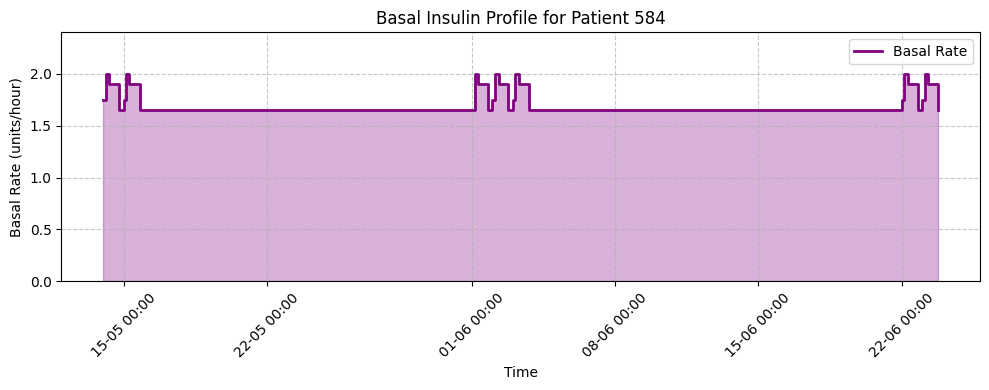

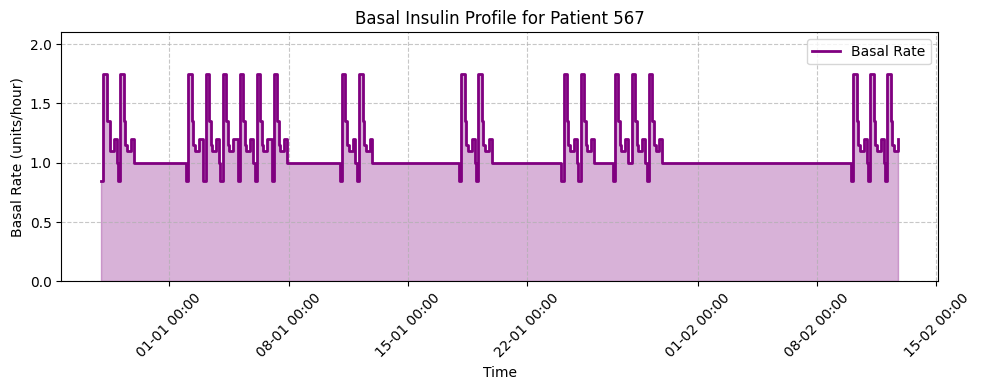

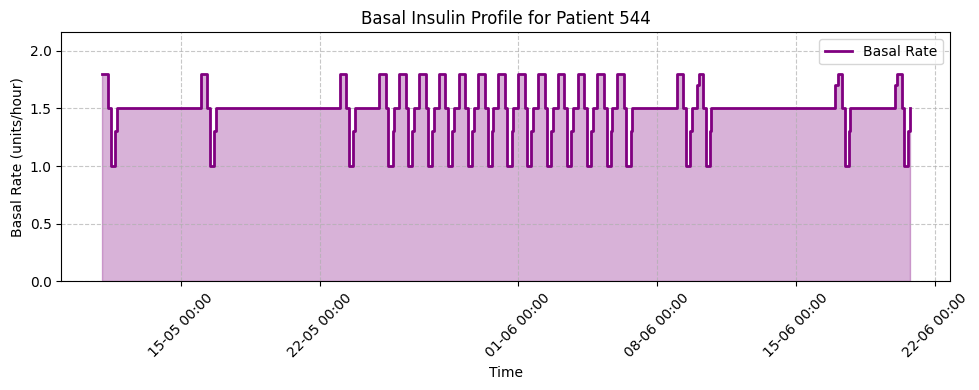

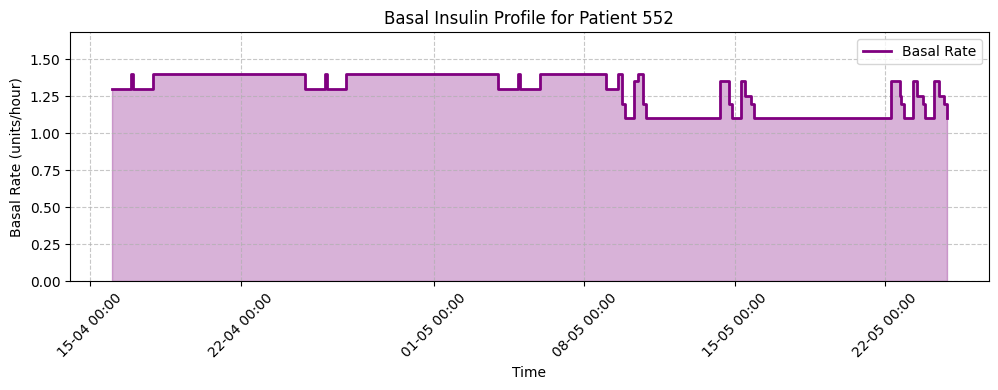

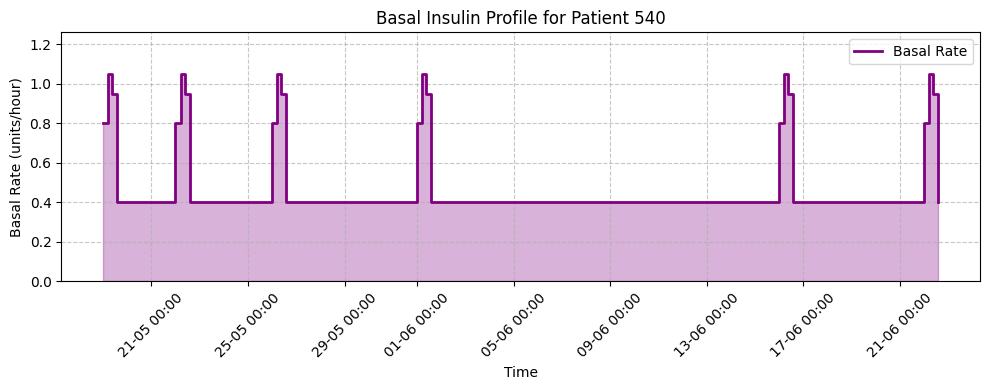

...

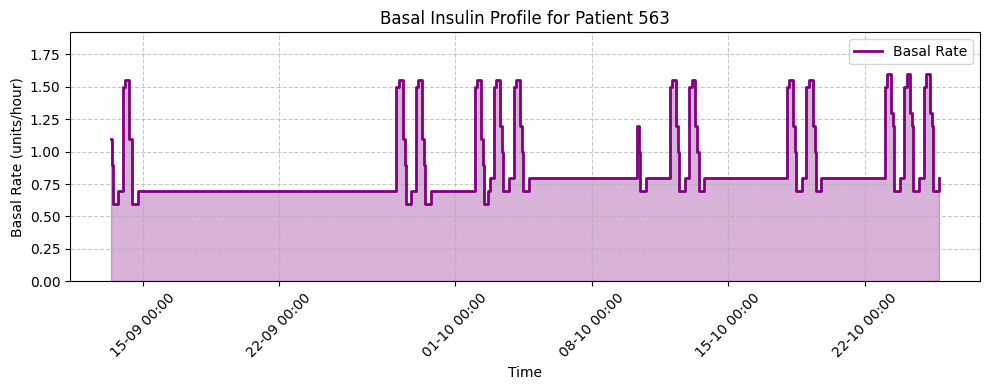

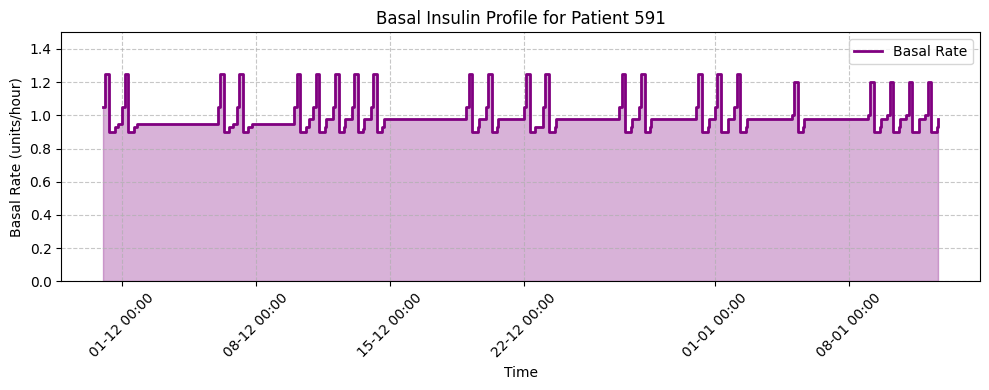

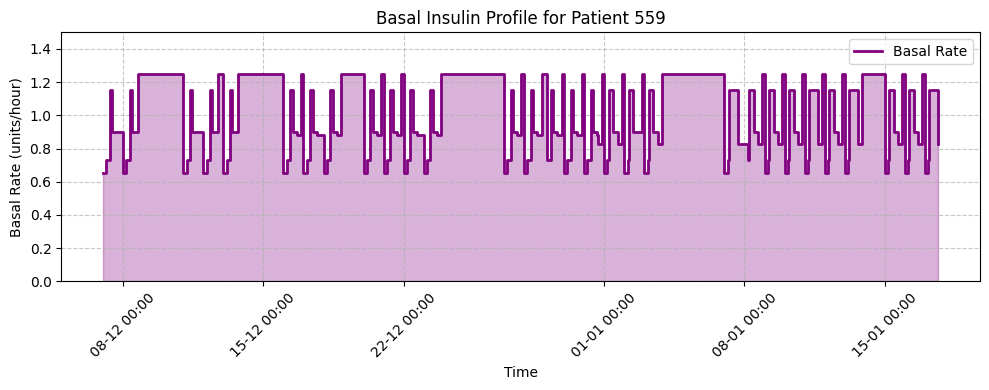

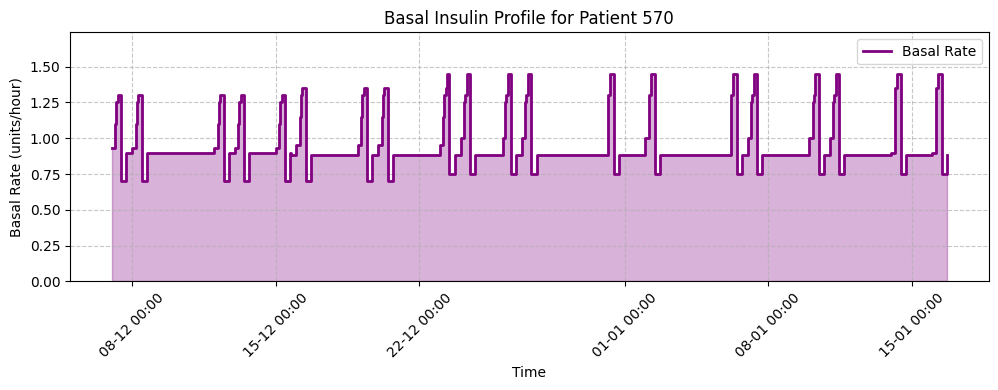

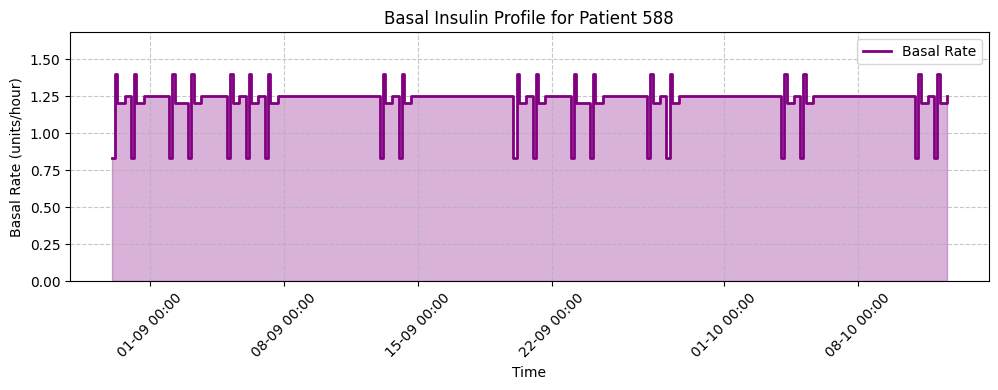

In [37]:
analyze_feature(important_features[current_index], patient_data)
current_index += 1

## Clasificación de Pacientes

In [38]:
# For all patients
for patient_id in patient_ids:
    analyze_meal_bolus_glucose_relationship(patient_id, patient_data)

In [40]:
# Classify all patients
patient_classifications = {}
for patient_id in patient_ids:
    glucose_df = patient_data[patient_id]['glucose']
    result = classify_patient_tendency(patient_id, glucose_df)
    if result:
        patient_classifications[patient_id] = result['tendency']
        
# Show summary of classifications
print("\nPatient Classifications Summary:")
for patient_id, tendency in patient_classifications.items():
    print(f"Patient {patient_id}: {tendency}")
    
# Create a pie chart to visualize the distribution of patient tendencies
tendency_counts = {
    'hyperglycemic': sum(1 for tendency in patient_classifications.values() if tendency == 'hyperglycemic'),
    'hypoglycemic': sum(1 for tendency in patient_classifications.values() if tendency == 'hypoglycemic'),
    'mixed': sum(1 for tendency in patient_classifications.values() if tendency == 'mixed')
}

# Create pie chart with Plotly
fig = go.Figure()
fig.add_trace(go.Pie(
    labels=list(tendency_counts.keys()),
    values=list(tendency_counts.values()),
    marker_colors=['orange', 'red', 'green'],  # Hyperglycemic, Hypoglycemic, Mixed
    textinfo='value+percent',
    hoverinfo='label+percent+value',
    hole=0.3  # Creates a donut chart effect
))

# Update layout
fig.update_layout(
    title='Distribution of Patient Glycemic Tendencies',
    height=500,
    width=700,
    legend_title="Tendency Types"
)

# Display the chart
fig.show()


Patient 584 Glycemic Analysis:
Average glucose: 192.5 mg/dL
Time in hypoglycemia: 0.9%
Time in normal range: 47.4%
Time in hyperglycemia: 51.7%
Hypoglycemic events: 18
Hyperglycemic events: 190
Overall tendency: hyperglycemic



Patient 567 Glycemic Analysis:
Average glucose: 153.8 mg/dL
Time in hypoglycemia: 6.4%
Time in normal range: 64.0%
Time in hyperglycemia: 29.6%
Hypoglycemic events: 38
Hyperglycemic events: 159
Overall tendency: hyperglycemic



Patient 544 Glycemic Analysis:
Average glucose: 165.2 mg/dL
Time in hypoglycemia: 1.4%
Time in normal range: 63.8%
Time in hyperglycemia: 34.8%
Hypoglycemic events: 20
Hyperglycemic events: 130
Overall tendency: hyperglycemic



Patient 552 Glycemic Analysis:
Average glucose: 146.7 mg/dL
Time in hypoglycemia: 3.4%
Time in normal range: 72.3%
Time in hyperglycemia: 24.3%
Hypoglycemic events: 39
Hyperglycemic events: 92
Overall tendency: hyperglycemic



Patient 540 Glycemic Analysis:
Average glucose: 137.1 mg/dL
Time in hypoglycemia: 6.4%
Time in normal range: 73.2%
Time in hyperglycemia: 20.5%
Hypoglycemic events: 90
Hyperglycemic events: 109
Overall tendency: hyperglycemic



Patient 596 Glycemic Analysis:
Average glucose: 147.2 mg/dL
Time in hypoglycemia: 1.9%
Time in normal range: 74.2%
Time in hyperglycemia: 23.9%
Hypoglycemic events: 46
Hyperglycemic events: 102
Overall tendency: hyperglycemic



Patient 575 Glycemic Analysis:
Average glucose: 141.8 mg/dL
Time in hypoglycemia: 8.1%
Time in normal range: 69.2%
Time in hyperglycemia: 22.7%
Hypoglycemic events: 89
Hyperglycemic events: 114
Overall tendency: hyperglycemic



Patient 563 Glycemic Analysis:
Average glucose: 146.1 mg/dL
Time in hypoglycemia: 2.3%
Time in normal range: 74.2%
Time in hyperglycemia: 23.5%
Hypoglycemic events: 41
Hyperglycemic events: 114
Overall tendency: hyperglycemic



Patient 591 Glycemic Analysis:
Average glucose: 156.0 mg/dL
Time in hypoglycemia: 3.7%
Time in normal range: 64.2%
Time in hyperglycemia: 32.1%
Hypoglycemic events: 62
Hyperglycemic events: 123
Overall tendency: hyperglycemic



Patient 559 Glycemic Analysis:
Average glucose: 166.7 mg/dL
Time in hypoglycemia: 3.8%
Time in normal range: 56.2%
Time in hyperglycemia: 40.0%
Hypoglycemic events: 59
Hyperglycemic events: 124
Overall tendency: hyperglycemic



Patient 570 Glycemic Analysis:
Average glucose: 187.5 mg/dL
Time in hypoglycemia: 1.8%
Time in normal range: 43.2%
Time in hyperglycemia: 55.1%
Hypoglycemic events: 29
Hyperglycemic events: 95
Overall tendency: hyperglycemic



Patient 588 Glycemic Analysis:
Average glucose: 165.0 mg/dL
Time in hypoglycemia: 0.9%
Time in normal range: 63.7%
Time in hyperglycemia: 35.4%
Hypoglycemic events: 25
Hyperglycemic events: 162
Overall tendency: hyperglycemic



Patient Classifications Summary:
Patient 584: hyperglycemic
Patient 567: hyperglycemic
Patient 544: hyperglycemic
Patient 552: hyperglycemic
Patient 540: hyperglycemic
Patient 596: hyperglycemic
Patient 575: hyperglycemic
Patient 563: hyperglycemic
Patient 591: hyperglycemic
Patient 559: hyperglycemic
Patient 570: hyperglycemic
Patient 588: hyperglycemic


# Test & Validation

In [41]:
# Load test data
test_patient_data = {}

# Define test data paths
test_path1 = os.path.join(PROJECT_DIR, "data", "OhioT1DM", "2020", "test")
test_path2 = os.path.join(PROJECT_DIR, "data", "OhioT1DM", "2018", "test")

# Process 2020 test data
for xml_file in glob.glob(os.path.join(test_path1, "*.xml")):
    data = parse_patient_xml(xml_file)
    test_patient_data[data['patient_info']['id']] = data
    
# Process 2018 test data
for xml_file in glob.glob(os.path.join(test_path2, "*.xml")):
    data = parse_patient_xml(xml_file)
    test_patient_data[data['patient_info']['id']] = data

print(f"Loaded test data for {len(test_patient_data)} patients")
test_patient_ids = list(test_patient_data.keys())
print(f"Test Patient IDs: {test_patient_ids}")

Loaded test data for 12 patients
Test Patient IDs: ['544', '552', '584', '540', '567', '596', '570', '559', '563', '575', '591', '588']


In [42]:
# Classify test patients
test_patient_classifications = {}
for patient_id in test_patient_ids:
    glucose_df = test_patient_data[patient_id]['glucose']
    result = classify_patient_tendency(patient_id, glucose_df)
    if result:
        test_patient_classifications[patient_id] = result['tendency']

# Show test classification summary
print("\nTest Patient Classifications Summary:")
for patient_id, tendency in test_patient_classifications.items():
    print(f"Patient {patient_id}: {tendency}")

# Create a pie chart for test data classifications
test_tendency_counts = {
    'hyperglycemic': sum(1 for tendency in test_patient_classifications.values() if tendency == 'hyperglycemic'),
    'hypoglycemic': sum(1 for tendency in test_patient_classifications.values() if tendency == 'hypoglycemic'),
    'mixed': sum(1 for tendency in test_patient_classifications.values() if tendency == 'mixed')
}

test_fig = go.Figure()
test_fig.add_trace(go.Pie(
    labels=list(test_tendency_counts.keys()),
    values=list(test_tendency_counts.values()),
    marker_colors=['orange', 'red', 'green'],  # Hyperglycemic, Hypoglycemic, Mixed
    textinfo='value+percent',
    hoverinfo='label+percent+value',
    hole=0.3
))

test_fig.update_layout(
    title='Distribution of Test Patient Glycemic Tendencies',
    height=500,
    width=700,
    legend_title="Tendency Types"
)

test_fig.show()


Patient 544 Glycemic Analysis:
Average glucose: 156.5 mg/dL
Time in hypoglycemia: 1.0%
Time in normal range: 68.4%
Time in hyperglycemia: 30.5%
Hypoglycemic events: 5
Hyperglycemic events: 28
Overall tendency: hyperglycemic



Patient 552 Glycemic Analysis:
Average glucose: 140.8 mg/dL
Time in hypoglycemia: 2.7%
Time in normal range: 78.3%
Time in hyperglycemia: 19.0%
Hypoglycemic events: 8
Hyperglycemic events: 17
Overall tendency: hyperglycemic



Patient 584 Glycemic Analysis:
Average glucose: 170.3 mg/dL
Time in hypoglycemia: 1.0%
Time in normal range: 62.0%
Time in hyperglycemia: 37.1%
Hypoglycemic events: 8
Hyperglycemic events: 38
Overall tendency: hyperglycemic



Patient 540 Glycemic Analysis:
Average glucose: 158.9 mg/dL
Time in hypoglycemia: 4.7%
Time in normal range: 62.0%
Time in hyperglycemia: 33.4%
Hypoglycemic events: 14
Hyperglycemic events: 30
Overall tendency: hyperglycemic



Patient 567 Glycemic Analysis:
Average glucose: 146.3 mg/dL
Time in hypoglycemia: 7.9%
Time in normal range: 67.8%
Time in hyperglycemia: 24.3%
Hypoglycemic events: 9
Hyperglycemic events: 34
Overall tendency: hyperglycemic



Patient 596 Glycemic Analysis:
Average glucose: 147.9 mg/dL
Time in hypoglycemia: 2.4%
Time in normal range: 74.7%
Time in hyperglycemia: 22.9%
Hypoglycemic events: 9
Hyperglycemic events: 23
Overall tendency: hyperglycemic



Patient 570 Glycemic Analysis:
Average glucose: 214.8 mg/dL
Time in hypoglycemia: 0.3%
Time in normal range: 29.8%
Time in hyperglycemia: 69.8%
Hypoglycemic events: 2
Hyperglycemic events: 20
Overall tendency: hyperglycemic



Patient 559 Glycemic Analysis:
Average glucose: 169.5 mg/dL
Time in hypoglycemia: 2.9%
Time in normal range: 58.8%
Time in hyperglycemia: 38.4%
Hypoglycemic events: 4
Hyperglycemic events: 28
Overall tendency: hyperglycemic



Patient 563 Glycemic Analysis:
Average glucose: 167.4 mg/dL
Time in hypoglycemia: 0.5%
Time in normal range: 60.6%
Time in hyperglycemia: 38.8%
Hypoglycemic events: 3
Hyperglycemic events: 38
Overall tendency: hyperglycemic



Patient 575 Glycemic Analysis:
Average glucose: 150.5 mg/dL
Time in hypoglycemia: 5.2%
Time in normal range: 63.7%
Time in hyperglycemia: 31.1%
Hypoglycemic events: 9
Hyperglycemic events: 30
Overall tendency: hyperglycemic



Patient 591 Glycemic Analysis:
Average glucose: 144.8 mg/dL
Time in hypoglycemia: 4.9%
Time in normal range: 67.6%
Time in hyperglycemia: 27.5%
Hypoglycemic events: 18
Hyperglycemic events: 34
Overall tendency: hyperglycemic



Patient 588 Glycemic Analysis:
Average glucose: 175.1 mg/dL
Time in hypoglycemia: 0.1%
Time in normal range: 54.4%
Time in hyperglycemia: 45.5%
Hypoglycemic events: 1
Hyperglycemic events: 47
Overall tendency: hyperglycemic



Test Patient Classifications Summary:
Patient 544: hyperglycemic
Patient 552: hyperglycemic
Patient 584: hyperglycemic
Patient 540: hyperglycemic
Patient 567: hyperglycemic
Patient 596: hyperglycemic
Patient 570: hyperglycemic
Patient 559: hyperglycemic
Patient 563: hyperglycemic
Patient 575: hyperglycemic
Patient 591: hyperglycemic
Patient 588: hyperglycemic


In [43]:
# Choose a patient and feature (e.g., basal insulin)
for feature_name in ['basal', 'meal', 'bolus']:
    for patient_id in test_patient_ids:
        if patient_id in patient_data:
            train_feature = patient_data[patient_id][feature_name]
            test_feature = test_patient_data[patient_id][feature_name]
            
            print(f"\nComparing {feature_name} data for patient {patient_id}:")
            print(f"  Train records: {len(train_feature)}")
            print(f"  Test records: {len(test_feature)}")
            
            # If numeric data is available, compare statistics
            if 'value' in train_feature.columns and 'value' in test_feature.columns:
                train_avg = train_feature['value'].mean()
                test_avg = test_feature['value'].mean()
                print(f"  Train average value: {train_avg:.2f}")
                print(f"  Test average value: {test_avg:.2f}")


Comparing basal data for patient 544:
  Train records: 103
  Test records: 32
  Train average value: 1.43
  Test average value: 1.46

Comparing basal data for patient 552:
  Train records: 45
  Test records: 18
  Train average value: 1.25
  Test average value: 1.19

Comparing basal data for patient 584:
  Train records: 27
  Test records: 20
  Train average value: 1.83
  Test average value: 1.82

Comparing basal data for patient 540:
  Train records: 24
  Test records: 8
  Train average value: 0.80
  Test average value: 0.80

Comparing basal data for patient 567:
  Train records: 135
  Test records: 14
  Train average value: 1.21
  Test average value: 1.20

Comparing basal data for patient 596:
  Train records: 23
  Test records: 31
  Train average value: 0.49
  Test average value: 0.49

Comparing basal data for patient 570:
  Train records: 118
  Test records: 29
  Train average value: 1.08
  Test average value: 1.11

Comparing basal data for patient 559:
  Train records: 163
  Test 

In [44]:
def analyze_time_continuity(train_data, test_data, patient_id):
    """Analyze if test data is a time continuation of train data."""
    train_glucose = train_data[patient_id]['glucose']
    test_glucose = test_data[patient_id]['glucose']
    
    train_start = train_glucose['timestamp'].min()
    train_end = train_glucose['timestamp'].max()
    test_start = test_glucose['timestamp'].min()
    test_end = test_glucose['timestamp'].max()
    
    print(f"\nTime Continuity Analysis for Patient {patient_id}:")
    print(f"  Train data range: {train_start} to {train_end}")
    print(f"  Test data range: {test_start} to {test_end}")
    
    # Check if test data continues after train data
    if test_start > train_end:
        gap = (test_start - train_end).total_seconds() / 3600  # gap in hours
        print(f"  Test data continues after train data with a gap of {gap:.1f} hours")
    elif test_end < train_start:
        gap = (train_start - test_end).total_seconds() / 3600
        print(f"  Test data precedes train data with a gap of {gap:.1f} hours")
    else:
        overlap = min(train_end, test_end) - max(train_start, test_start)
        overlap_hours = overlap.total_seconds() / 3600
        print(f"  Train and test data overlap by {overlap_hours:.1f} hours")

for patient_id in test_patient_ids:
    if patient_id in patient_data:
        analyze_time_continuity(patient_data, test_patient_data, patient_id)


Time Continuity Analysis for Patient 544:
  Train data range: 2027-05-11 00:02:00 to 2027-06-23 23:55:00
  Test data range: 2027-06-24 00:00:00 to 2027-07-04 21:17:00
  Test data continues after train data with a gap of 0.1 hours

Time Continuity Analysis for Patient 552:
  Train data range: 2025-04-16 11:17:05 to 2025-05-24 23:59:14
  Test data range: 2025-05-25 00:04:14 to 2025-06-07 17:09:51
  Test data continues after train data with a gap of 0.1 hours

Time Continuity Analysis for Patient 584:
  Train data range: 2025-05-14 00:03:00 to 2025-06-28 23:56:00
  Test data range: 2025-06-29 00:01:00 to 2025-07-09 09:32:00
  Test data continues after train data with a gap of 0.1 hours

Time Continuity Analysis for Patient 540:
  Train data range: 2027-05-19 11:36:29 to 2027-07-03 23:56:44
  Test data range: 2027-07-04 00:01:44 to 2027-07-14 15:25:40
  Test data continues after train data with a gap of 0.1 hours

Time Continuity Analysis for Patient 567:
  Train data range: 2026-12-28 00